In [1]:
import numpy as np
import os
import sys
import astropy as ast
from astropy.io import ascii
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import pandas as pd
import scipy as sp
from astropy.timeseries import LombScargle
from astropy import units as u

In [2]:
from view_and_clean import get_telescope, find_header_line, modified_zscore, df_extract, individual_plotter, grid_plotter
from metrics import mean_med_flux, fit_plotter_flux, curve_fitter_flux,\
    largest_amplitude, offset_warning, chi, percentile_amplitude, plot_percentile_amplitude, aliasing,\
        compute_lomb_scargle, plot_periodogram, plot_phase_fold, amplitude_per_period, amplitude_per_period_plot, compute_lomb_scargle_old

### Extracting data from files and plotting:

In [3]:
# coords = pd.read_csv('ysg_coords_with_lcs.dat', comment='#', sep="\\s+", names=['RA', 'DEC'])
# coords = pd.read_csv('/Users/shannonbowes/Research/ysg/candidates_and_lcs/final_smc_ysgcands.csv', comment='#', sep="\\s+", names=['ra', 'dec'])
coords = pd.read_csv('merged_smc_lmc_coords.csv', comment='#', sep="\\s+", names=['ra', 'dec'])

In [4]:
target = 769 # regular
target = 65
target = 174
target = 760
# target = 669 # irregular 729

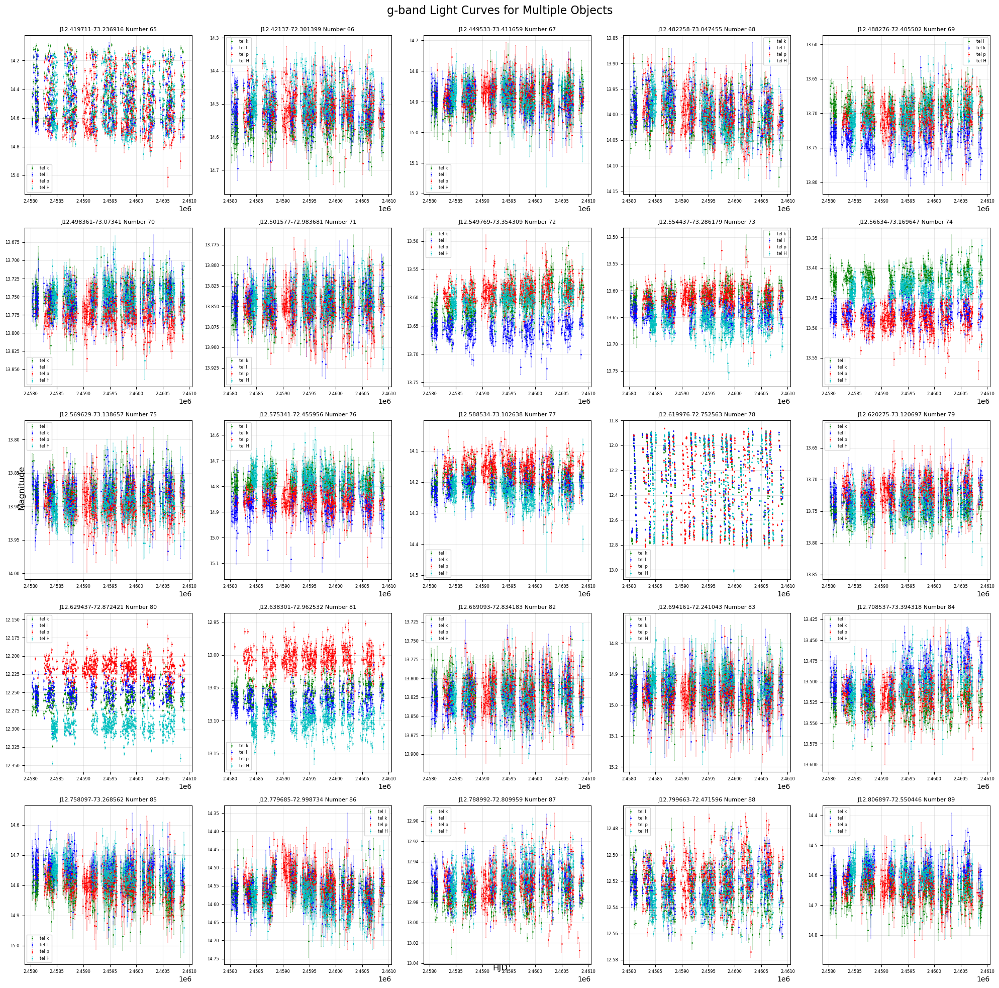

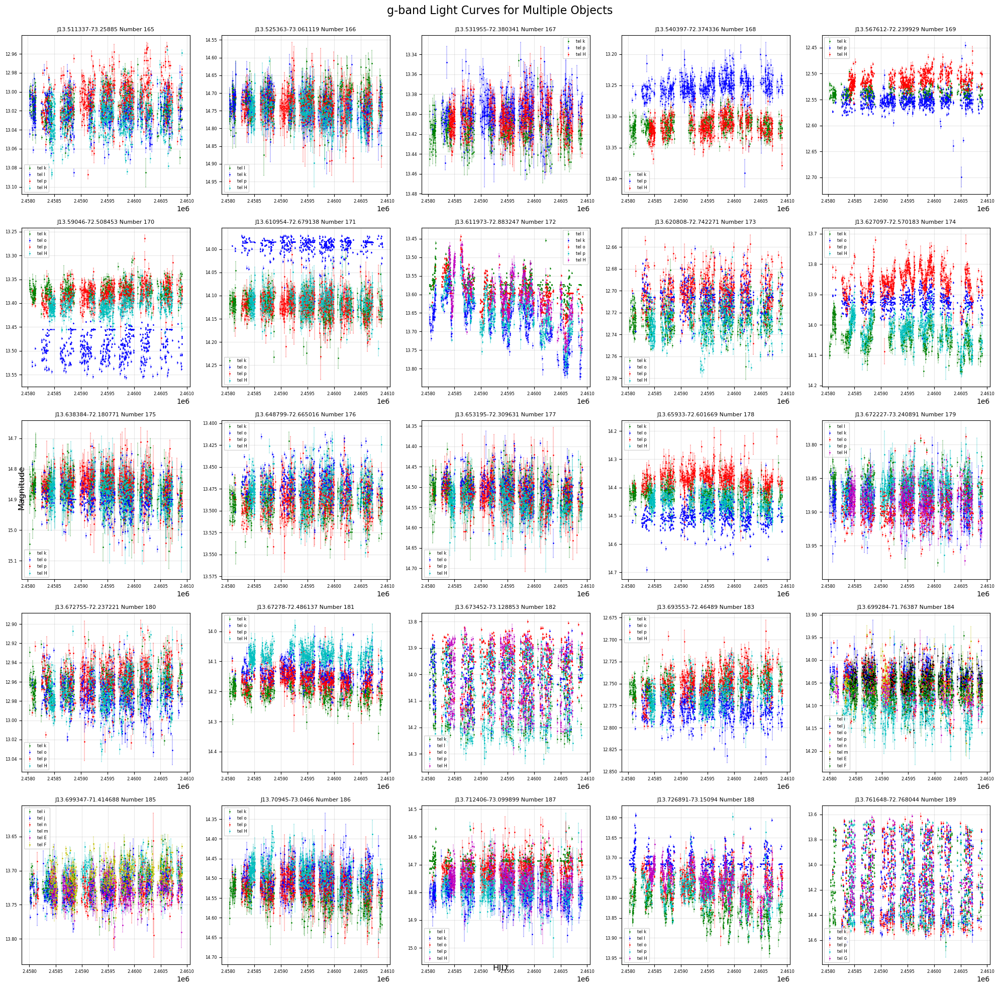

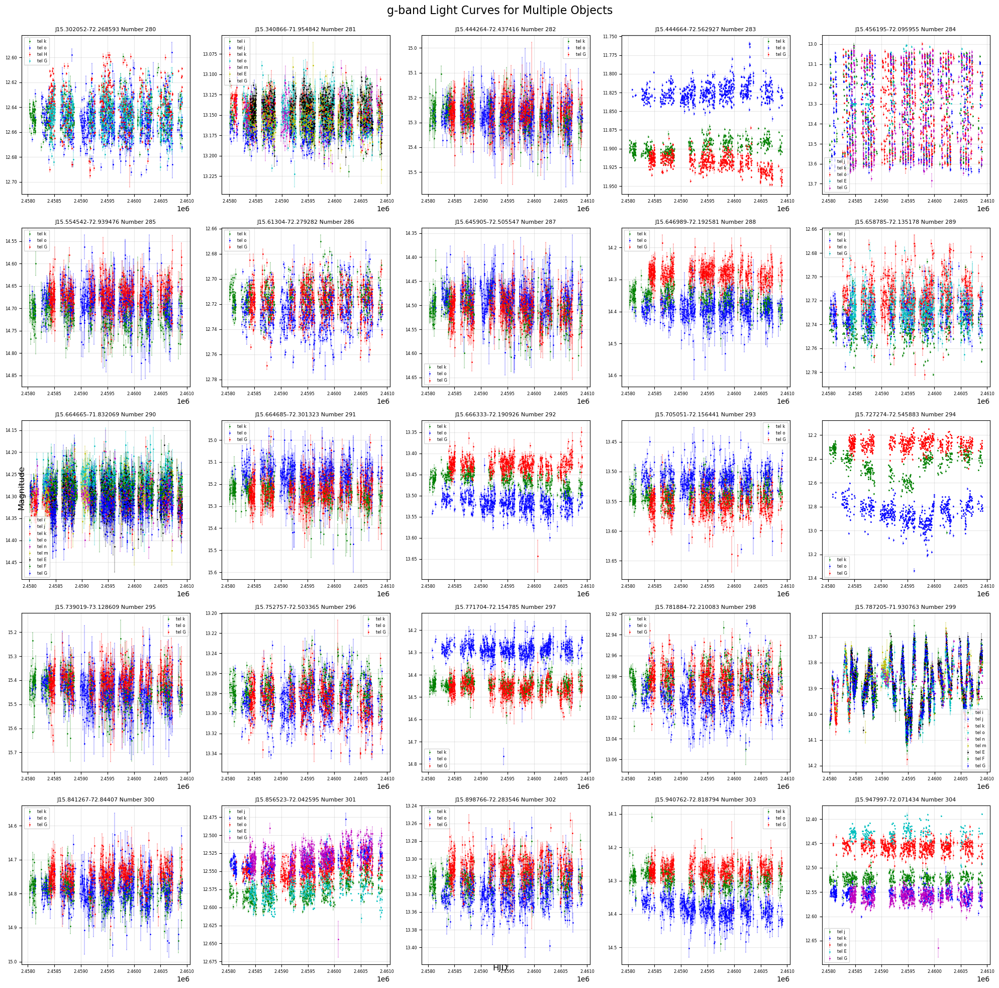

In [5]:
grid_plotter(65, g=True, newfiles=True)
grid_plotter(165, g=True, newfiles=True)
grid_plotter(280, g=True, newfiles=True)

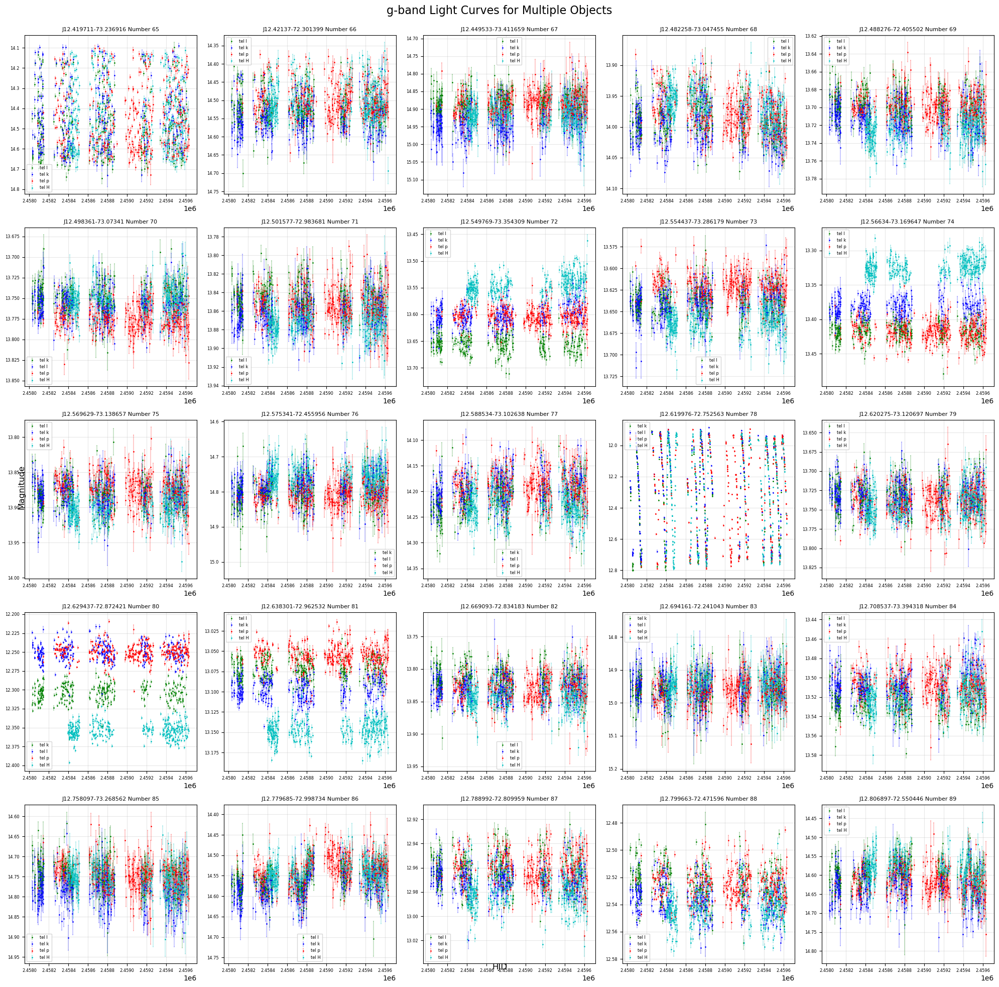

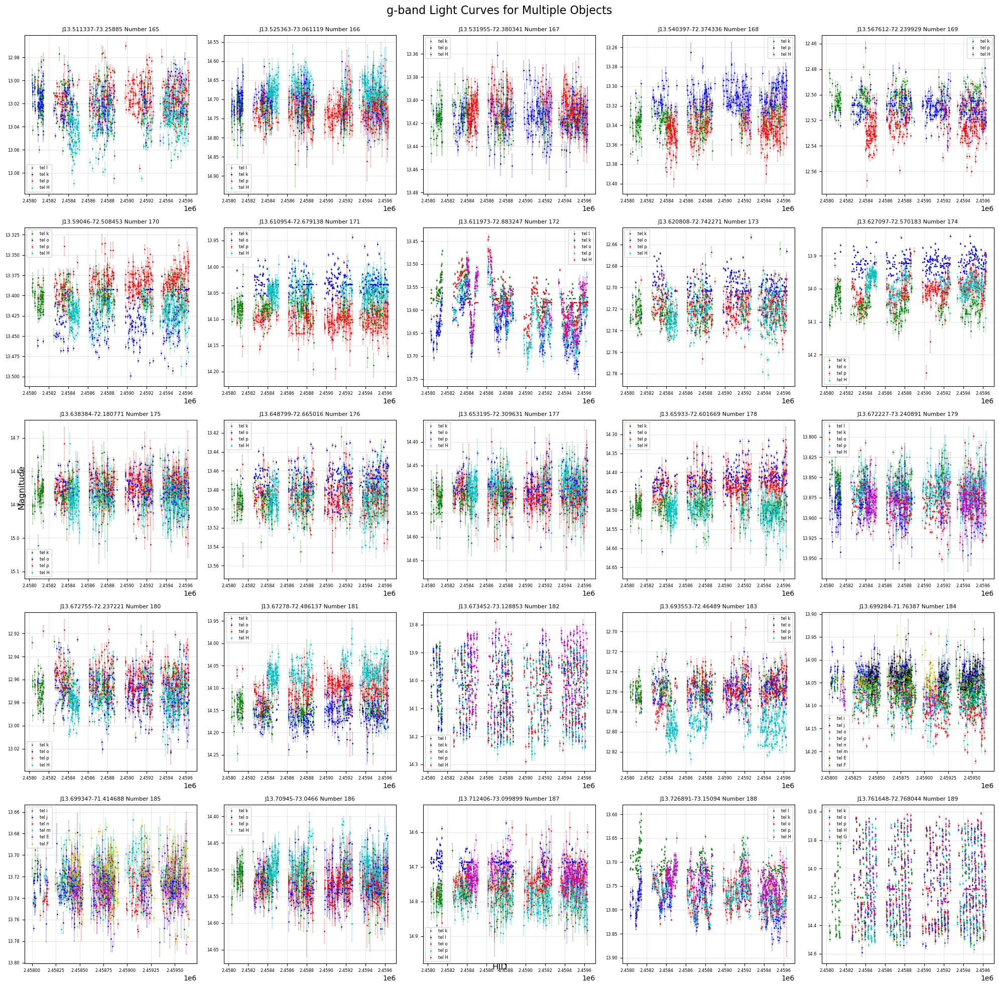

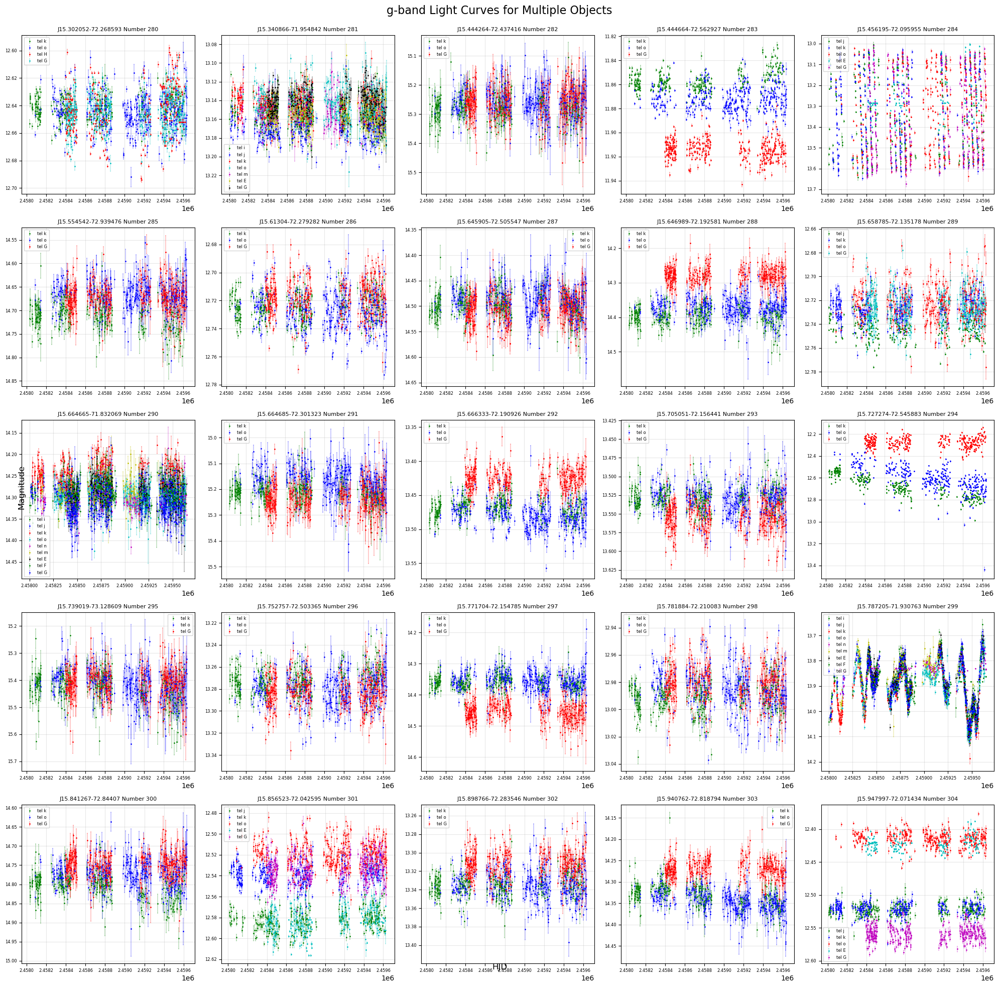

In [6]:
grid_plotter(65, g=True, newfiles=False)
grid_plotter(165, g=True, newfiles=False)
grid_plotter(280, g=True, newfiles=False)

In [11]:
gaia = pd.read_csv('gaia_names')
gaia_names = gaia['DR3Name'].to_list()
print(gaia_names)
gaia_numbers = [int(name.replace('Gaia DR3 ', '')) for name in gaia_names]
print(gaia_numbers)

['Gaia DR3 4688433892854787328', 'Gaia DR3 4688451862997785728', 'Gaia DR3 4688458185189527040', 'Gaia DR3 4688456810800008832', 'Gaia DR3 4688456913879215488', 'Gaia DR3 4688456913879217024', 'Gaia DR3 4688810475608636800', 'Gaia DR3 4688816454219374336', 'Gaia DR3 4685807022156620416', 'Gaia DR3 4688818374028029440', 'Gaia DR3 4685737718559361408', 'Gaia DR3 4685810251971898752', 'Gaia DR3 4685792758613380352', 'Gaia DR3 4685716999636981376', 'Gaia DR3 4685816952120571904', 'Gaia DR3 4688897611907475840', 'Gaia DR3 4688822260999299840', 'Gaia DR3 4689217466690224384', 'Gaia DR3 4688941180059446016', 'Gaia DR3 4685824236387275776', 'Gaia DR3 4685771734702774144', 'Gaia DR3 4685844920952320896', 'Gaia DR3 4685827328763438336', 'Gaia DR3 4688848576277104768', 'Gaia DR3 4685823721000358144', 'Gaia DR3 4688873693215503488', 'Gaia DR3 4688855413867283968', 'Gaia DR3 4688878645341405952', 'Gaia DR3 4685852480096538880', 'Gaia DR3 4688874865770263936', 'Gaia DR3 4685848386974016128', 'Gaia D

In [7]:
data = df_extract(target, seeoutliers=True, g=True)

Object 760 is likely variable (chi-squared = 242519.88, threshold = 3133.64); less than 5.00 % chance of non-variability.
Object 760 is likely variable (chi-squared = 242519.88, threshold = 3222.39); less than 0.30 % chance of non-variability.
Offsets for object 760 (g-band: True):
RA: 84.783639, DEC: -70.337944


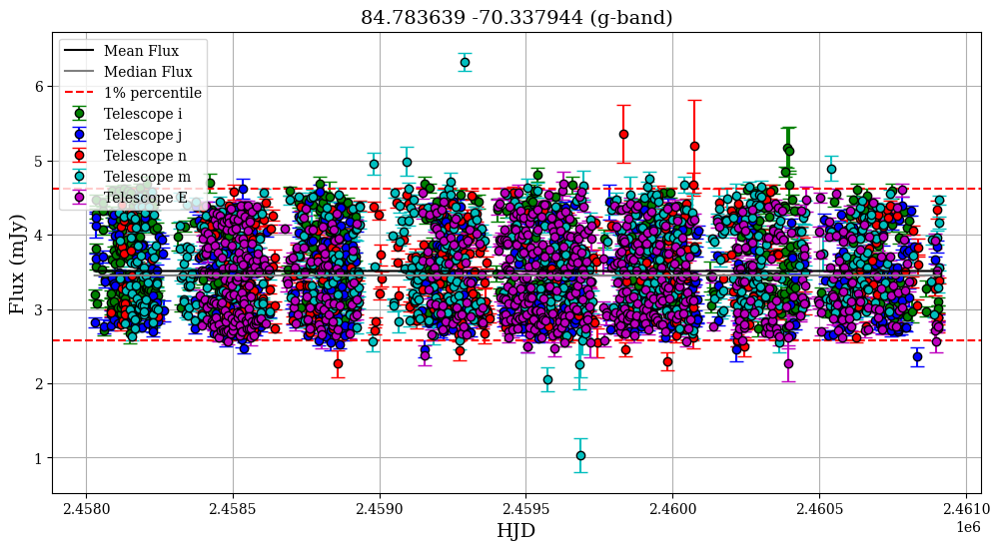

In [8]:
chi(target)
chi(target, confidence=0.997)
# curve_fitter_flux(target)
offset_warning(target)
fit_plotter_flux(target)

Largest amplitude of variability (g-band: True): 5.29 mJy
Lower 5% percentile: 2.73 mJy
Upper 5% percentile: 4.42 mJy
Percentile amplitude of variability (g-band: True): 1.68 mJy
Lower 10% percentile: 2.83 mJy
Upper 10% percentile: 4.30 mJy
Percentile amplitude of variability (g-band: True): 1.47 mJy


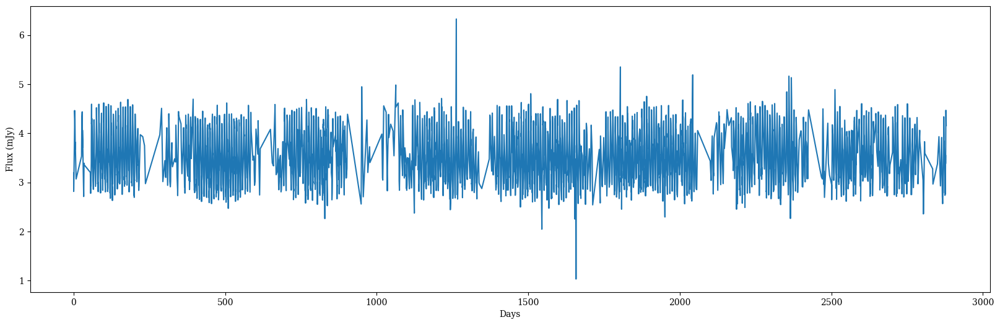

In [9]:
largest_amplitude(target)
percentile_amplitude(target, tails=5)
percentile_amplitude(target, tails=10)

df, telescopes = df_extract(target, g=True)
days_since_start = df['HJD'] - df['HJD'].min()
plt.figure(figsize=(20, 6))
plt.xlabel('Days')
plt.ylabel('Flux (mJy)')
plt.plot(days_since_start, df['flux_(mJy)'], '-')

In [16]:
df07 = pd.read_csv('summary_results11.csv')
df10 = pd.read_csv('summary_results10.csv')

# comparing summary_results07 to summary_results10
for target in range(0,848):
    print("Target: ", target)
    # Compare the two DataFrames
    if df07.iloc[target]['best_period'] != df10.iloc[target]['best_period']:
        print(f"DataFrames differ at index {target}")
        print("summary_results07:")
        print(df07.iloc[target])
        print("summary_results11:")
        print(df10.iloc[target])

Target:  0
Target:  1
Target:  2
Target:  3
Target:  4
Target:  5
Target:  6
Target:  7
Target:  8
Target:  9
Target:  10
Target:  11
Target:  12
Target:  13
Target:  14
Target:  15
Target:  16
Target:  17
Target:  18
Target:  19
Target:  20
Target:  21
Target:  22
Target:  23
Target:  24
Target:  25
Target:  26
Target:  27
Target:  28
Target:  29
Target:  30
Target:  31
Target:  32
Target:  33
Target:  34
Target:  35
Target:  36
Target:  37
Target:  38
Target:  39
Target:  40
Target:  41
Target:  42
Target:  43
Target:  44
Target:  45
Target:  46
Target:  47
Target:  48
Target:  49
Target:  50
Target:  51
Target:  52
Target:  53
Target:  54
Target:  55
Target:  56
Target:  57
Target:  58
Target:  59
Target:  60
Target:  61
Target:  62
Target:  63
Target:  64
Target:  65
Target:  66
Target:  67
Target:  68
Target:  69
Target:  70
Target:  71
Target:  72
Target:  73
Target:  74
Target:  75
Target:  76
Target:  77
Target:  78
Target:  79
Target:  80
Target:  81
Target:  82
Target:  83
Ta

In [1]:
# fig for proposal

fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes_flat = axes.flatten()
    # Colors for different telescopes
colors = ['g', 'b', 'r', 'c', 'm', 'y', 'k']

plotnumber = 0
for i in [792, 507, 25]: #114, 789, 792, 25, 803
    ax = axes_flat[plotnumber]

    try:
        # Get coordinates for this object
        RA = coords['RA'][i]
        dec = coords['DEC'][i]
        
        df, telescopes = df_extract(i, g=True)
        
        # Plot data for each telescope
        for j, tel in enumerate(telescopes):
            mask = df['telescope'] == tel
            ax.errorbar(df[mask]['HJD'], df[mask]['mag'], yerr=df[mask]['mag_err'], fmt='.', color=colors[j % len(colors)],
                    label=f'Telescope {tel}', capsize=1, markersize=2, elinewidth=0.3, capthick=0.3)
            # ax.set_ylim(ax.get_ylim()[::-1])  # Keep y-axis inverted, but you can set specific limits like:
            # ax.set_ylim(15.0, 12.86)  # Example: set y-axis from 16 (faint) to 12 (bright)
            
        
        ax.invert_yaxis()
        ax.grid(True, alpha=0.3)
        if RA < 10:
            ax.set_title(f'J0{RA}{dec}', fontsize=14)
        if RA >= 10:
            ax.set_title(f'J{RA}{dec}', fontsize=14)
        if len(telescopes) > 1:
            ax.legend(loc = 'lower left', fontsize=8)
        ax.tick_params(axis='both', labelsize=14)
        
    except Exception as e:
        # If there's an error reading/plotting a file, show empty plot with error message
        ax.text(0.5, 0.5, f'Error: {str(e)}', 
                ha='center', va='center', transform=ax.transAxes, 
                fontsize=6, color='red')
        ax.set_title(f'J0{RA}{dec}', fontsize=14) #" Number " + str(i)
    plotnumber += 1
fig.text(0.5, 0.0, 'HJD [days]', ha='center', fontsize=16)
fig.text(-0.007, 0.5, 'Magnitude', va='center', rotation='vertical', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(top=0.95) 
# plt.savefig('figs/3_lcs.png', bbox_inches='tight', dpi=300)
plt.show()

NameError: name 'plt' is not defined

# Power Spectra analysis

In [16]:
# data = df_extract(target, seeoutliers=True, g=True)[0]
# for i in range(len(data['flux_(mJy)'])):
#     val = data['flux_err'].iloc[i]
#     if val==0 or np.isnan(val) or np.isinf(val) or val < 0.001:
#         print(f"Zero or NaN or Inf found at index {i} in flux data for target {target}, {val}")
# lombs = compute_lomb_scargle(target, samples_per_peak=5) #freq_range=(0.0, 0.05),

In [18]:
stats = pd.read_csv('summary_results07.csv')
print(stats.iloc[760])

RA                        84.783639
DEC                      -70.337944
overall_mean               3.522839
overall_median             3.468000
overall_mean_mag          15.046662
overall_median_mag        15.050000
offset_flag                0.000000
chi_squared_68        172909.893320
chi2_threshold_68       2059.274558
chi_flag_68                0.000000
chi_squared_95        172909.893320
chi2_threshold_95       2135.931648
chi_flag_95                0.000000
chi_squared_997       172909.893320
chi2_threshold_997      2209.452498
chi_flag_997               0.000000
amplitude_5                1.684000
lower_percentile_5         2.749000
upper_percentile_5         4.433000
mag_amplitude_5            0.519000
amplitude_1                1.982800
lower_percentile_1         2.622900
upper_percentile_1         4.605700
mag_amplitude_1            0.610700
largest_amp                2.938000
best_period                7.961527
alarm_level_flag           0.000000
std_amplitude              0

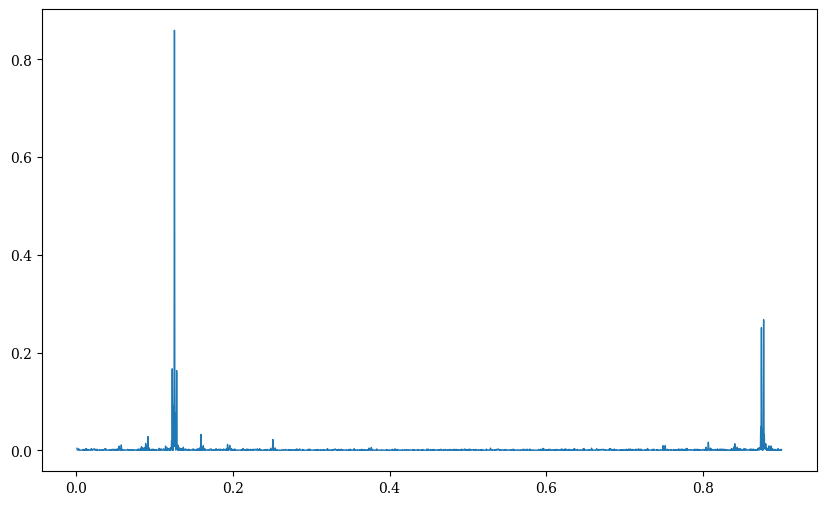

Best frequency: 0.125604 1/day, Best period: 7.96 days, Max power: 0.859, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.423e-02
Grid sampled at 18254 points


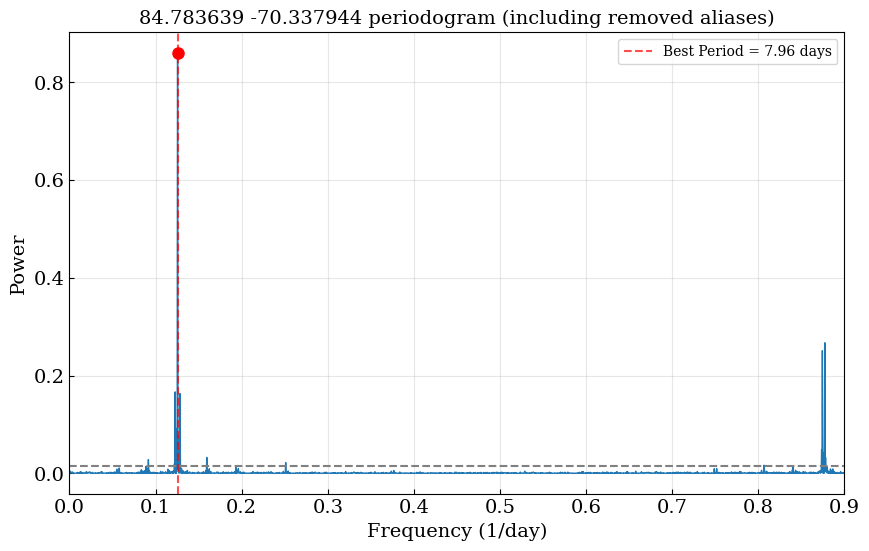

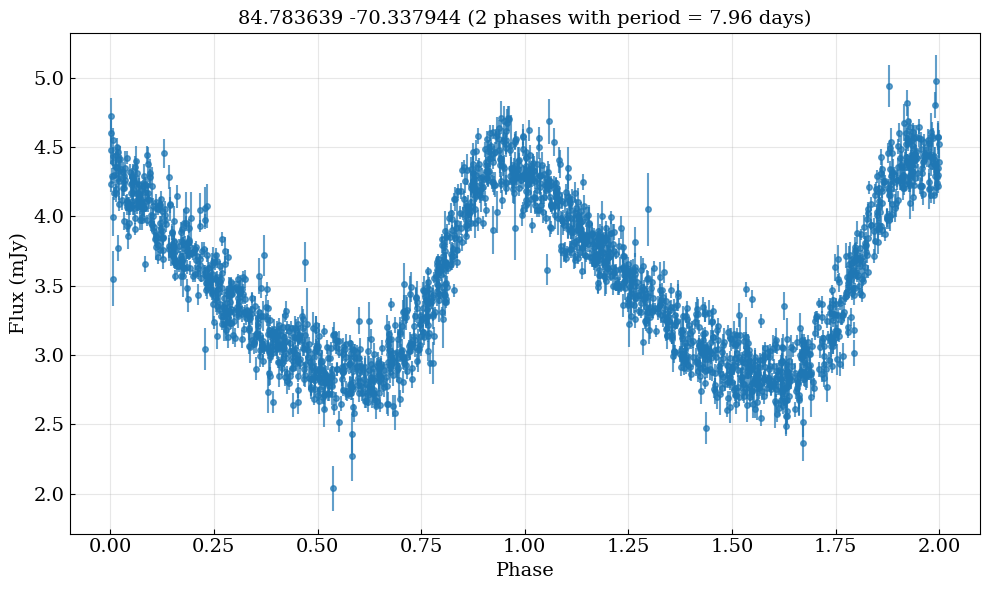

Average scatter (amplitude) per 10 point phase bin: 0.487 mJy


np.float64(0.4867549019607843)

In [15]:
lombs = compute_lomb_scargle_old(target, auto=False, samples_per_peak=10)
plot_periodogram(target, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], lombs['peaks'], lombs['observation_period'], show_best=True)
plot_phase_fold(target, lombs['best_period'],phase_bins=2)

# looking at new lightcurves

In [ ]:
# compute_lomb_scargle_old(target, auto=False, samples_per_peak=10)

FAL: 0.02822798, Alias FAL: 0.02822798
Alias false alarm probability: 1.077e-07
Best frequency: 0.003325 1/day, Best period: 300.73 days, Max power: 0.052, False alarm probability: 1.077e-07
False alarm level for 1.0%: 2.823e-02


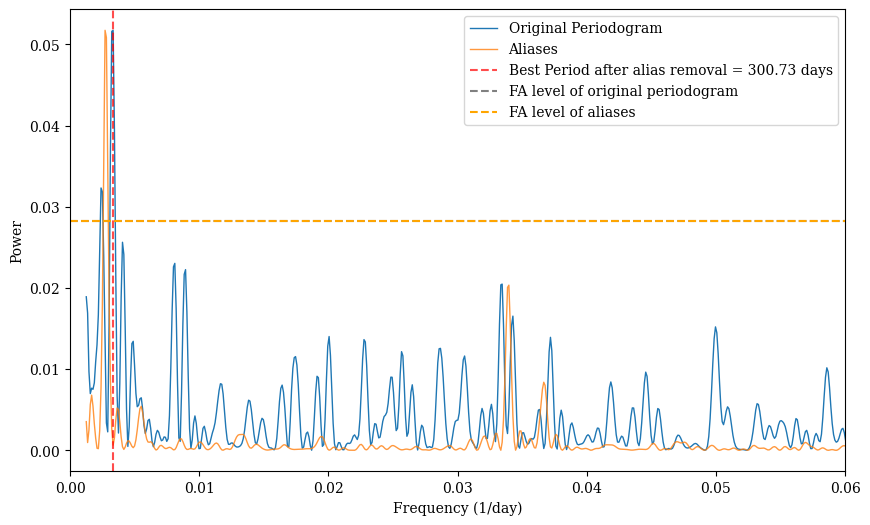

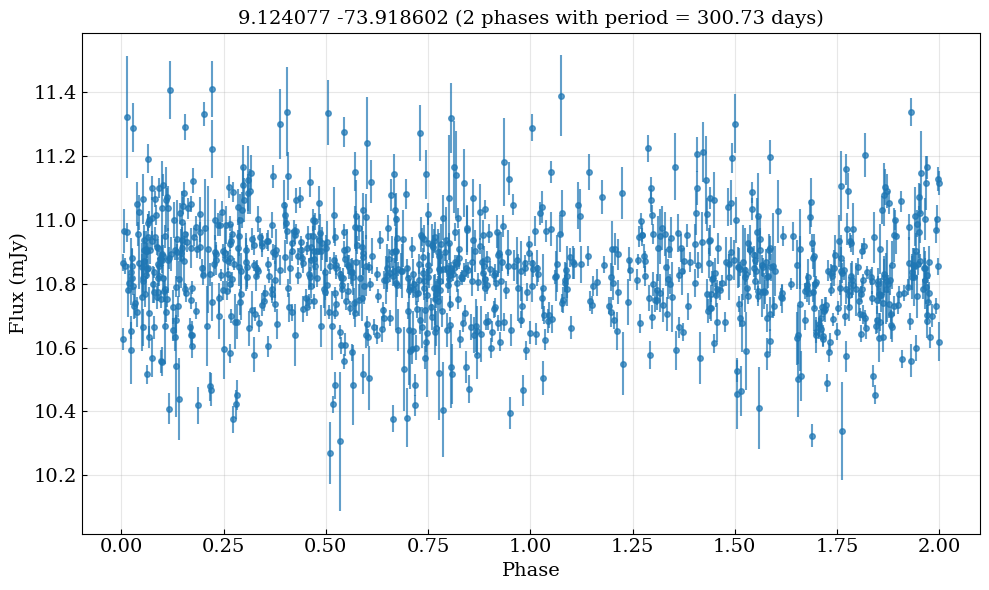

Average scatter (amplitude) per 10 point phase bin: 0.501 mJy
FAL: 0.02833454, Alias FAL: 0.02833454
Alias false alarm probability: 9.766e-06
Best frequency: 0.003438 1/day, Best period: 290.87 days, Max power: 0.043, False alarm probability: 9.766e-06
False alarm level for 1.0%: 2.833e-02


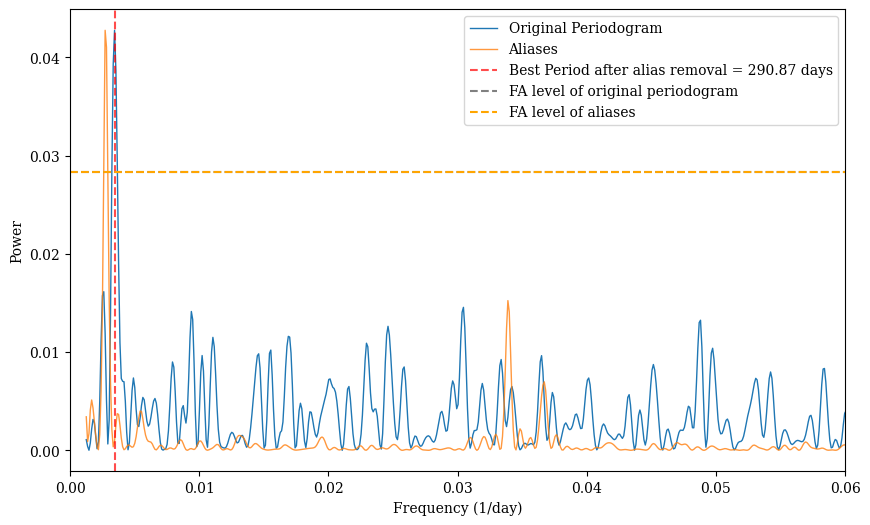

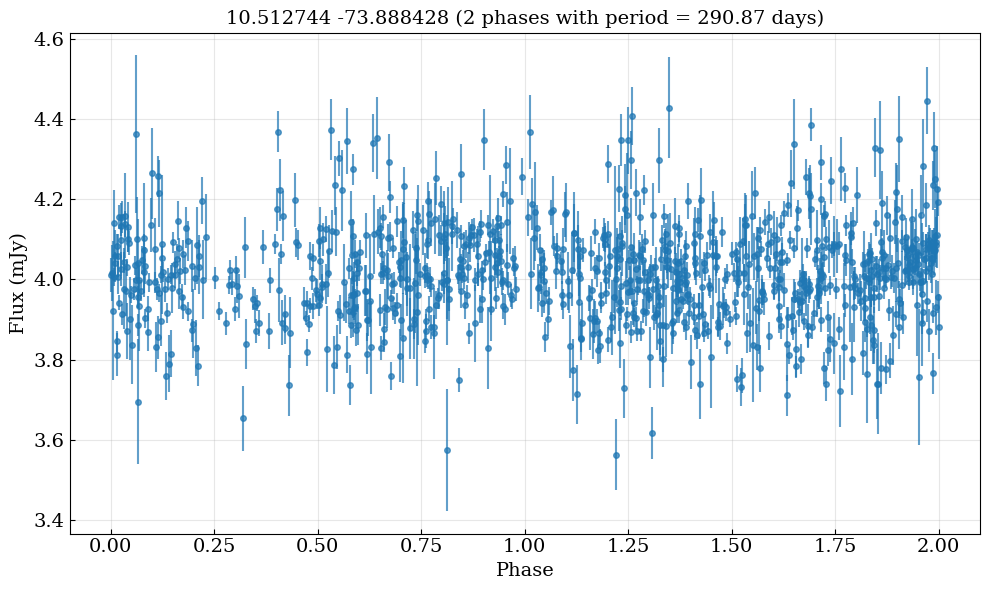

Average scatter (amplitude) per 10 point phase bin: 0.358 mJy


In [13]:
for i in [12,20]:
    lombs = compute_lomb_scargle(i, auto=False, median=True, show = True, samples_per_peak=10)
    # plot_periodogram(i, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], show_best=True)
    plot_phase_fold(i, lombs['best_period'], phase_bins=2)
    # lombs = compute_lomb_scargle(i, auto=False, median=False, samples_per_peak=10)
    # # plot_periodogram(i, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], show_best=True)
    # plot_phase_fold(i, lombs['best_period'], phase_bins=2)
    # # plot_periodogram(i, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], show_best=True)

In [ ]:
for i in range(0, 848):
    lombsmedian = compute_lomb_scargle(i, auto=False, median=False, show = False, samples_per_peak=10, subtract_median=False, report=False)
    lombszero = compute_lomb_scargle(i, auto=False, median=False, show = False, samples_per_peak=10, subtract_median=False, report=False)
    # compare periods
    atmedian = lombsmedian['best_period']
    mediansubtracted = lombszero['best_period']
    if abs(atmedian - mediansubtracted) > 0.01:
        print(f"Target {i} has a different best period: {atmedian:.2f} vs {mediansubtracted:.2f}")
        break

In [14]:
summary6 = pd.read_csv('summary_results06.csv')
summary7 = pd.read_csv('summary_results07.csv')


periodchange = []
# compare periods
aliasremoved = summary6['best_period'].values
noaliasremoved = summary7['best_period'].values
for i in range(len(aliasremoved)):
    if abs(aliasremoved[i] - noaliasremoved[i]) > 0.01:  # Small tolerance for floating point comparison
        print(f"Target {i} has a different best period: {aliasremoved[i]:.2f} vs {noaliasremoved[i]:.2f}")
        periodchange.append(i)
        
print(f"Total targets with period change: {len(periodchange)}")

Target 24 has a different best period: 35.01 vs 31.91
Target 25 has a different best period: 210.52 vs 602.43
Target 36 has a different best period: 80.38 vs 65.73
Target 41 has a different best period: 25.68 vs 23.98
Target 146 has a different best period: 232.00 vs 14.09
Target 149 has a different best period: 1.12 vs 1.60
Target 166 has a different best period: 340.42 vs 1.39
Target 186 has a different best period: 249.98 vs 24.46
Target 193 has a different best period: 486.70 vs 26.43
Target 244 has a different best period: 43.75 vs 39.16
Target 268 has a different best period: 440.82 vs 2.31
Target 277 has a different best period: 1.27 vs 2.04
Target 289 has a different best period: 47.12 vs 4.23
Target 301 has a different best period: 270.12 vs 186.22
Target 304 has a different best period: 299.63 vs 1.45
Target 322 has a different best period: 55.70 vs 27.65
Target 331 has a different best period: 30.23 vs 32.98
Target 341 has a different best period: 30.80 vs 33.66
Target 384 h

In [15]:
summary8 = pd.read_csv('summary_results08.csv')
summary7 = pd.read_csv('summary_results07.csv')


periodchange_medians = []
# compare periods
atmedian = summary8['best_period'].values
mediansubtracted = summary7['best_period'].values
for i in range(len(atmedian)):
    if abs(atmedian[i] - mediansubtracted[i]) > 0.01:  # Small tolerance for floating point comparison
        print(f"Target {i} has a different best period: {atmedian[i]:.2f} vs {mediansubtracted[i]:.2f}")
        periodchange_medians.append(i)

print(f"Total targets with period change with median subtraction: {len(periodchange_medians)}")

Total targets with period change with median subtraction: 0


Target 24 
FAL: 0.02790377, Alias FAL: 0.02790377
Alias false alarm probability: 4.253e-261
Best frequency: 0.028564 1/day, Best period: 35.01 days, Max power: 0.118, False alarm probability: 8.471e-23
False alarm level for 1.0%: 2.790e-02


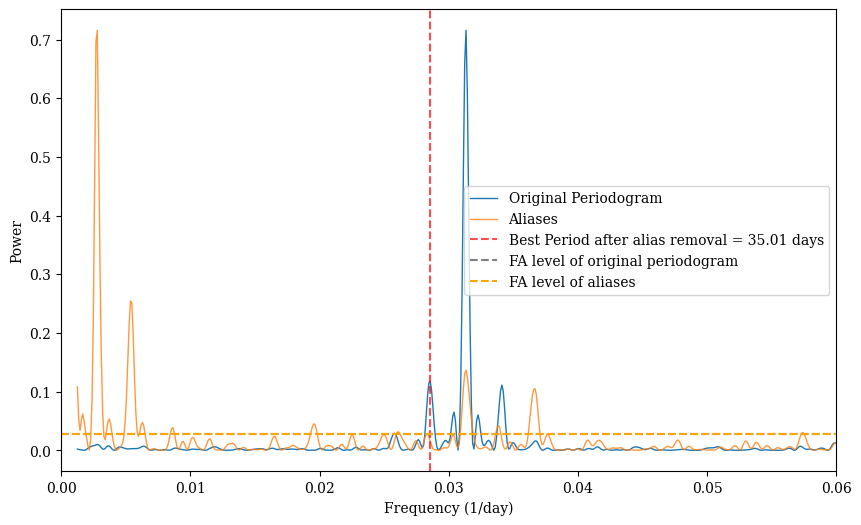

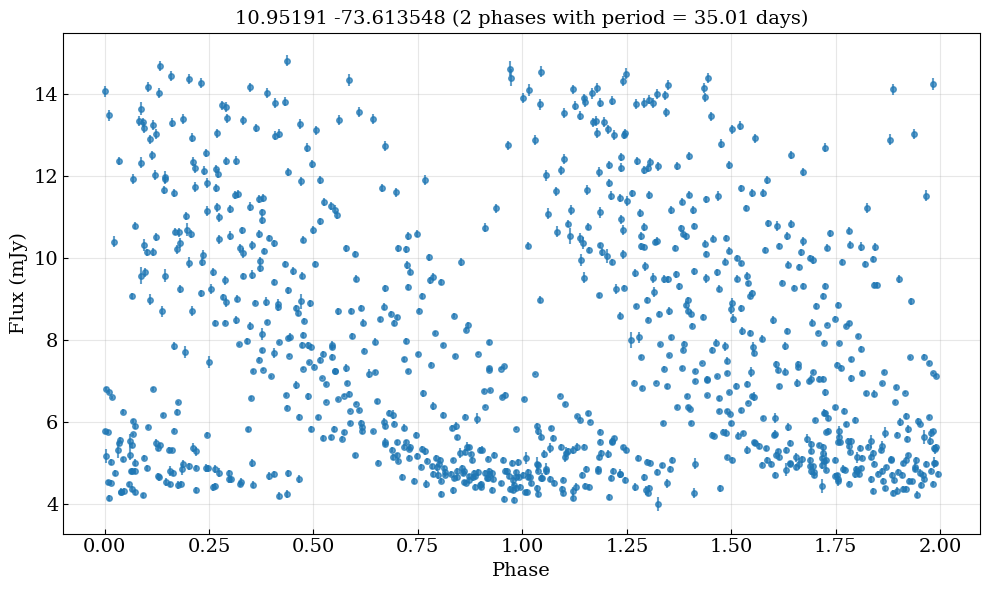

Average scatter (amplitude) per 10 point phase bin: 7.322 mJy
FAL: 0.02790377, Alias FAL: 0.02790377
Alias false alarm probability: 4.253e-261
Best frequency: 0.031336 1/day, Best period: 31.91 days, Max power: 0.716, False alarm probability: 4.253e-261
False alarm level for 1.0%: 2.790e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


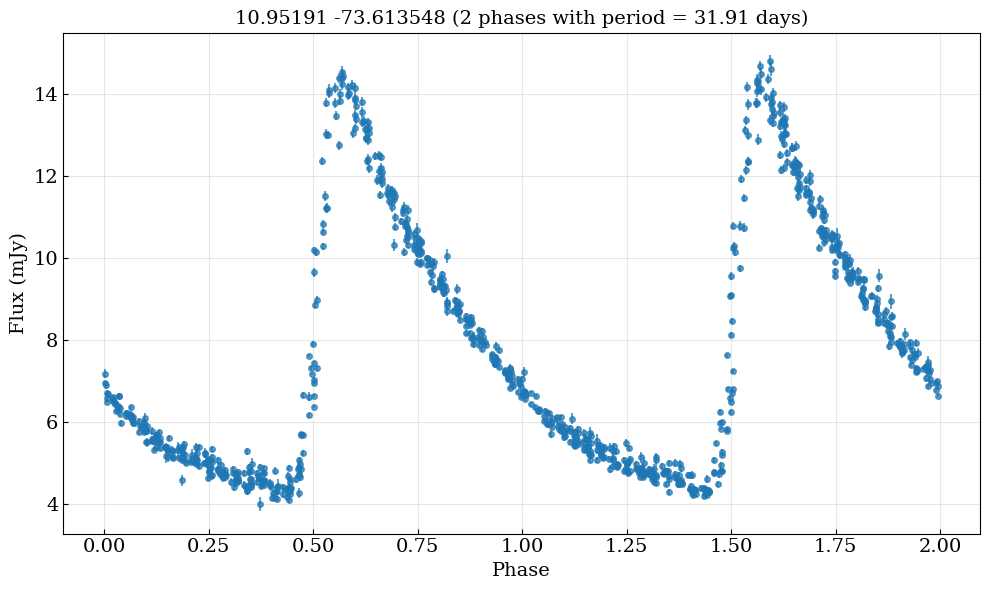

Average scatter (amplitude) per 10 point phase bin: 0.856 mJy
Target 25 
FAL: 0.02801256, Alias FAL: 0.02801256
Alias false alarm probability: 2.757e-27
Best frequency: 0.004750 1/day, Best period: 210.52 days, Max power: 0.047, False alarm probability: 8.482e-07
False alarm level for 1.0%: 2.801e-02


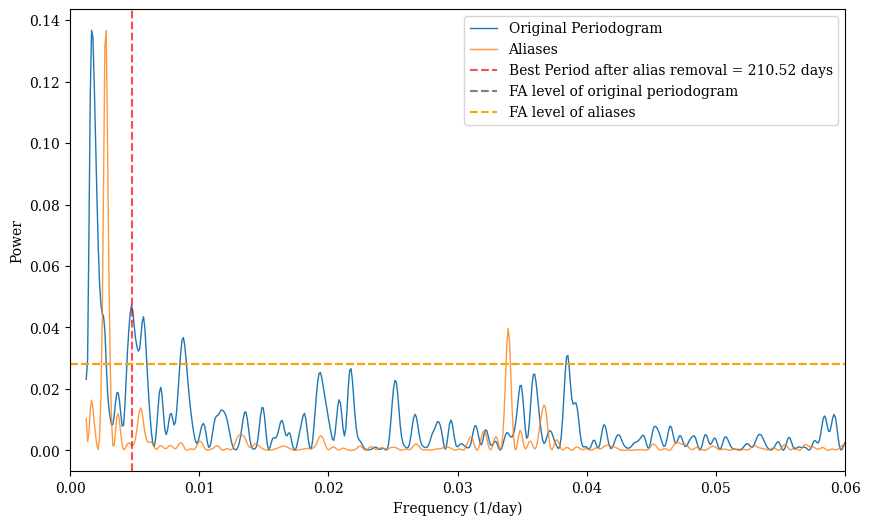

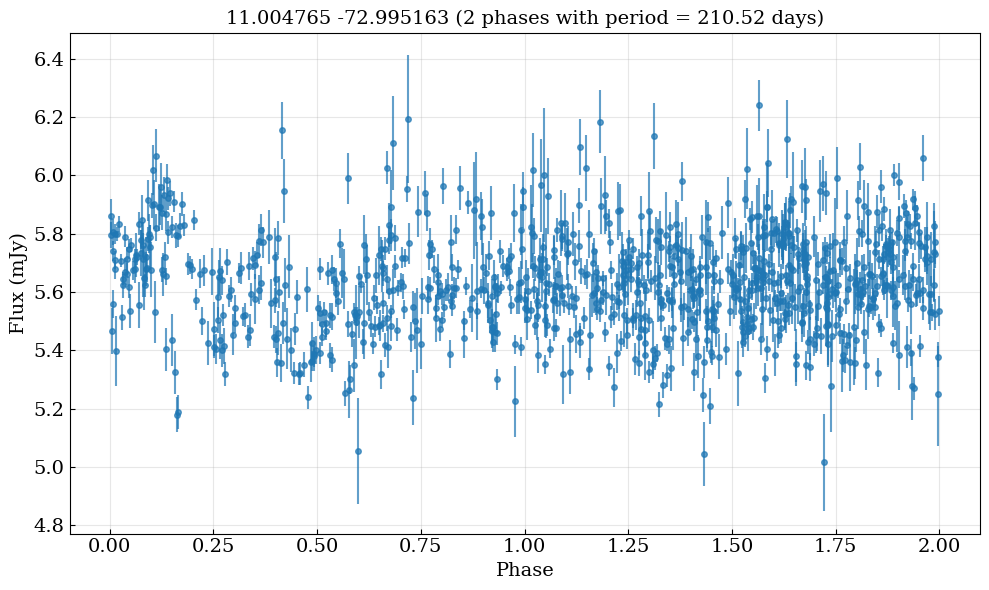

Average scatter (amplitude) per 10 point phase bin: 0.479 mJy
FAL: 0.02801256, Alias FAL: 0.02801256
Alias false alarm probability: 2.757e-27
Best frequency: 0.001660 1/day, Best period: 602.43 days, Max power: 0.137, False alarm probability: 2.757e-27
False alarm level for 1.0%: 2.801e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


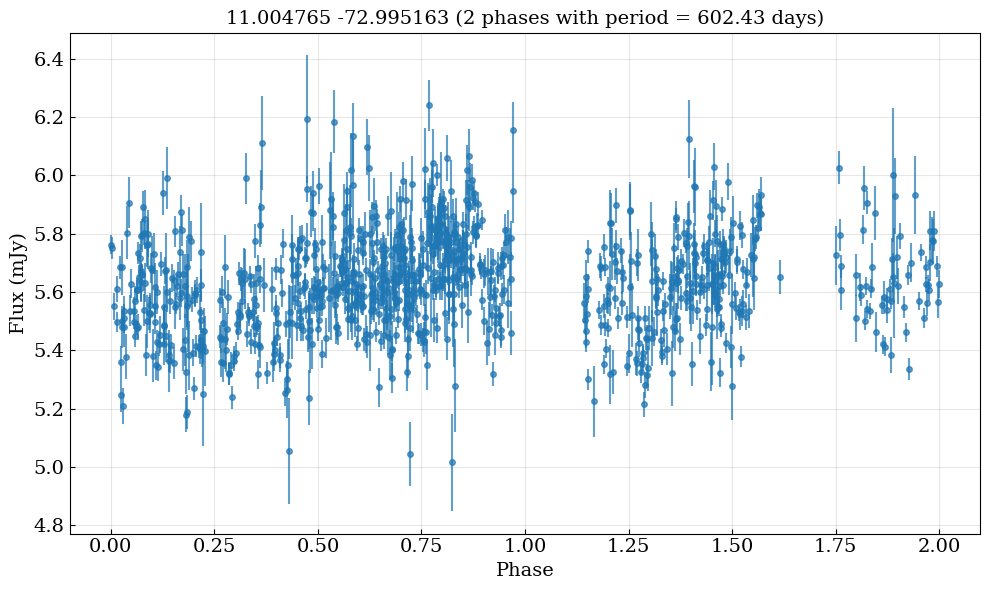

Average scatter (amplitude) per 10 point phase bin: 0.476 mJy
Target 36 
FAL: 0.02793482, Alias FAL: 0.02793482
Alias false alarm probability: 3.757e-292
Best frequency: 0.012441 1/day, Best period: 80.38 days, Max power: 0.111, False alarm probability: 2.882e-21
False alarm level for 1.0%: 2.793e-02


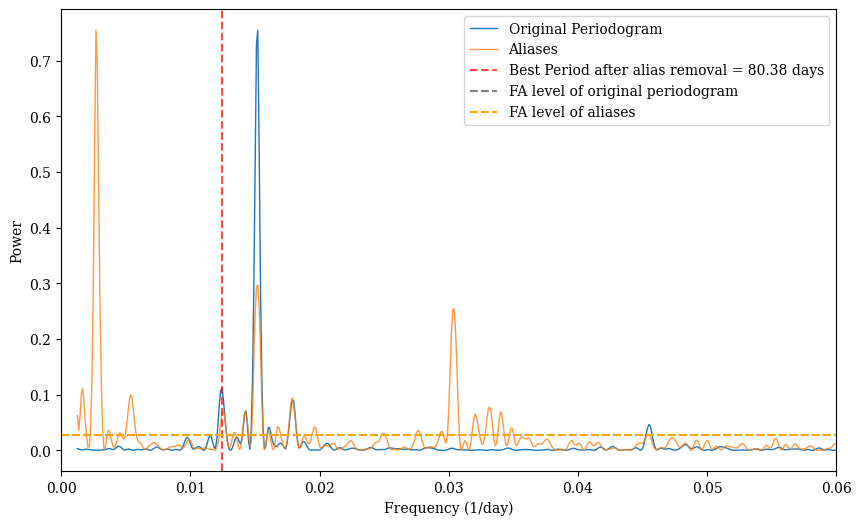

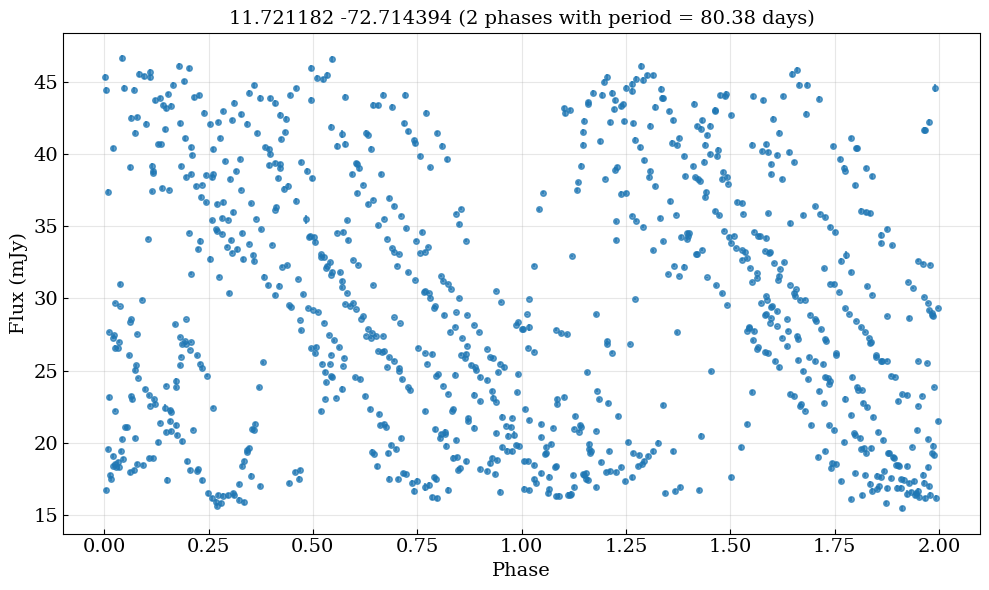

Average scatter (amplitude) per 10 point phase bin: 21.426 mJy
FAL: 0.02793482, Alias FAL: 0.02793482
Alias false alarm probability: 3.757e-292
Best frequency: 0.015214 1/day, Best period: 65.73 days, Max power: 0.755, False alarm probability: 3.757e-292
False alarm level for 1.0%: 2.793e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


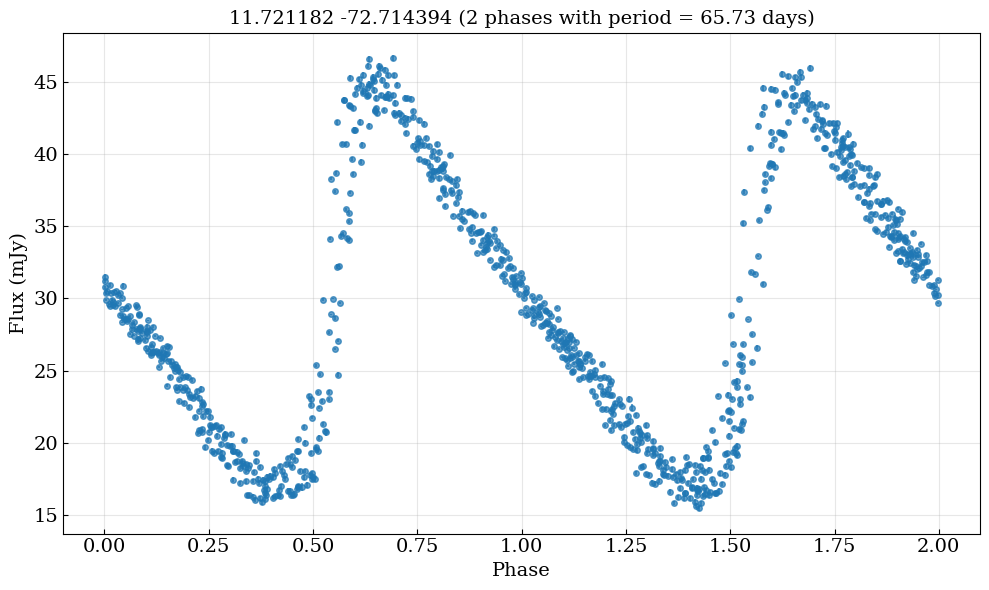

Average scatter (amplitude) per 10 point phase bin: 4.149 mJy
Target 41 
FAL: 0.02792462, Alias FAL: 0.02792462
Alias false alarm probability: 1.103e-291
Best frequency: 0.038936 1/day, Best period: 25.68 days, Max power: 0.132, False alarm probability: 3.465e-26
False alarm level for 1.0%: 2.792e-02


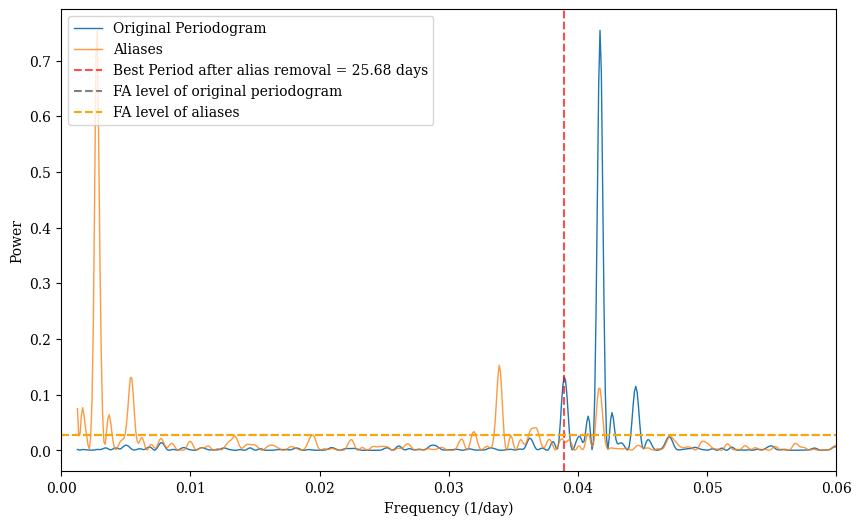

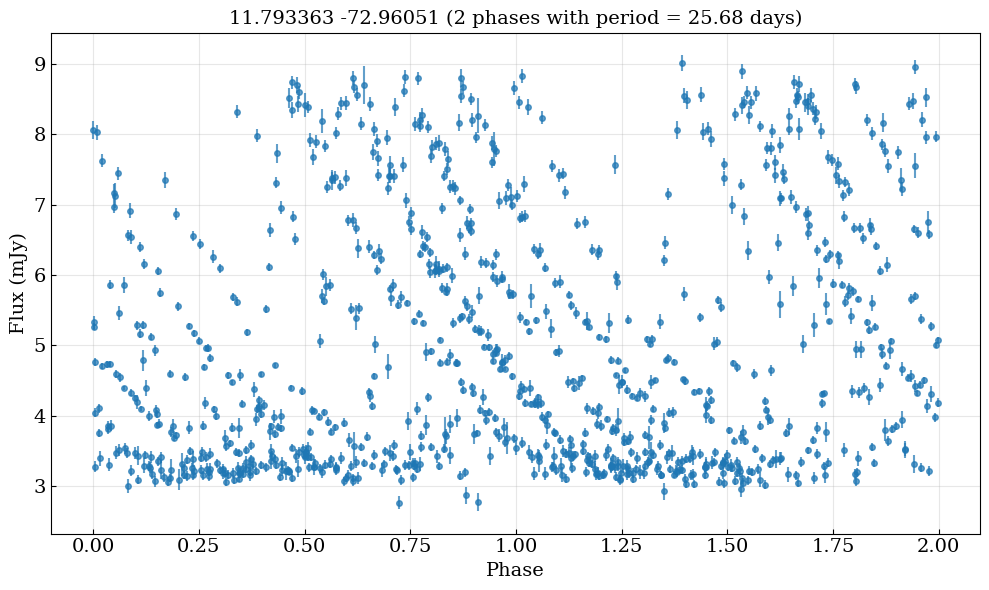

Average scatter (amplitude) per 10 point phase bin: 4.166 mJy
FAL: 0.02792462, Alias FAL: 0.02792462
Alias false alarm probability: 1.103e-291
Best frequency: 0.041708 1/day, Best period: 23.98 days, Max power: 0.754, False alarm probability: 1.103e-291
False alarm level for 1.0%: 2.792e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


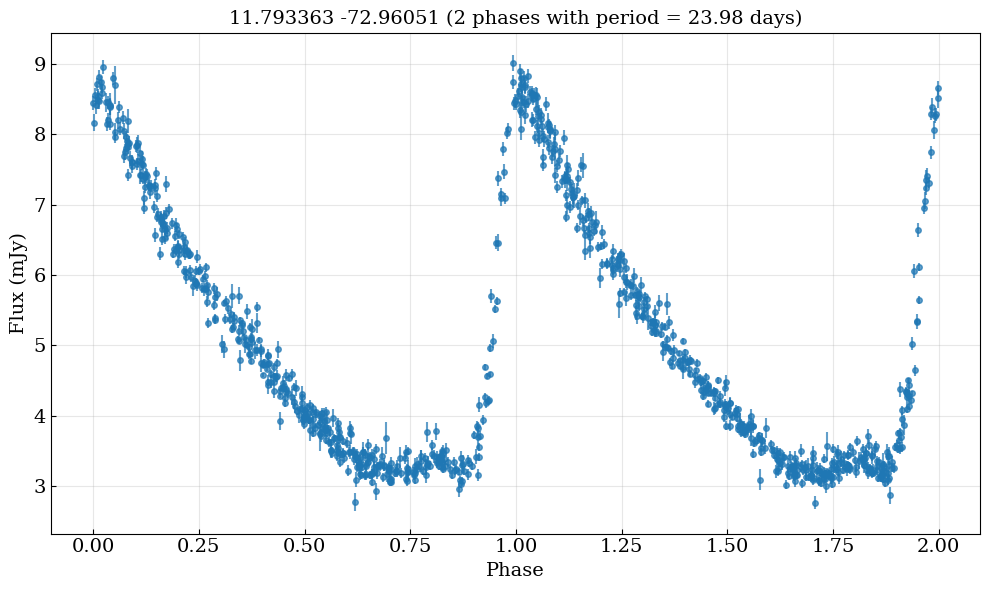

Average scatter (amplitude) per 10 point phase bin: 0.605 mJy
Target 146 
FAL: 0.02128638, Alias FAL: 0.02128638
Alias false alarm probability: 4.616e-08
Best frequency: 0.004310 1/day, Best period: 232.00 days, Max power: 0.032, False alarm probability: 1.561e-05
False alarm level for 1.0%: 2.129e-02


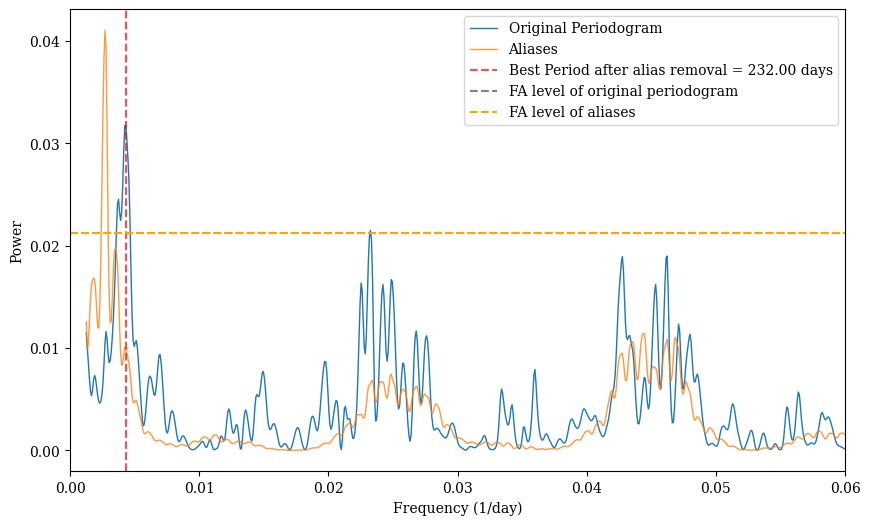

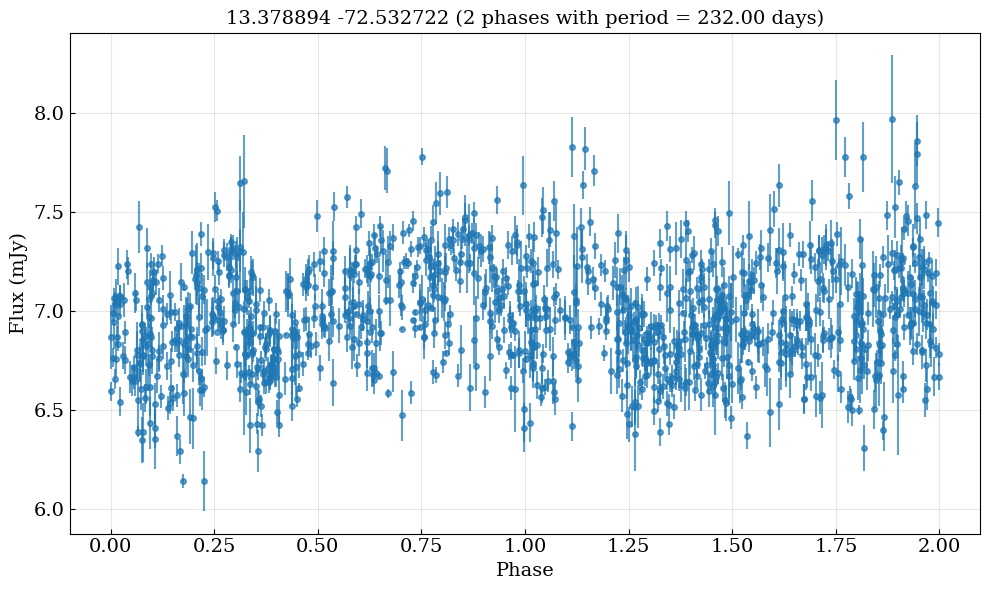

Average scatter (amplitude) per 10 point phase bin: 0.738 mJy
FAL: 0.02128638, Alias FAL: 0.02128638
Alias false alarm probability: 4.616e-08
Best frequency: 0.070959 1/day, Best period: 14.09 days, Max power: 0.041, False alarm probability: 4.616e-08
False alarm level for 1.0%: 2.129e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


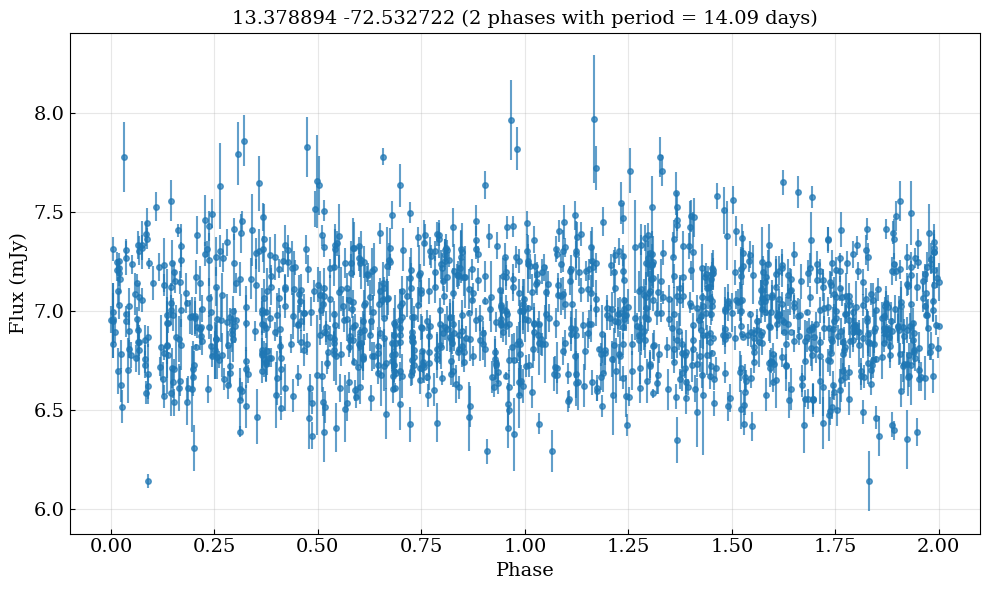

Average scatter (amplitude) per 10 point phase bin: 0.808 mJy
Target 149 
FAL: 0.02216518, Alias FAL: 0.02216518
Alias false alarm probability: 8.277e-25
Best frequency: 0.889229 1/day, Best period: 1.12 days, Max power: 0.088, False alarm probability: 4.379e-21
False alarm level for 1.0%: 2.217e-02


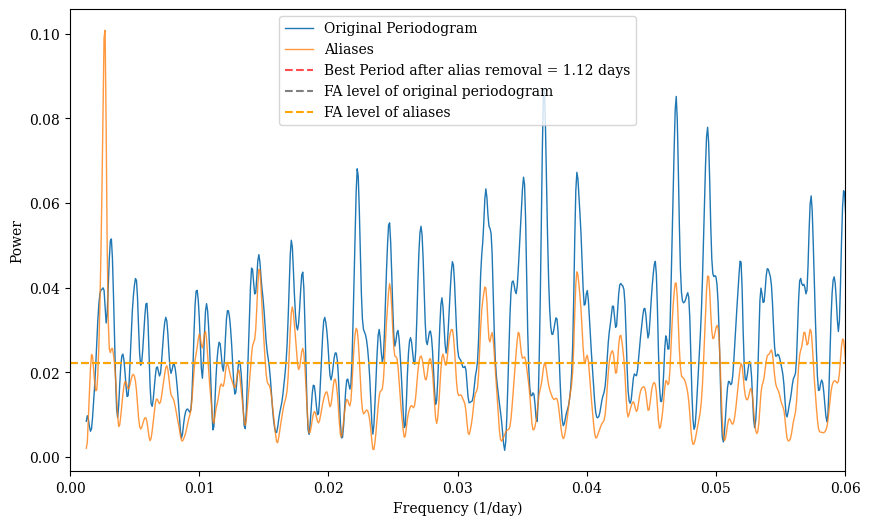

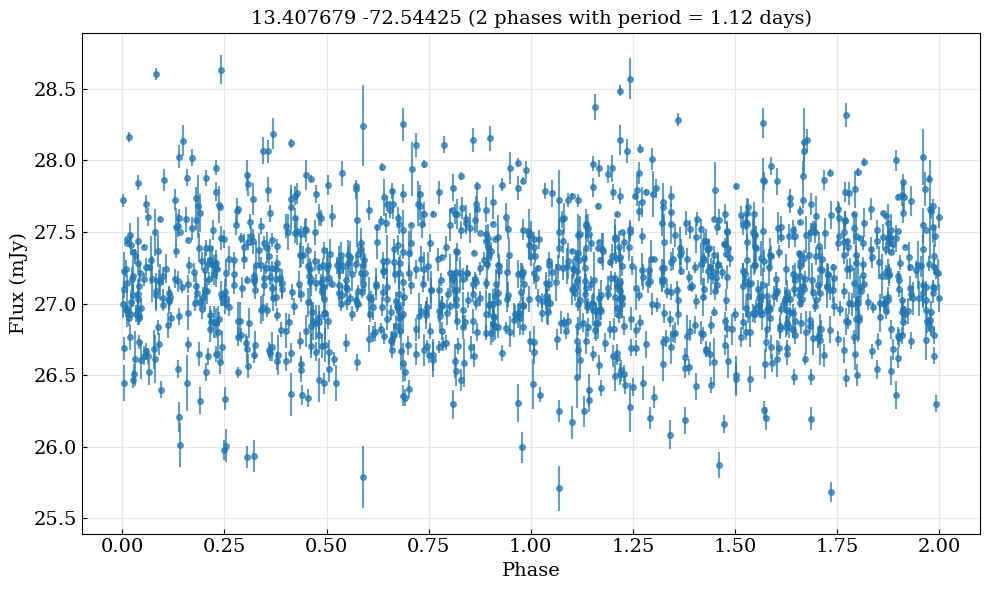

Average scatter (amplitude) per 10 point phase bin: 1.241 mJy
FAL: 0.02216518, Alias FAL: 0.02216518
Alias false alarm probability: 8.277e-25
Best frequency: 0.624171 1/day, Best period: 1.60 days, Max power: 0.101, False alarm probability: 8.277e-25
False alarm level for 1.0%: 2.217e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


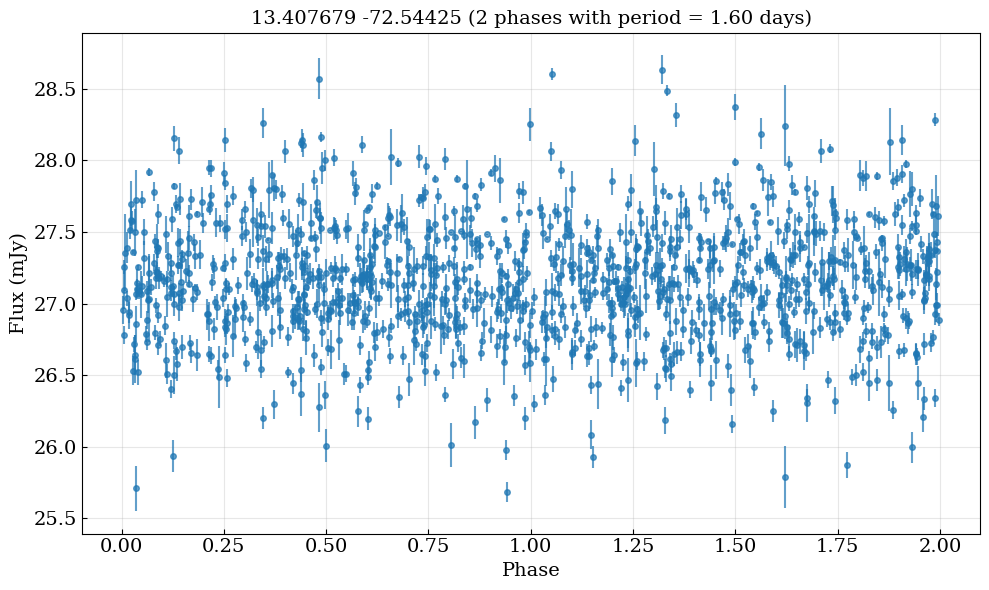

Average scatter (amplitude) per 10 point phase bin: 1.234 mJy
Target 166 
FAL: 0.02180429, Alias FAL: 0.02180429
Alias false alarm probability: 3.958e-33
Best frequency: 0.002938 1/day, Best period: 340.42 days, Max power: 0.124, False alarm probability: 4.342e-32
False alarm level for 1.0%: 2.180e-02


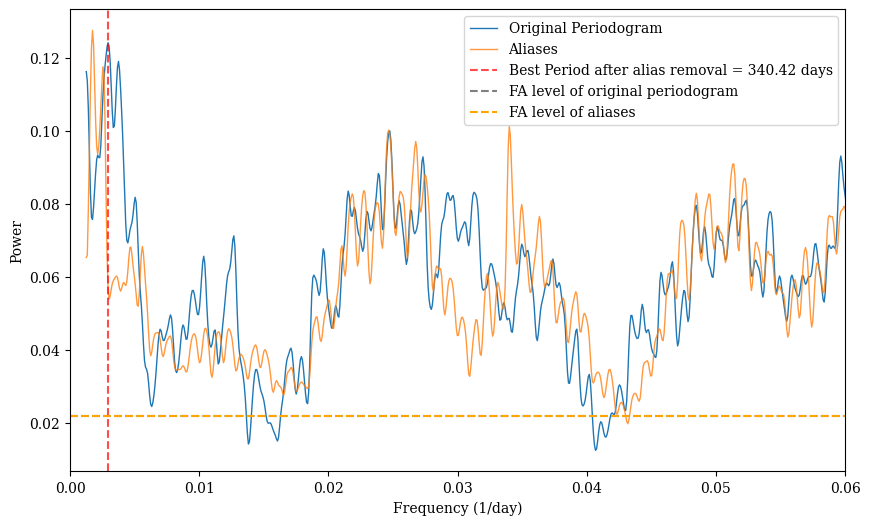

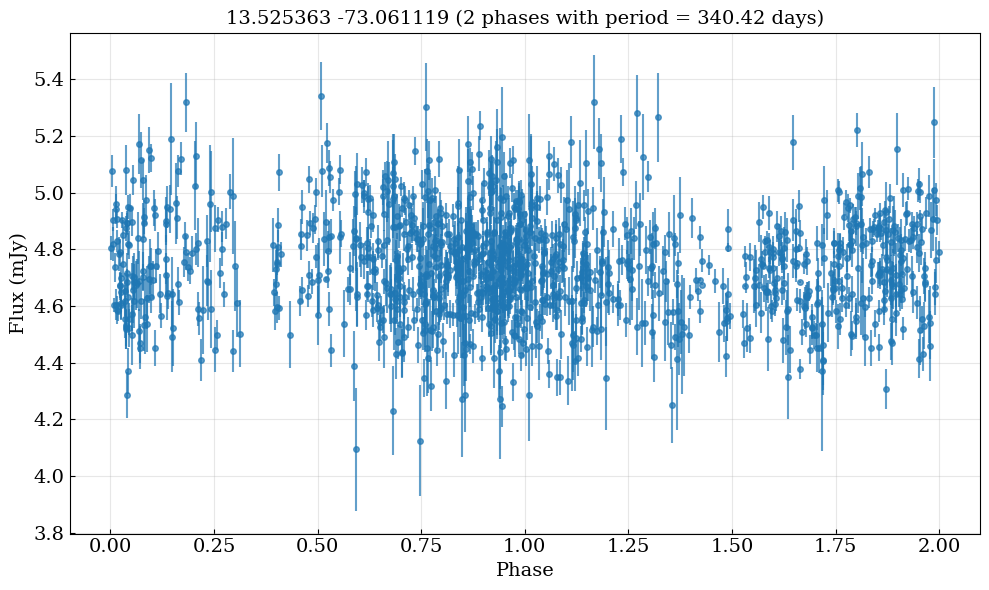

Average scatter (amplitude) per 10 point phase bin: 0.516 mJy
FAL: 0.02180429, Alias FAL: 0.02180429
Alias false alarm probability: 3.958e-33
Best frequency: 0.720008 1/day, Best period: 1.39 days, Max power: 0.128, False alarm probability: 3.958e-33
False alarm level for 1.0%: 2.180e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


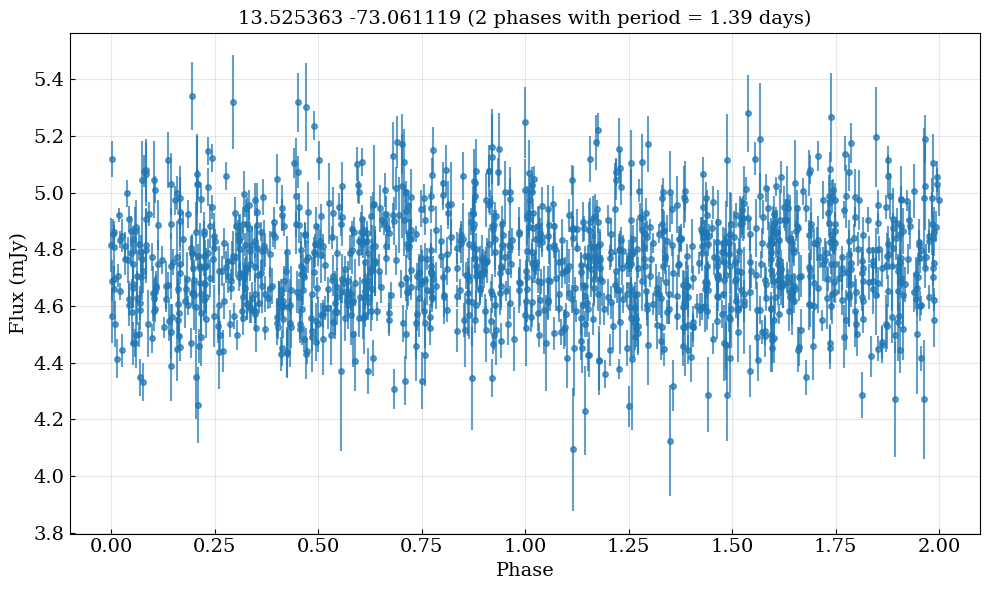

Average scatter (amplitude) per 10 point phase bin: 0.534 mJy
Target 186 
FAL: 0.02111735, Alias FAL: 0.02111735
Alias false alarm probability: 1.681e-20
Best frequency: 0.004000 1/day, Best period: 249.98 days, Max power: 0.045, False alarm probability: 1.299e-09
False alarm level for 1.0%: 2.112e-02


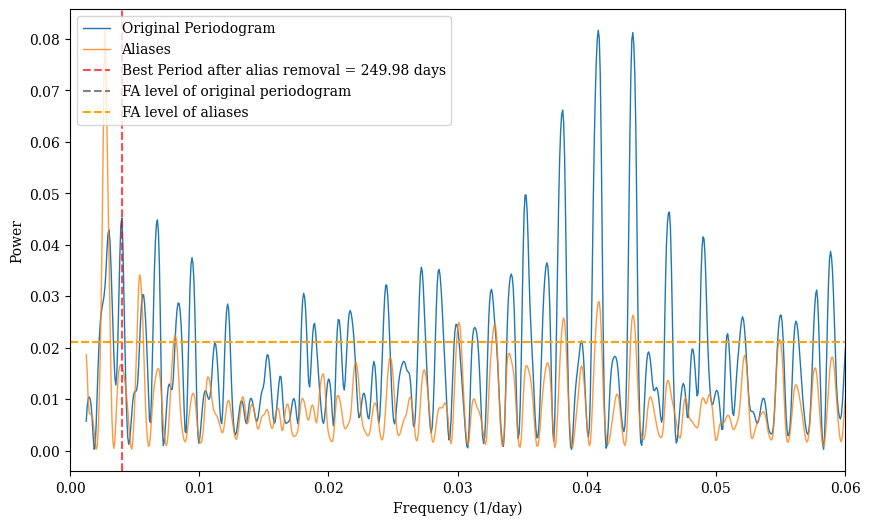

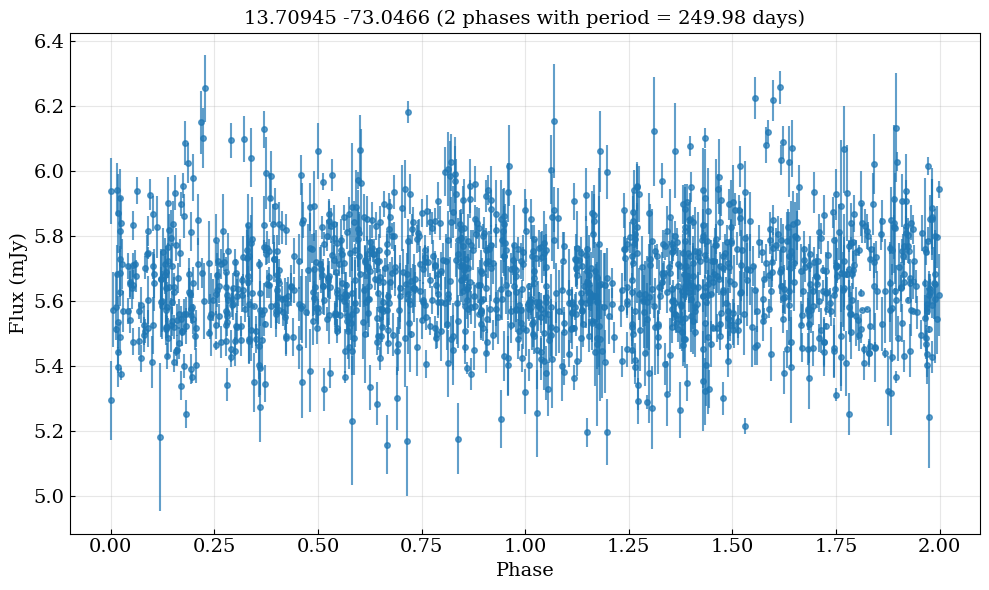

Average scatter (amplitude) per 10 point phase bin: 0.494 mJy
FAL: 0.02111735, Alias FAL: 0.02111735
Alias false alarm probability: 1.681e-20
Best frequency: 0.040884 1/day, Best period: 24.46 days, Max power: 0.082, False alarm probability: 1.681e-20
False alarm level for 1.0%: 2.112e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


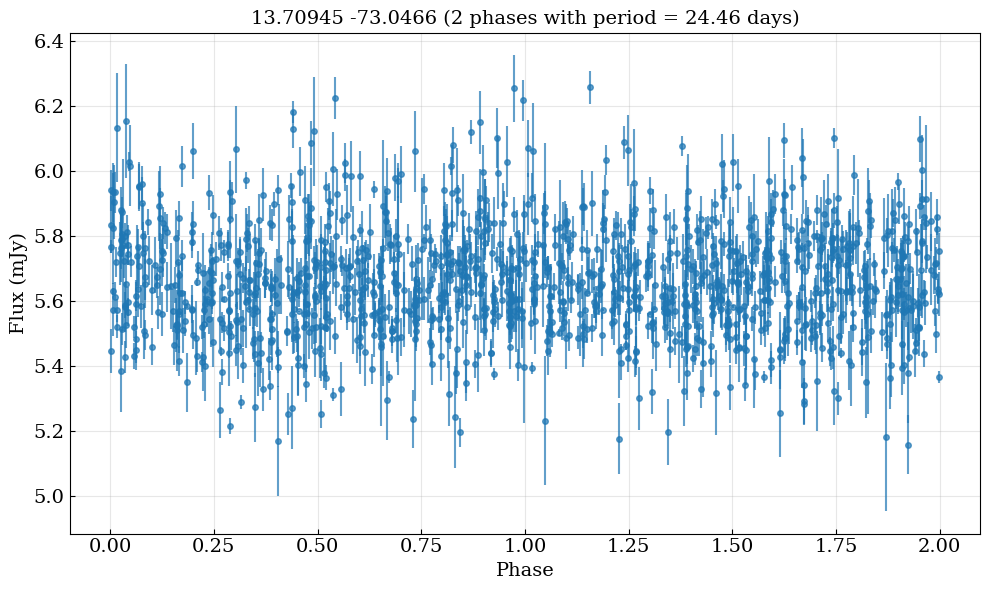

Average scatter (amplitude) per 10 point phase bin: 0.489 mJy
Target 193 
FAL: 0.01728574, Alias FAL: 0.01728574
Alias false alarm probability: 1.187e-06
Best frequency: 0.002055 1/day, Best period: 486.70 days, Max power: 0.020, False alarm probability: 1.244e-03
False alarm level for 1.0%: 1.729e-02


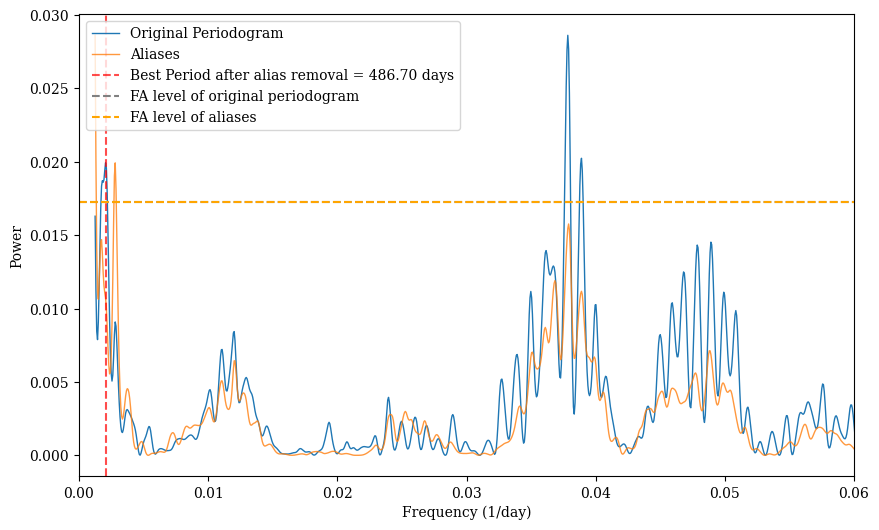

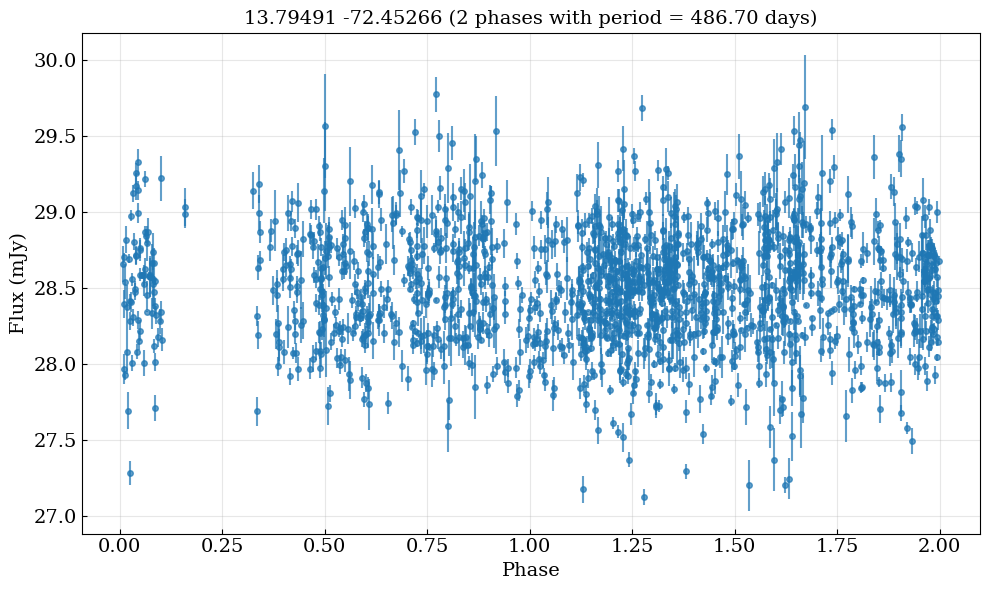

Average scatter (amplitude) per 10 point phase bin: 1.124 mJy
FAL: 0.01728574, Alias FAL: 0.01728574
Alias false alarm probability: 1.187e-06
Best frequency: 0.037841 1/day, Best period: 26.43 days, Max power: 0.029, False alarm probability: 1.187e-06
False alarm level for 1.0%: 1.729e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


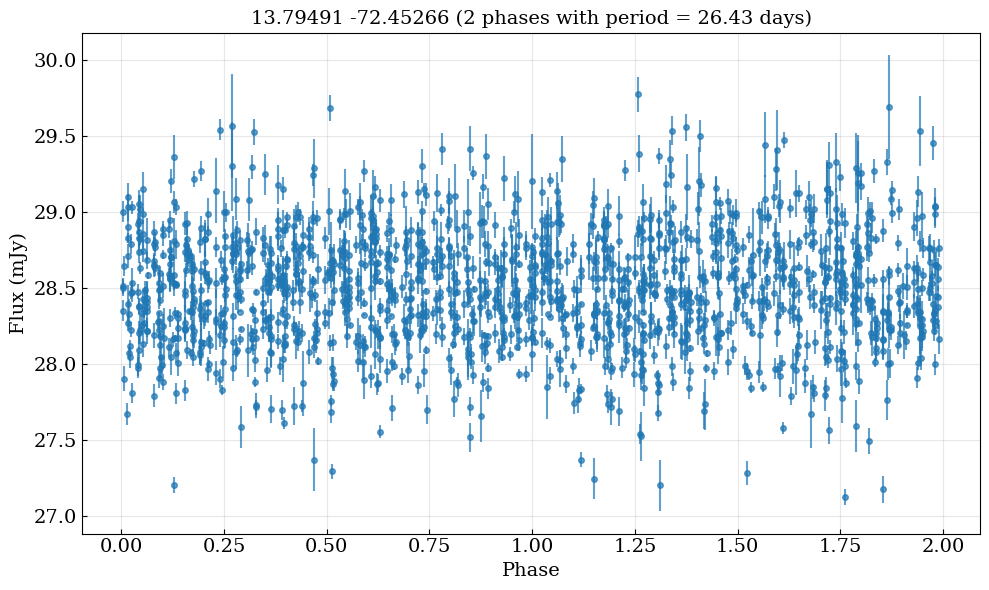

Average scatter (amplitude) per 10 point phase bin: 1.076 mJy
Target 244 
FAL: 0.01238804, Alias FAL: 0.01238804
Alias false alarm probability: 0.000e+00
Best frequency: 0.022858 1/day, Best period: 43.75 days, Max power: 0.116, False alarm probability: 5.235e-59
False alarm level for 1.0%: 1.239e-02


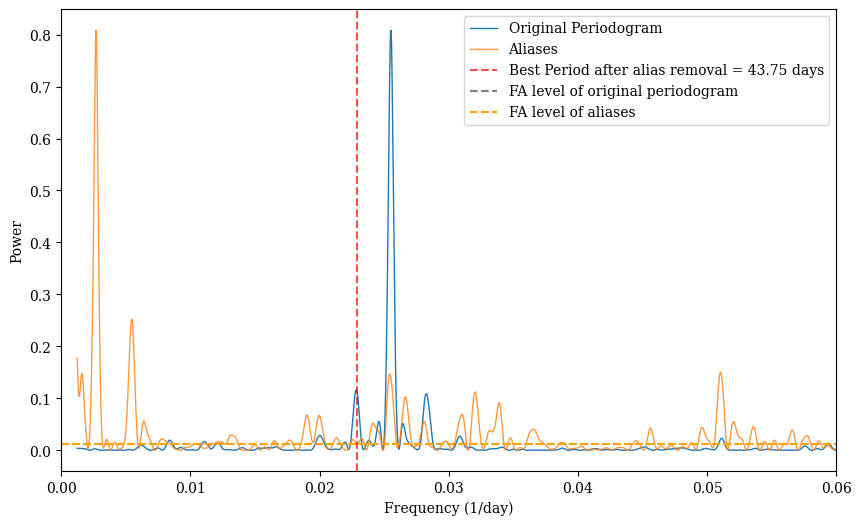

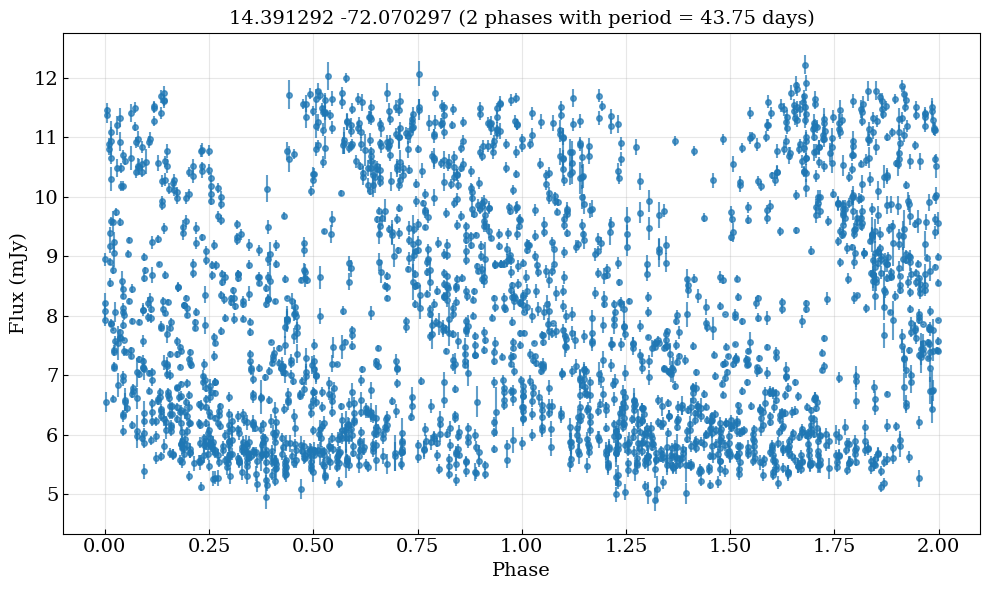

Average scatter (amplitude) per 10 point phase bin: 4.110 mJy
FAL: 0.01238804, Alias FAL: 0.01238804
Alias false alarm probability: 0.000e+00
Best frequency: 0.025535 1/day, Best period: 39.16 days, Max power: 0.808, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.239e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


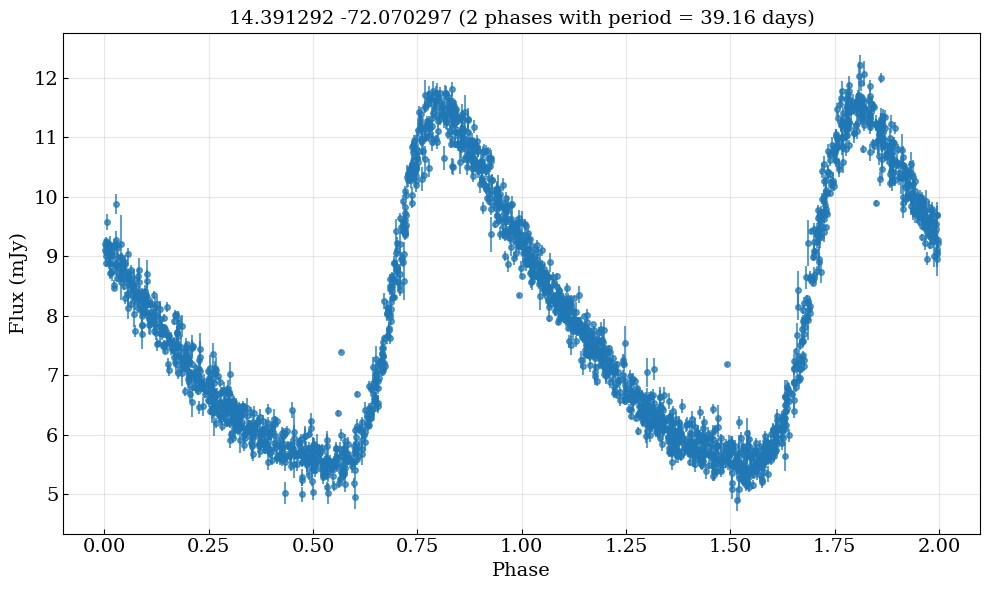

Average scatter (amplitude) per 10 point phase bin: 0.750 mJy
Target 268 
FAL: 0.01679534, Alias FAL: 0.01679534
Alias false alarm probability: 8.706e-19
Best frequency: 0.002269 1/day, Best period: 440.82 days, Max power: 0.054, False alarm probability: 2.051e-16
False alarm level for 1.0%: 1.680e-02


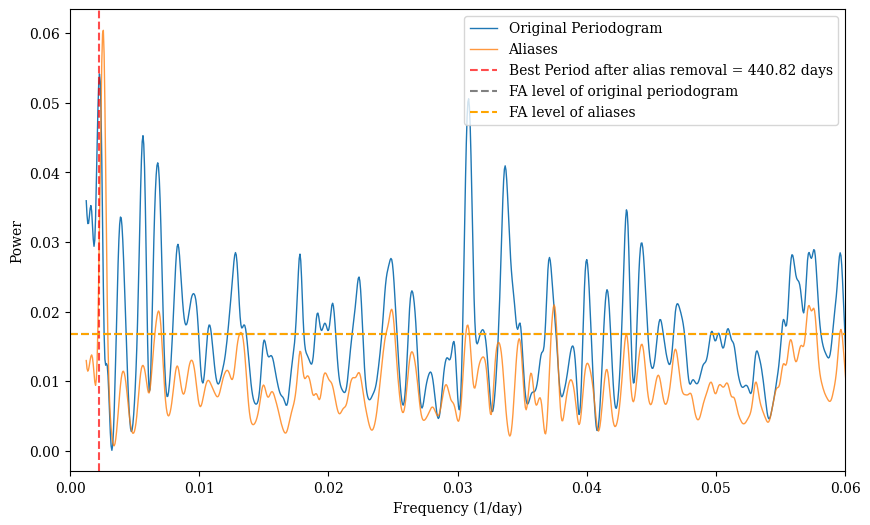

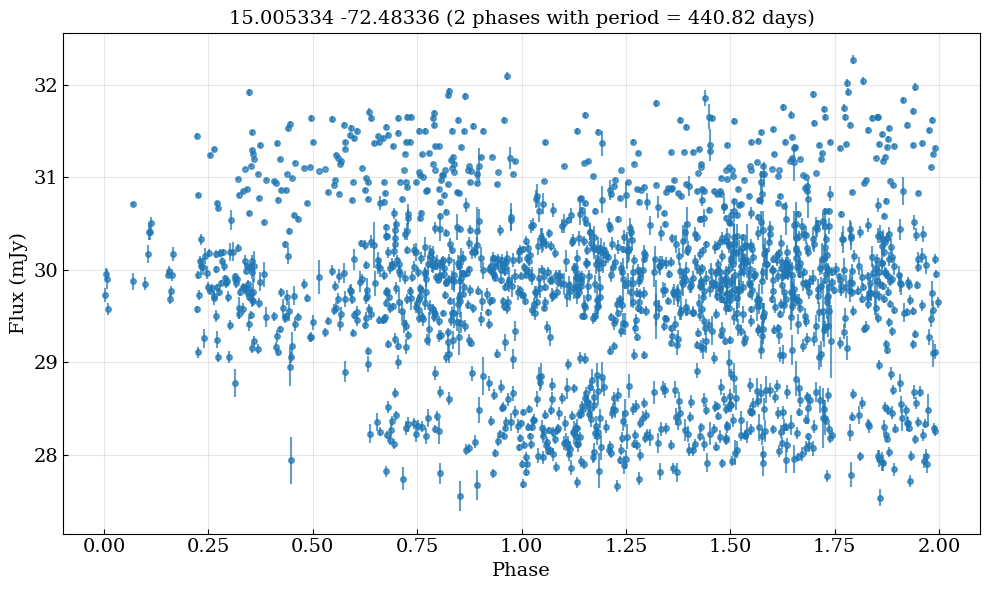

Average scatter (amplitude) per 10 point phase bin: 2.690 mJy
FAL: 0.01679534, Alias FAL: 0.01679534
Alias false alarm probability: 8.706e-19
Best frequency: 0.432631 1/day, Best period: 2.31 days, Max power: 0.060, False alarm probability: 8.706e-19
False alarm level for 1.0%: 1.680e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


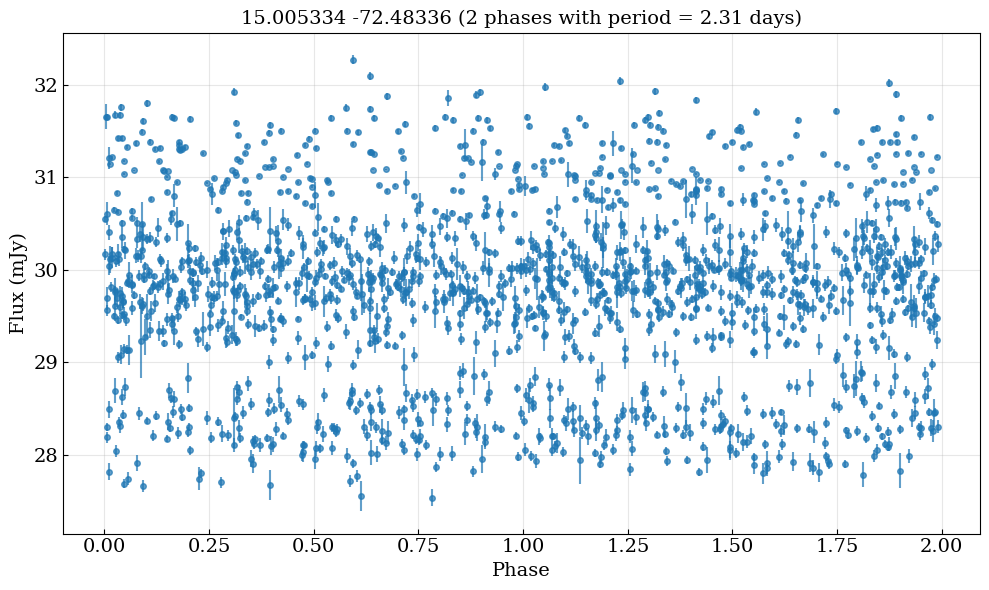

Average scatter (amplitude) per 10 point phase bin: 2.915 mJy
Target 277 
FAL: 0.01699219, Alias FAL: 0.01699219
Alias false alarm probability: 6.306e-29
Best frequency: 0.789588 1/day, Best period: 1.27 days, Max power: 0.076, False alarm probability: 1.617e-24
False alarm level for 1.0%: 1.699e-02


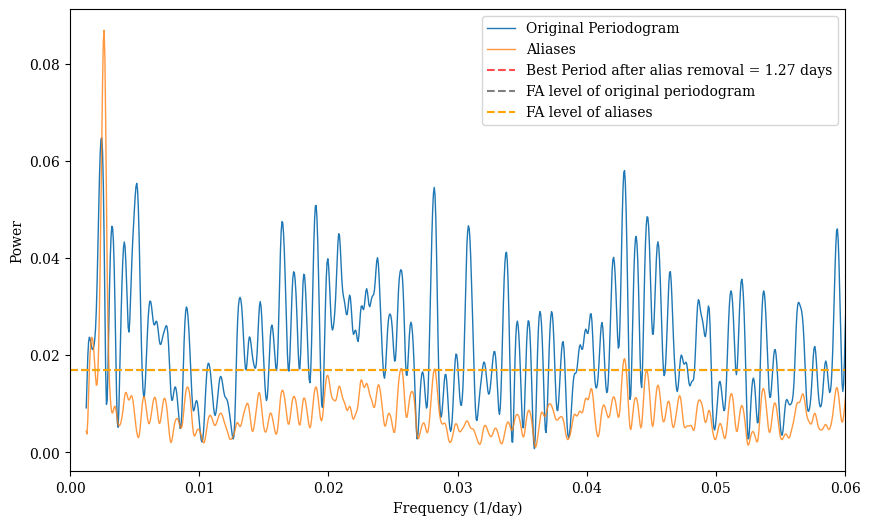

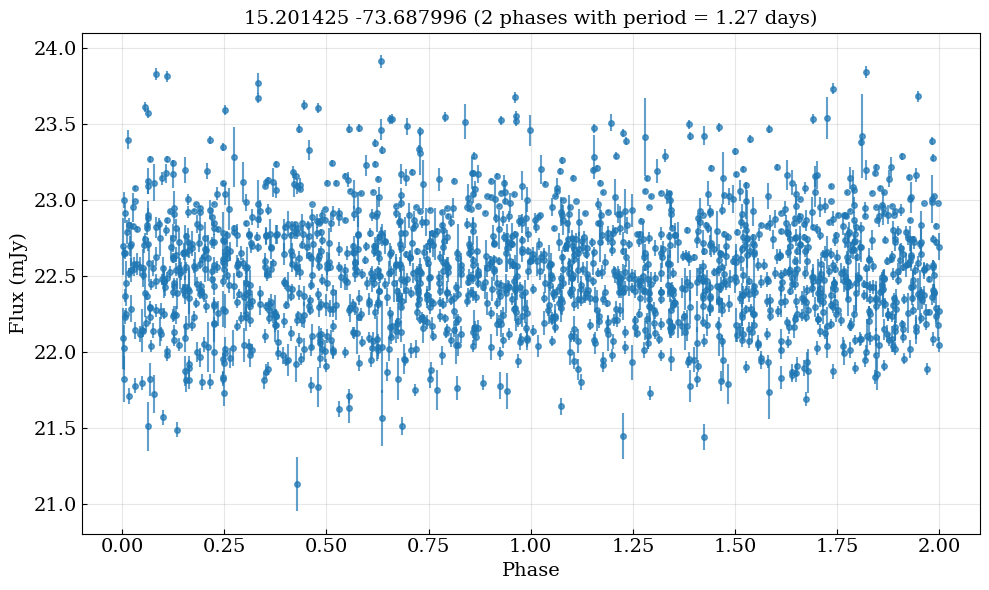

Average scatter (amplitude) per 10 point phase bin: 1.150 mJy
FAL: 0.01699219, Alias FAL: 0.01699219
Alias false alarm probability: 6.306e-29
Best frequency: 0.490584 1/day, Best period: 2.04 days, Max power: 0.087, False alarm probability: 6.306e-29
False alarm level for 1.0%: 1.699e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


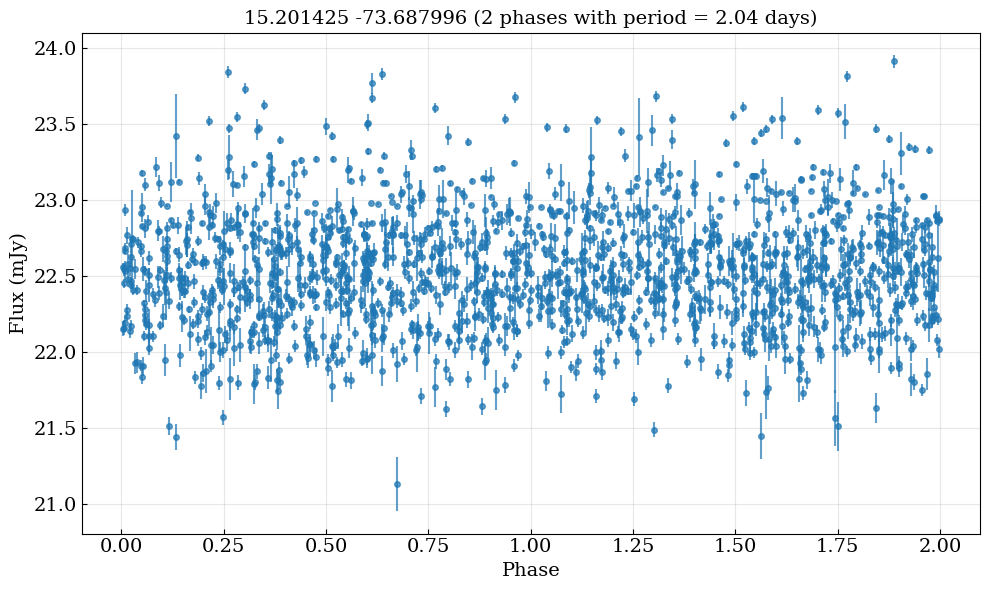

Average scatter (amplitude) per 10 point phase bin: 1.152 mJy
Target 289 
FAL: 0.02187521, Alias FAL: 0.02187521
Alias false alarm probability: 1.716e-09
Best frequency: 0.021220 1/day, Best period: 47.12 days, Max power: 0.040, False alarm probability: 1.047e-07
False alarm level for 1.0%: 2.188e-02


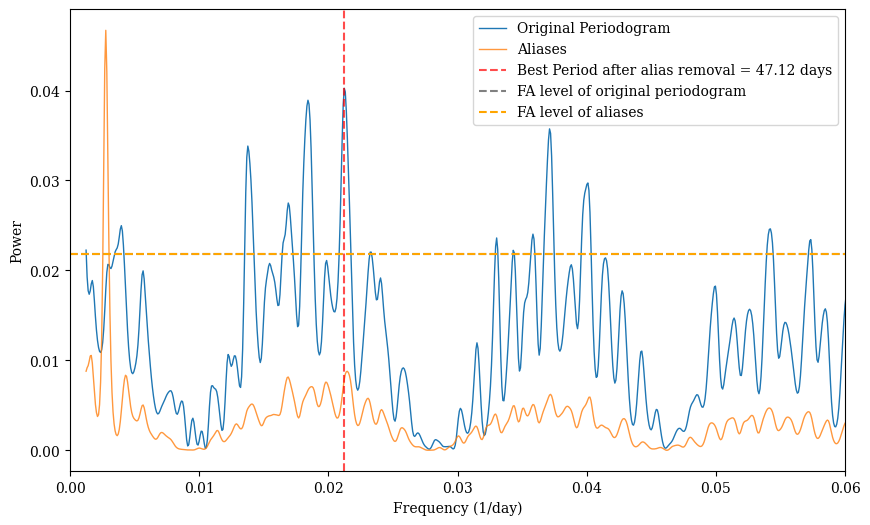

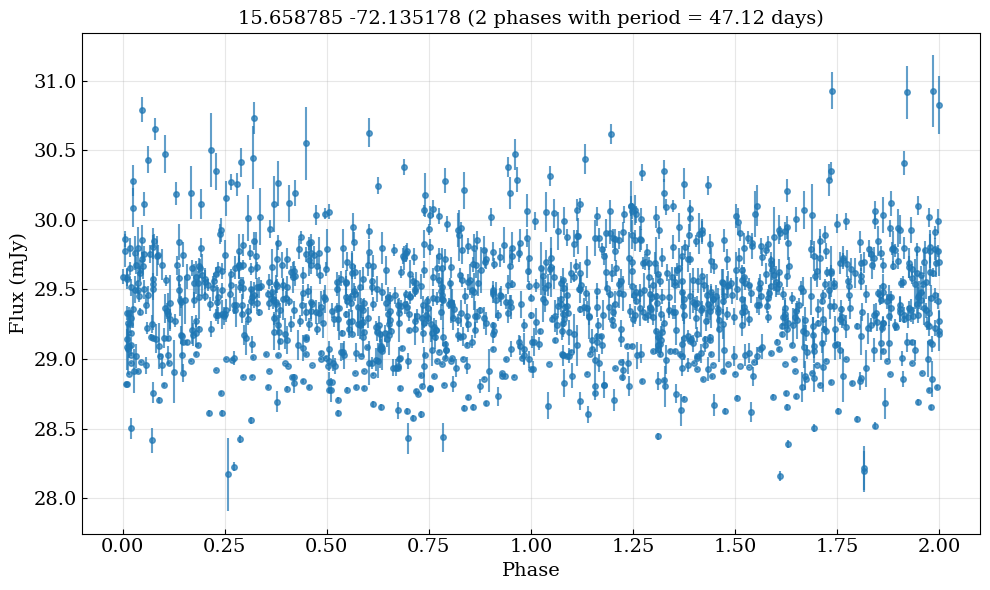

Average scatter (amplitude) per 10 point phase bin: 1.229 mJy
FAL: 0.02187521, Alias FAL: 0.02187521
Alias false alarm probability: 1.716e-09
Best frequency: 0.236260 1/day, Best period: 4.23 days, Max power: 0.047, False alarm probability: 1.716e-09
False alarm level for 1.0%: 2.188e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


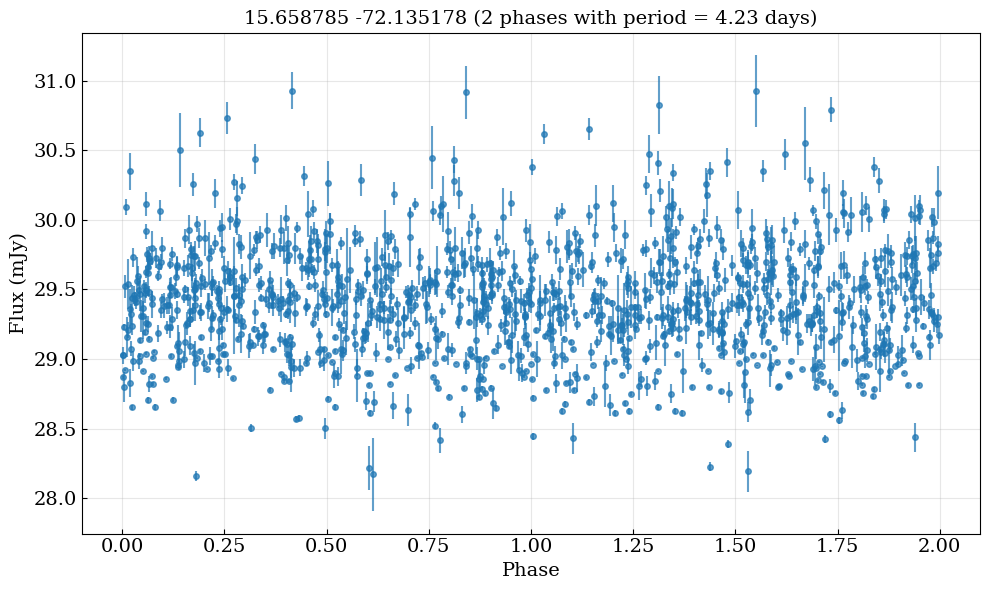

Average scatter (amplitude) per 10 point phase bin: 1.208 mJy
Target 301 
FAL: 0.01833175, Alias FAL: 0.01833175
Alias false alarm probability: 3.677e-42
Best frequency: 0.003702 1/day, Best period: 270.12 days, Max power: 0.100, False alarm probability: 2.066e-30
False alarm level for 1.0%: 1.833e-02


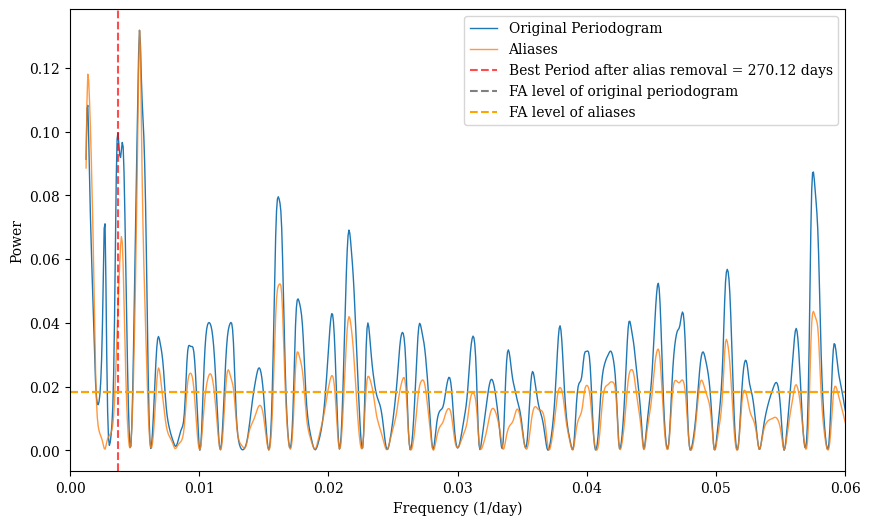

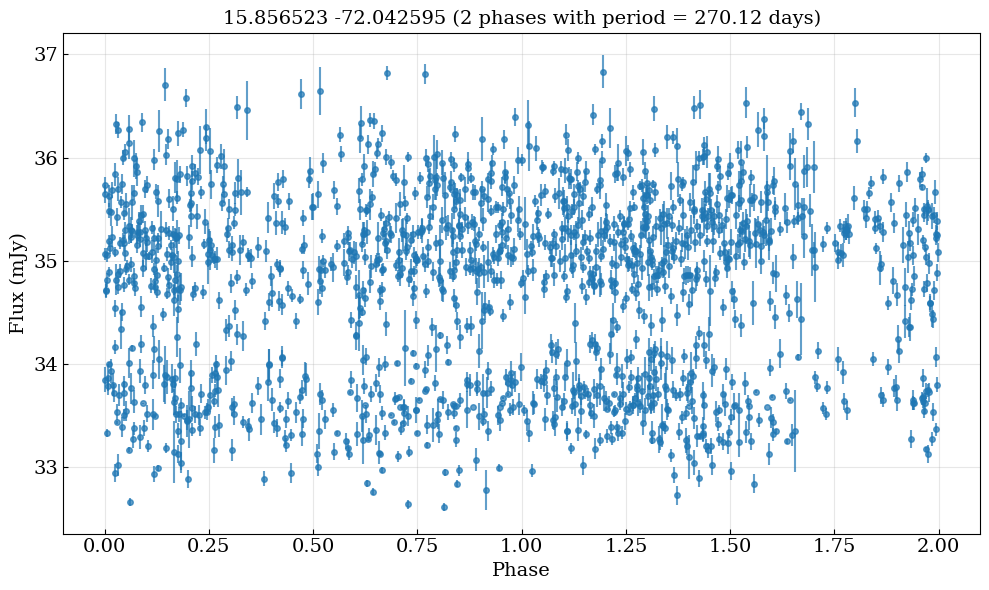

Average scatter (amplitude) per 10 point phase bin: 2.395 mJy
FAL: 0.01833175, Alias FAL: 0.01833175
Alias false alarm probability: 3.677e-42
Best frequency: 0.005370 1/day, Best period: 186.22 days, Max power: 0.132, False alarm probability: 3.677e-42
False alarm level for 1.0%: 1.833e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


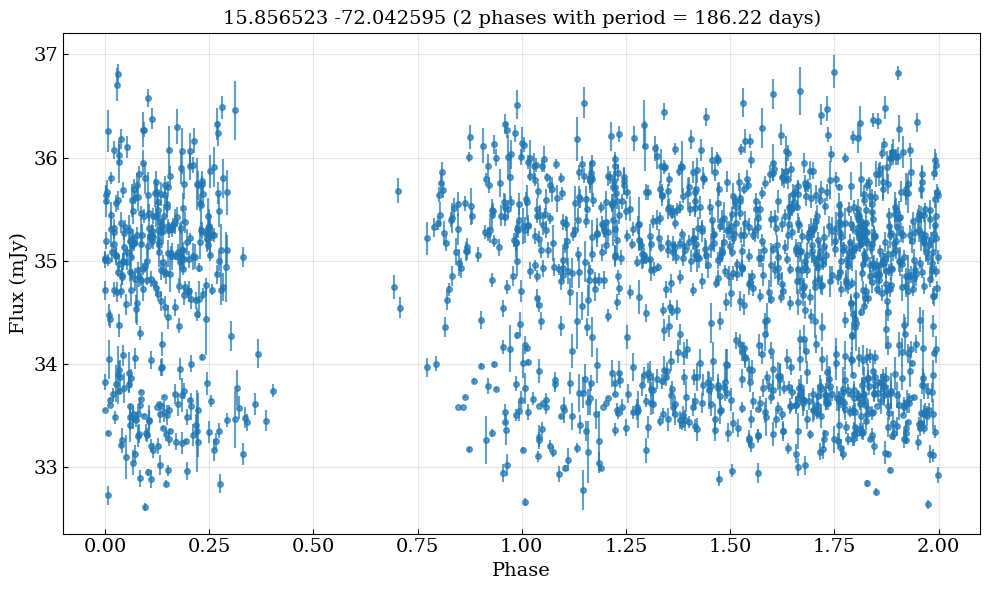

Average scatter (amplitude) per 10 point phase bin: 2.614 mJy
Target 304 
FAL: 0.01928504, Alias FAL: 0.01928504
Alias false alarm probability: 8.721e-12
Best frequency: 0.003337 1/day, Best period: 299.63 days, Max power: 0.024, False alarm probability: 3.365e-04
False alarm level for 1.0%: 1.929e-02


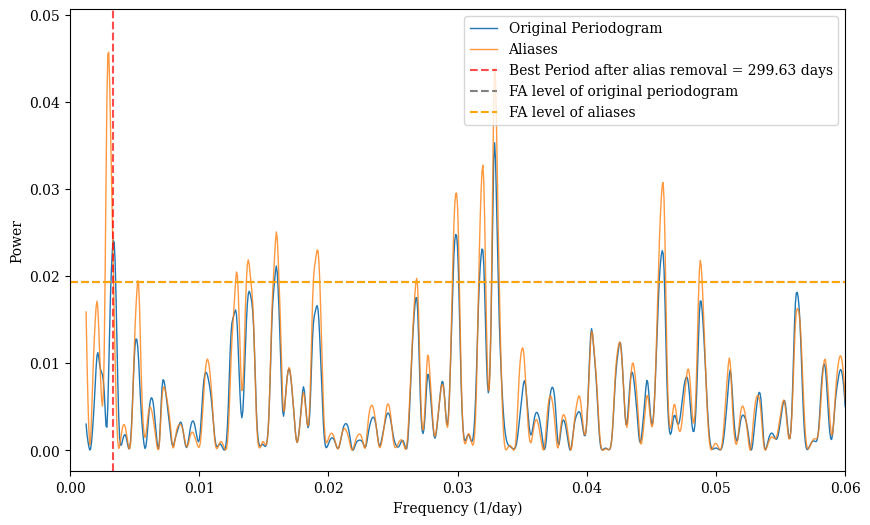

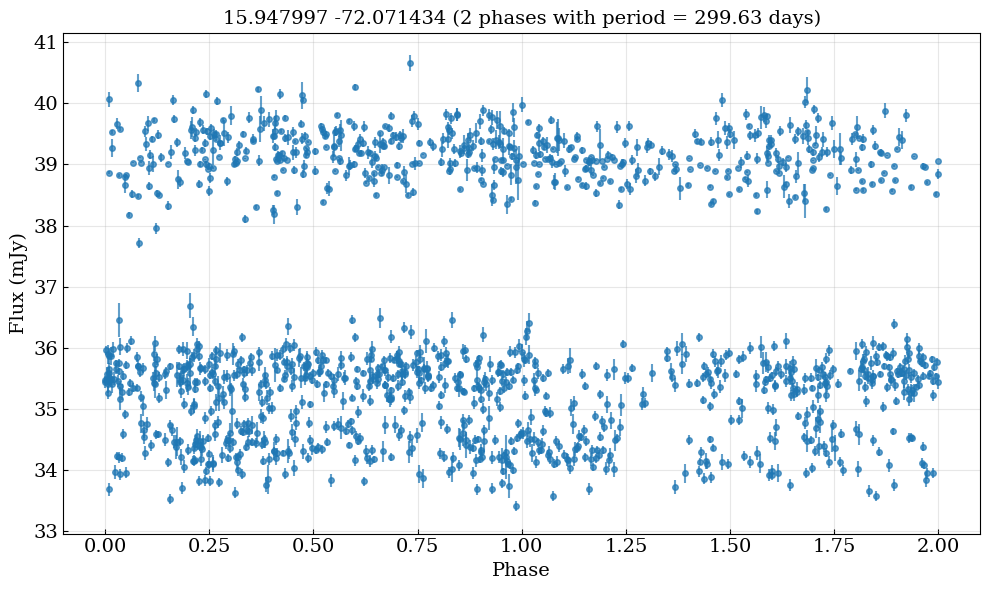

Average scatter (amplitude) per 10 point phase bin: 5.099 mJy
FAL: 0.01928504, Alias FAL: 0.01928504
Alias false alarm probability: 8.721e-12
Best frequency: 0.691211 1/day, Best period: 1.45 days, Max power: 0.048, False alarm probability: 8.721e-12
False alarm level for 1.0%: 1.929e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


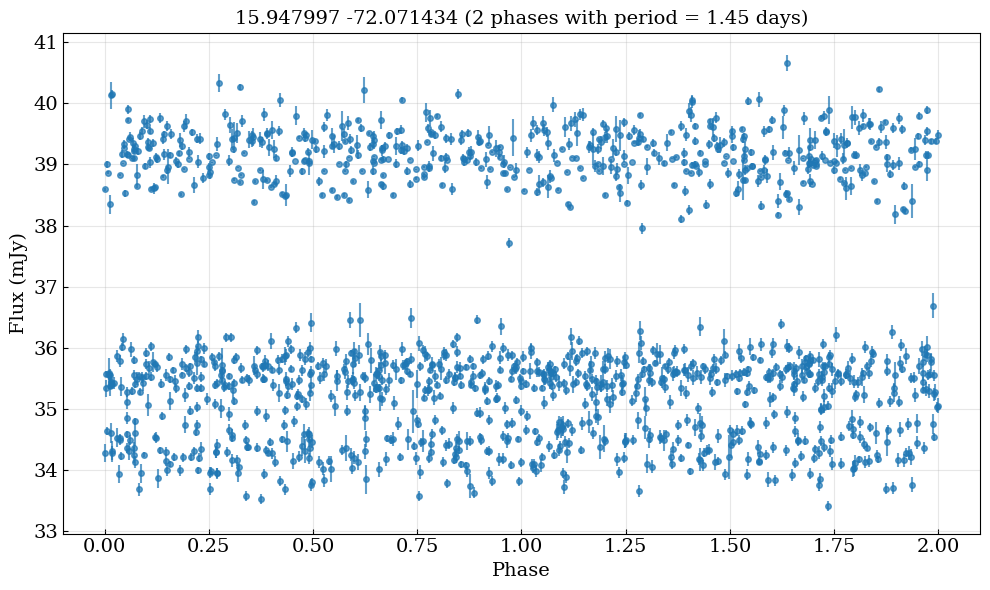

Average scatter (amplitude) per 10 point phase bin: 5.255 mJy
Target 322 
FAL: 0.01211387, Alias FAL: 0.01211387
Alias false alarm probability: 8.588e-153
Best frequency: 0.017952 1/day, Best period: 55.70 days, Max power: 0.071, False alarm probability: 7.798e-34
False alarm level for 1.0%: 1.211e-02


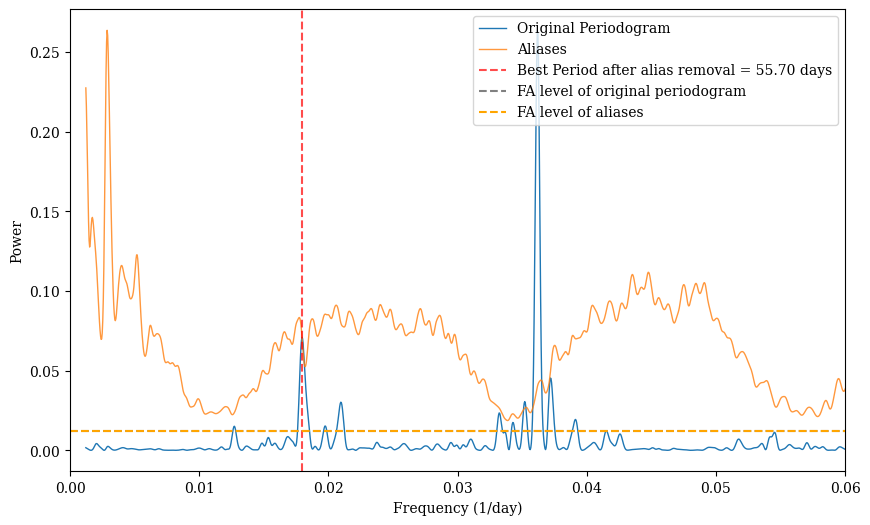

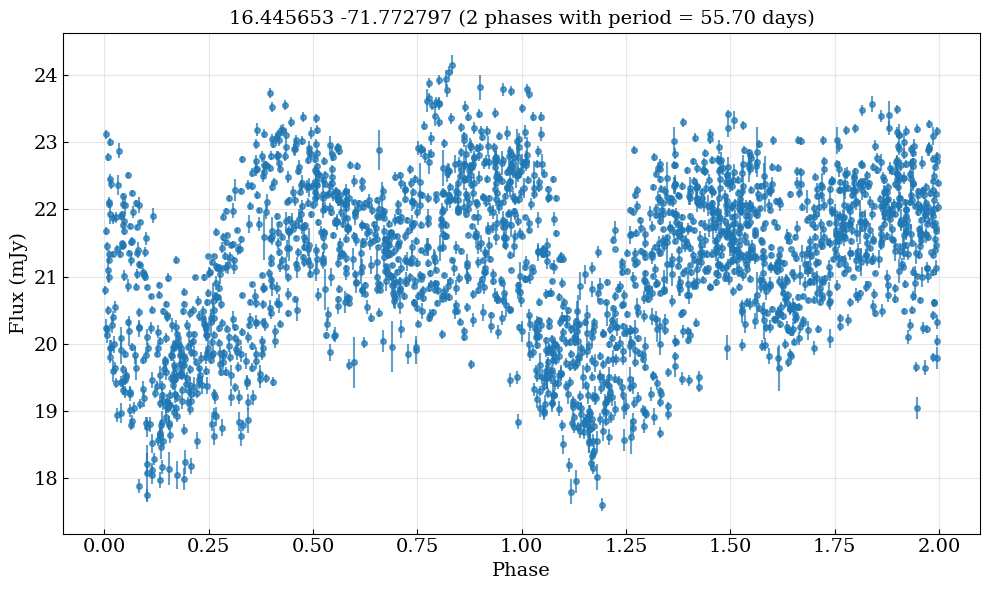

Average scatter (amplitude) per 10 point phase bin: 2.401 mJy
FAL: 0.01211387, Alias FAL: 0.01211387
Alias false alarm probability: 8.588e-153
Best frequency: 0.036170 1/day, Best period: 27.65 days, Max power: 0.264, False alarm probability: 8.588e-153
False alarm level for 1.0%: 1.211e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


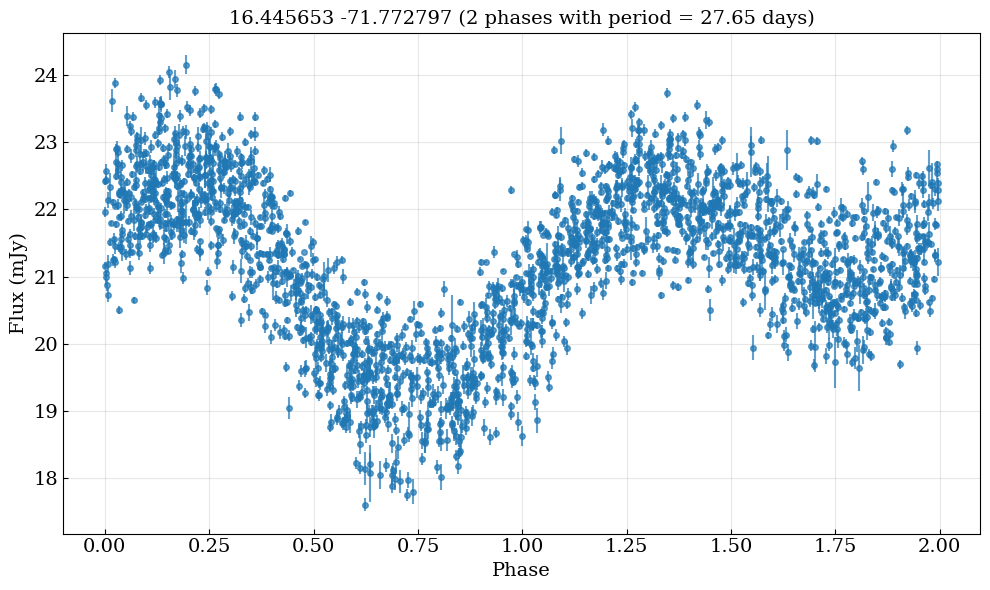

Average scatter (amplitude) per 10 point phase bin: 1.832 mJy
Target 331 
FAL: 0.02787519, Alias FAL: 0.02787519
Alias false alarm probability: 0.000e+00
Best frequency: 0.033084 1/day, Best period: 30.23 days, Max power: 0.107, False alarm probability: 2.731e-20
False alarm level for 1.0%: 2.788e-02


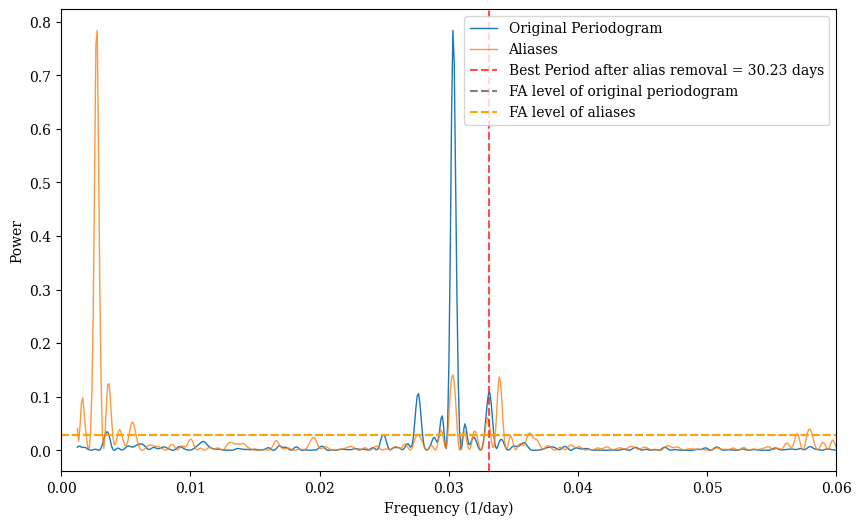

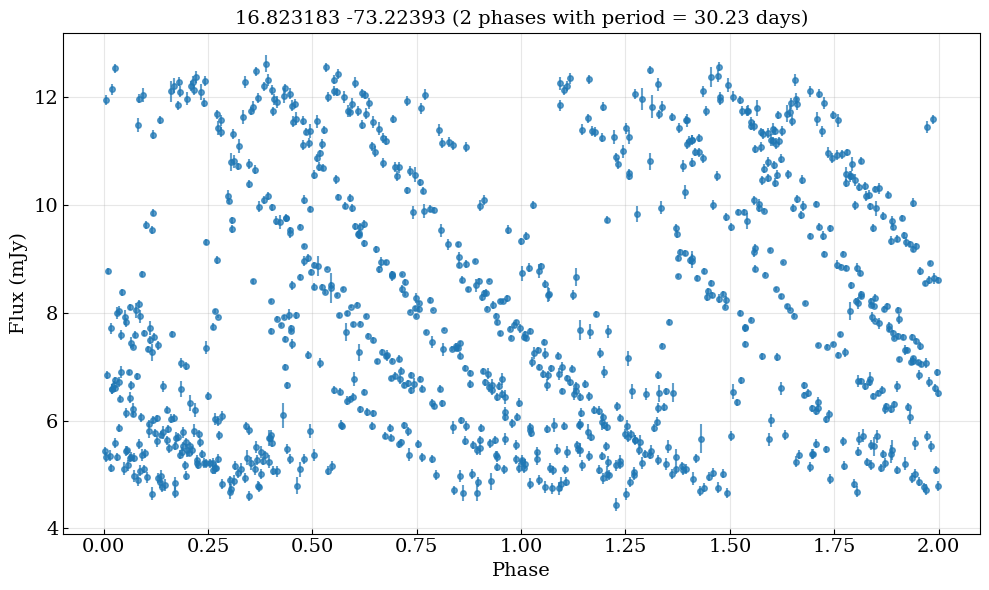

Average scatter (amplitude) per 10 point phase bin: 5.953 mJy
FAL: 0.02787519, Alias FAL: 0.02787519
Alias false alarm probability: 0.000e+00
Best frequency: 0.030320 1/day, Best period: 32.98 days, Max power: 0.784, False alarm probability: 0.000e+00
False alarm level for 1.0%: 2.788e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


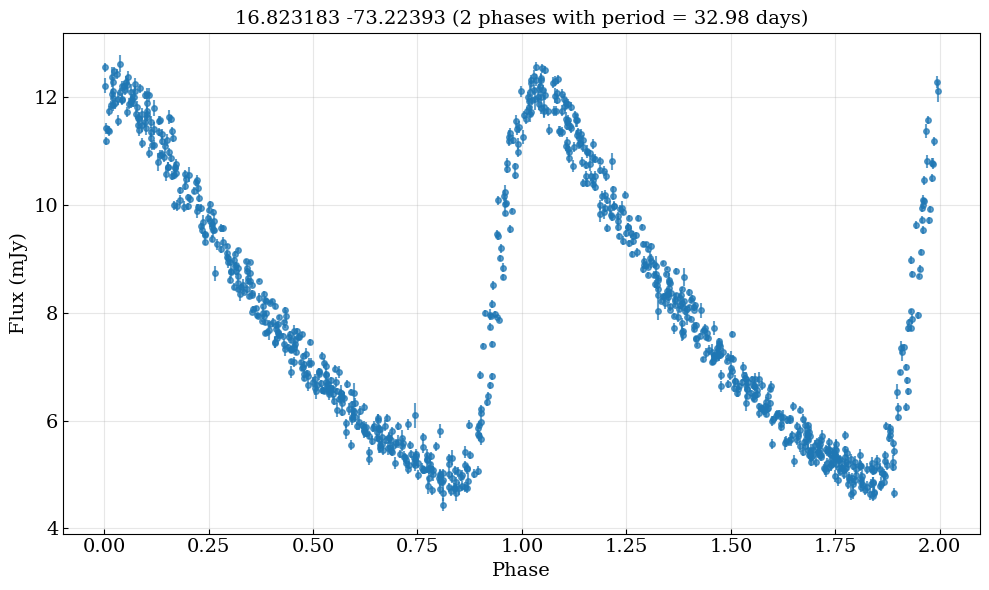

Average scatter (amplitude) per 10 point phase bin: 0.933 mJy
Target 341 
FAL: 0.02786790, Alias FAL: 0.02786790
Alias false alarm probability: 1.336e-281
Best frequency: 0.032470 1/day, Best period: 30.80 days, Max power: 0.121, False alarm probability: 8.800e-24
False alarm level for 1.0%: 2.787e-02


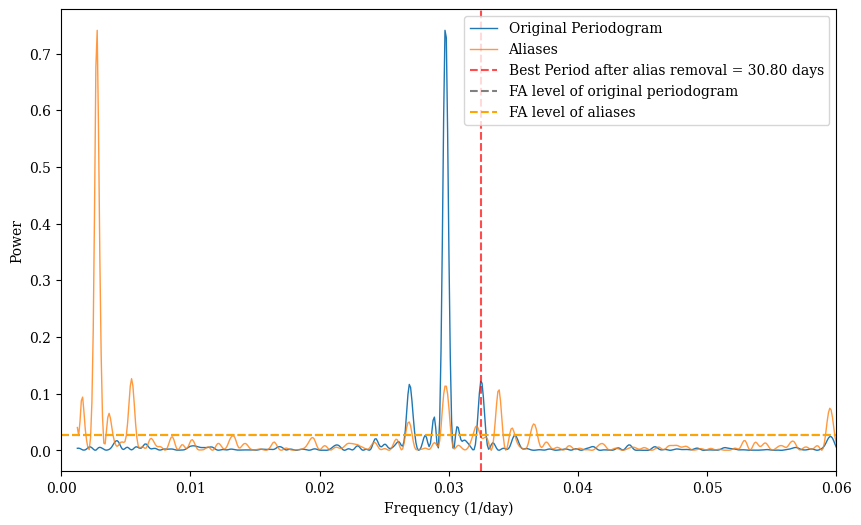

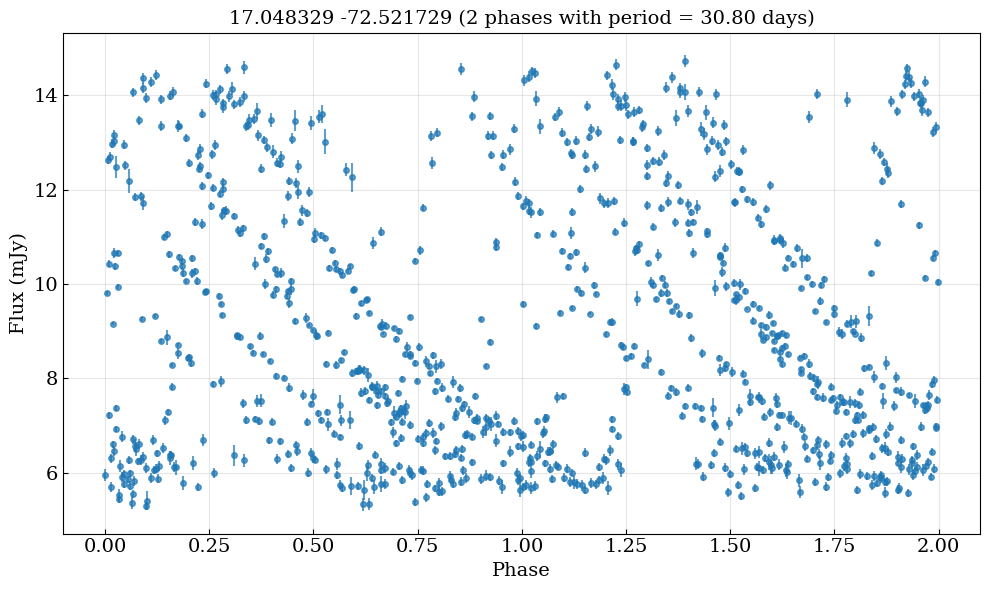

Average scatter (amplitude) per 10 point phase bin: 6.470 mJy
FAL: 0.02786790, Alias FAL: 0.02786790
Alias false alarm probability: 1.336e-281
Best frequency: 0.029706 1/day, Best period: 33.66 days, Max power: 0.741, False alarm probability: 1.336e-281
False alarm level for 1.0%: 2.787e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


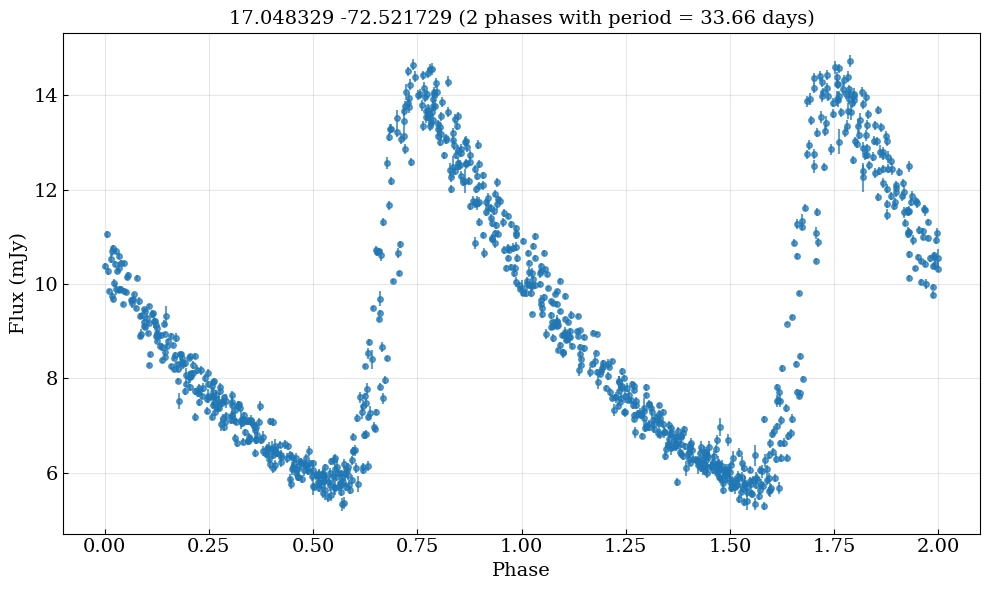

Average scatter (amplitude) per 10 point phase bin: 1.384 mJy
Target 384 
FAL: 0.02533597, Alias FAL: 0.02533597
Alias false alarm probability: 4.451e-255
Best frequency: 0.032419 1/day, Best period: 30.85 days, Max power: 0.098, False alarm probability: 9.383e-21
False alarm level for 1.0%: 2.534e-02


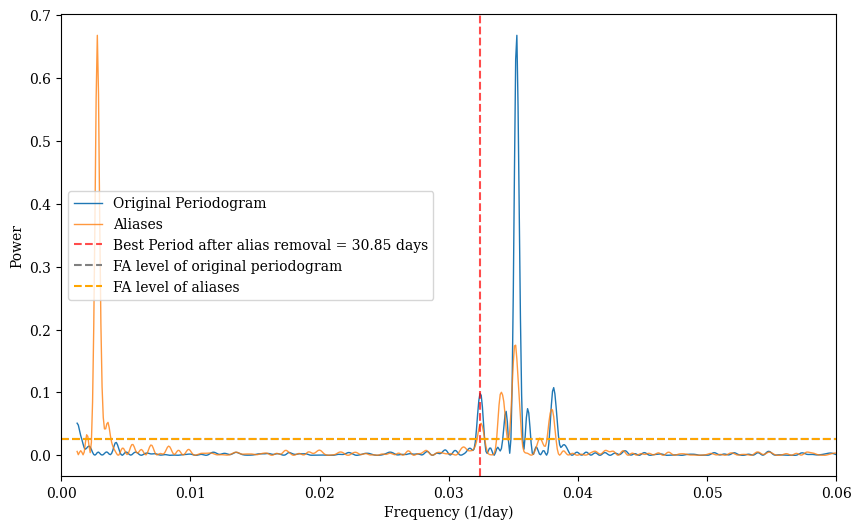

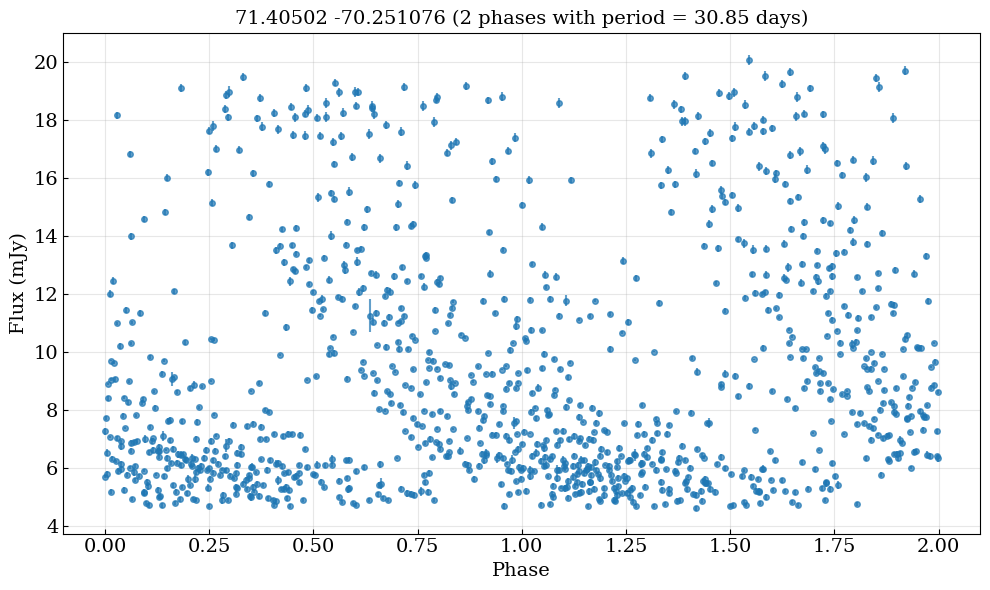

Average scatter (amplitude) per 10 point phase bin: 10.583 mJy
FAL: 0.02533597, Alias FAL: 0.02533597
Alias false alarm probability: 4.451e-255
Best frequency: 0.035271 1/day, Best period: 28.35 days, Max power: 0.668, False alarm probability: 4.451e-255
False alarm level for 1.0%: 2.534e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


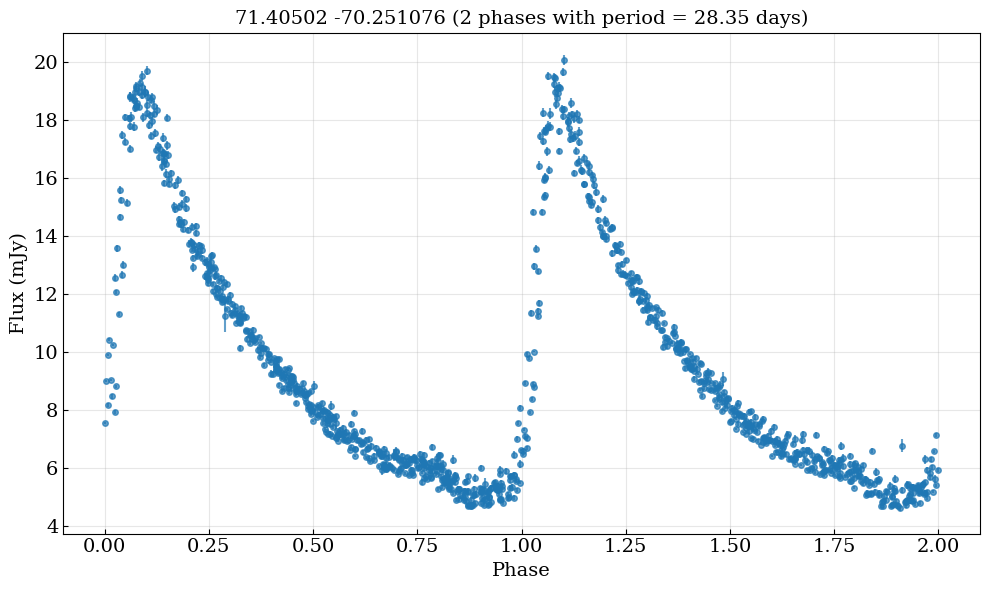

Average scatter (amplitude) per 10 point phase bin: 1.358 mJy
Target 394 
FAL: 0.02534790, Alias FAL: 0.02534790
Alias false alarm probability: 2.300e-254
Best frequency: 0.070880 1/day, Best period: 14.11 days, Max power: 0.048, False alarm probability: 5.002e-08
False alarm level for 1.0%: 2.535e-02


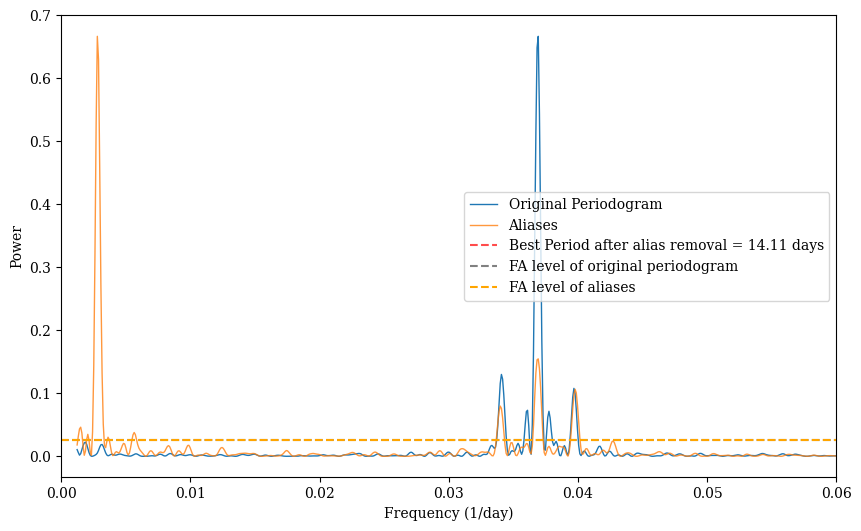

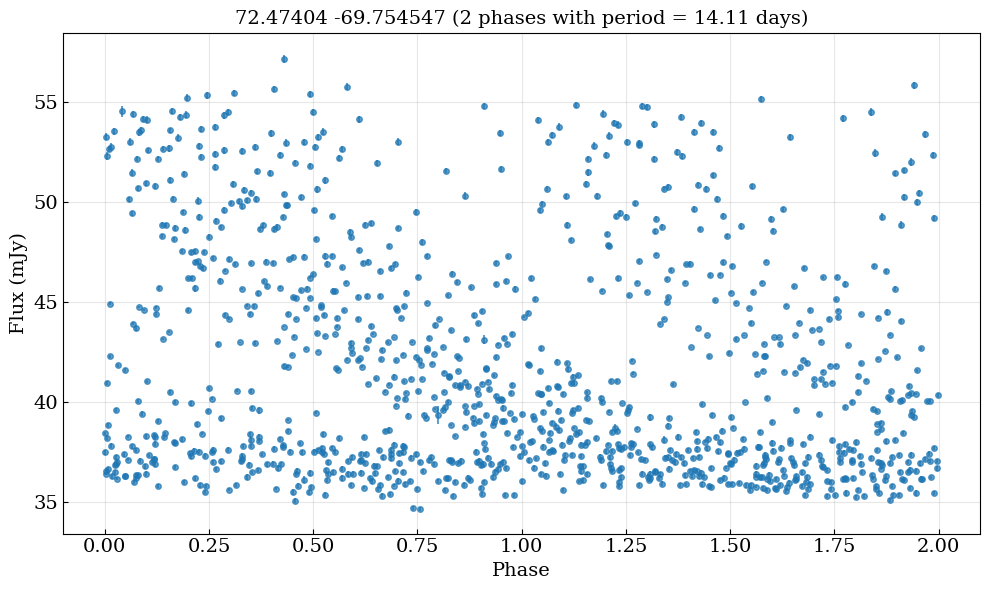

Average scatter (amplitude) per 10 point phase bin: 14.743 mJy
FAL: 0.02534790, Alias FAL: 0.02534790
Alias false alarm probability: 2.300e-254
Best frequency: 0.036927 1/day, Best period: 27.08 days, Max power: 0.667, False alarm probability: 2.300e-254
False alarm level for 1.0%: 2.535e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


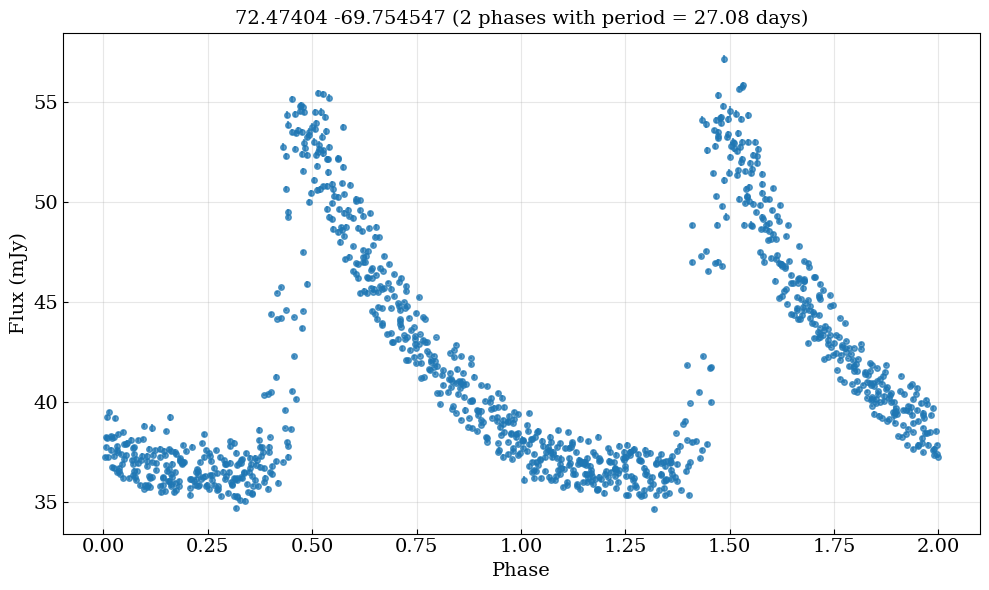

Average scatter (amplitude) per 10 point phase bin: 4.085 mJy
Target 395 
FAL: 0.02535686, Alias FAL: 0.02535686
Alias false alarm probability: 8.853e-223
Best frequency: 0.039688 1/day, Best period: 25.20 days, Max power: 0.107, False alarm probability: 4.682e-23
False alarm level for 1.0%: 2.536e-02


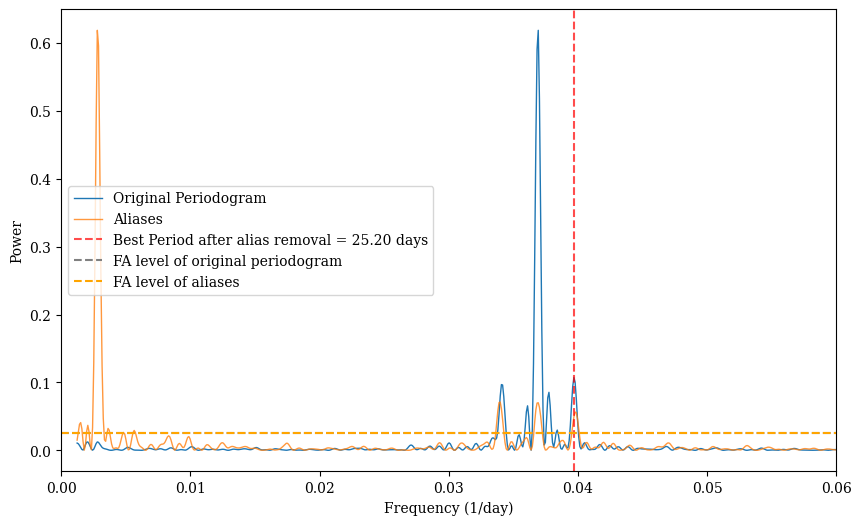

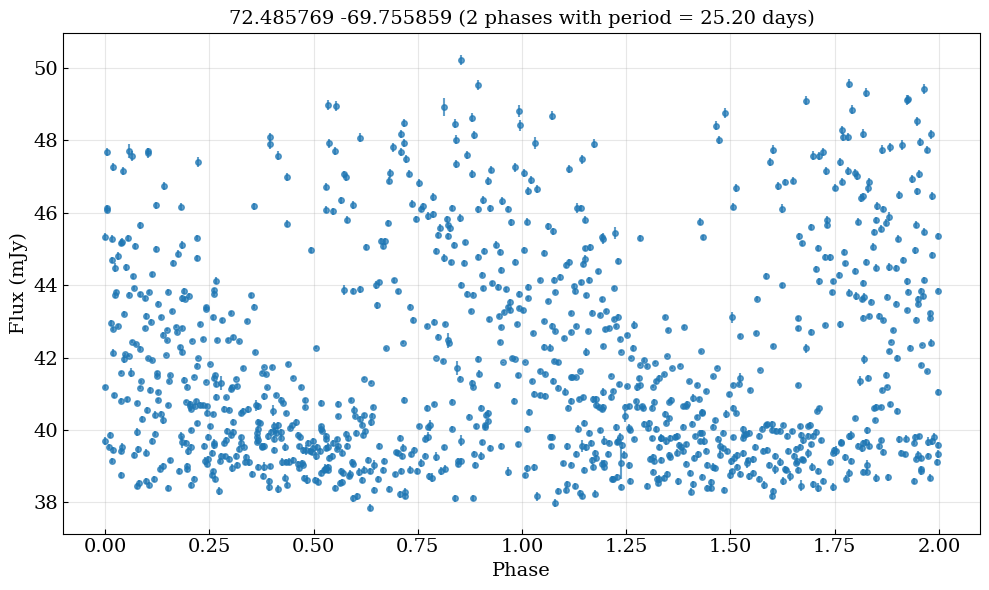

Average scatter (amplitude) per 10 point phase bin: 7.365 mJy
FAL: 0.02535686, Alias FAL: 0.02535686
Alias false alarm probability: 8.853e-223
Best frequency: 0.036927 1/day, Best period: 27.08 days, Max power: 0.619, False alarm probability: 8.853e-223
False alarm level for 1.0%: 2.536e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


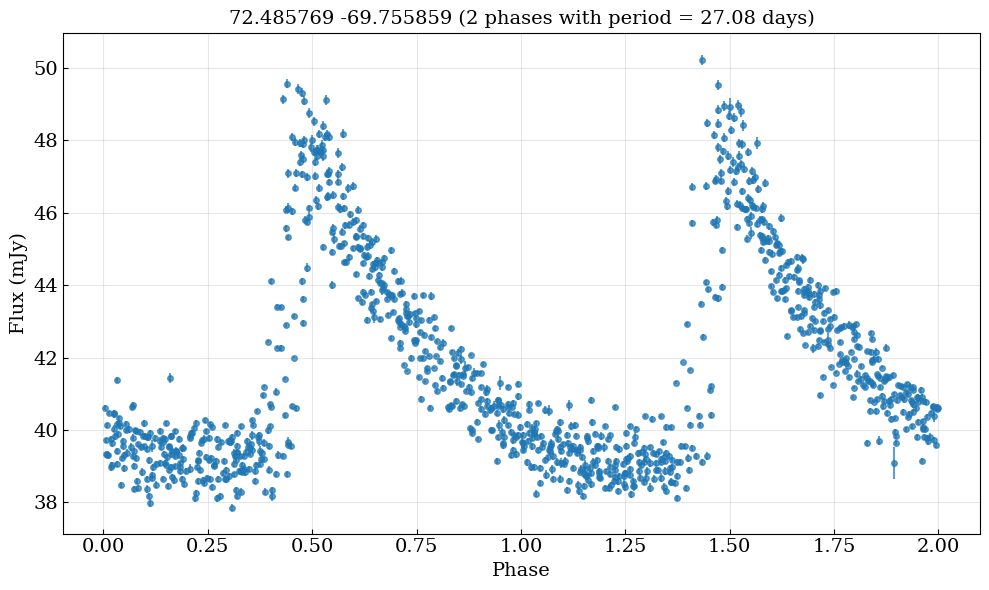

Average scatter (amplitude) per 10 point phase bin: 2.596 mJy
Target 396 
FAL: 0.02537334, Alias FAL: 0.02537334
Alias false alarm probability: 0.000e+00
Best frequency: 0.047693 1/day, Best period: 20.97 days, Max power: 0.102, False alarm probability: 1.111e-21
False alarm level for 1.0%: 2.537e-02


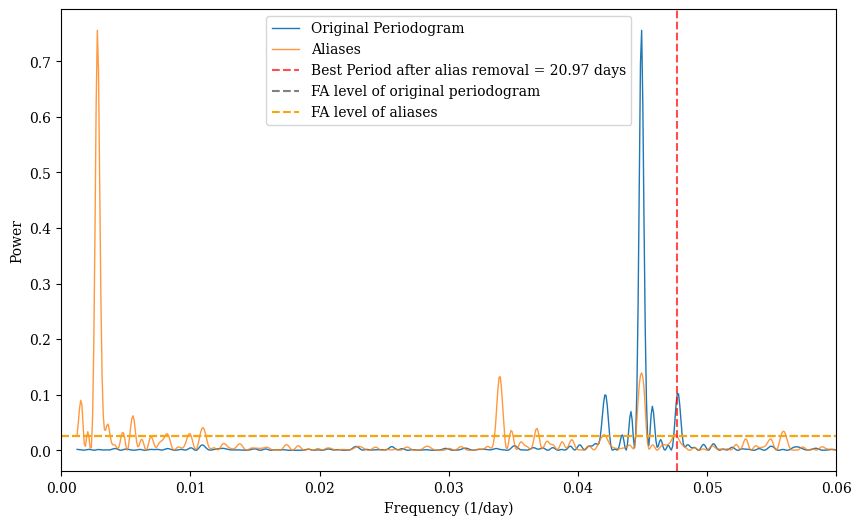

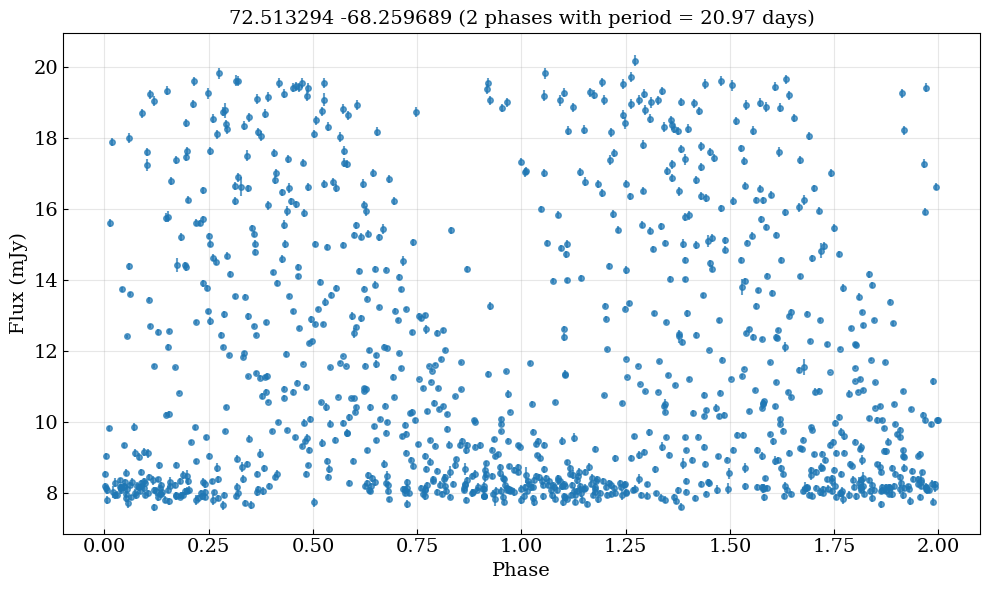

Average scatter (amplitude) per 10 point phase bin: 8.894 mJy
FAL: 0.02537334, Alias FAL: 0.02537334
Alias false alarm probability: 0.000e+00
Best frequency: 0.044932 1/day, Best period: 22.26 days, Max power: 0.756, False alarm probability: 0.000e+00
False alarm level for 1.0%: 2.537e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


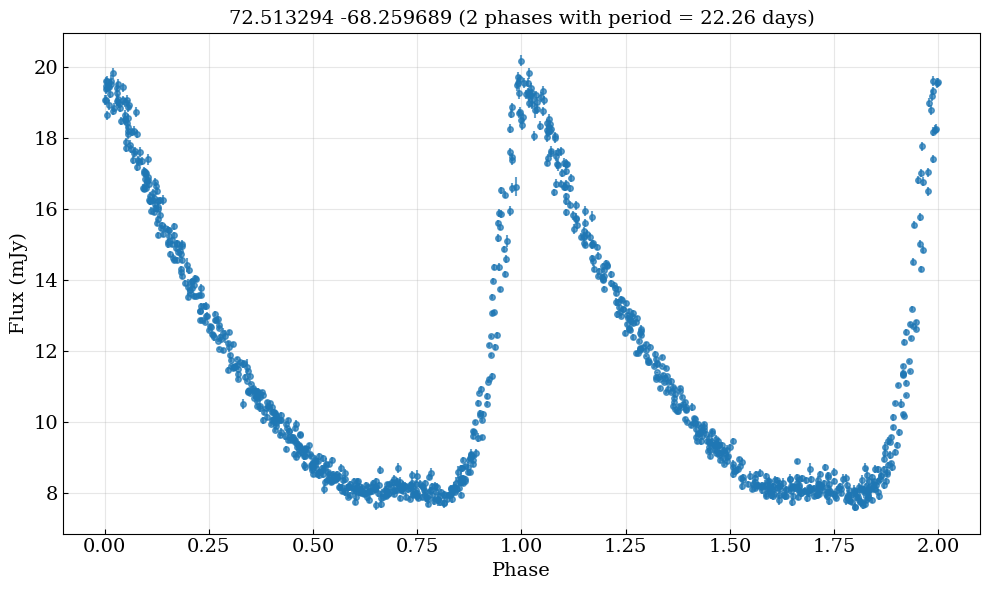

Average scatter (amplitude) per 10 point phase bin: 1.077 mJy
Target 427 
FAL: 0.02534752, Alias FAL: 0.02534752
Alias false alarm probability: 1.183e-252
Best frequency: 0.026254 1/day, Best period: 38.09 days, Max power: 0.104, False alarm probability: 3.480e-22
False alarm level for 1.0%: 2.535e-02


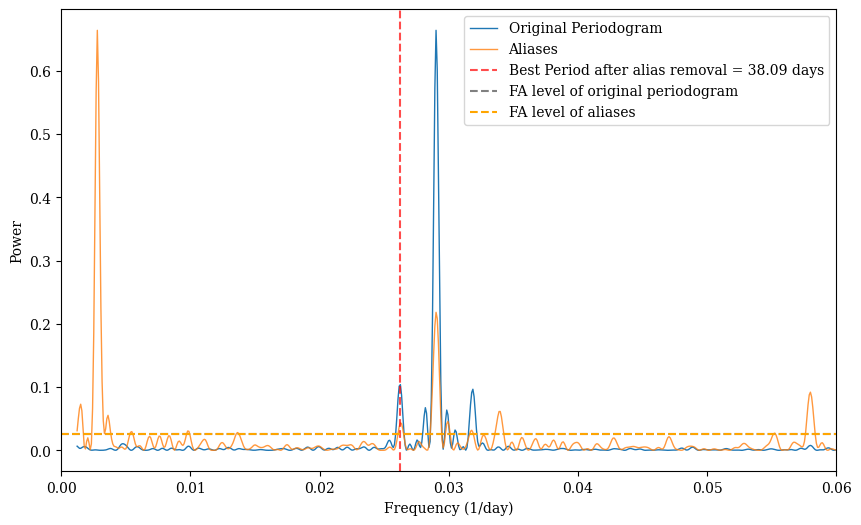

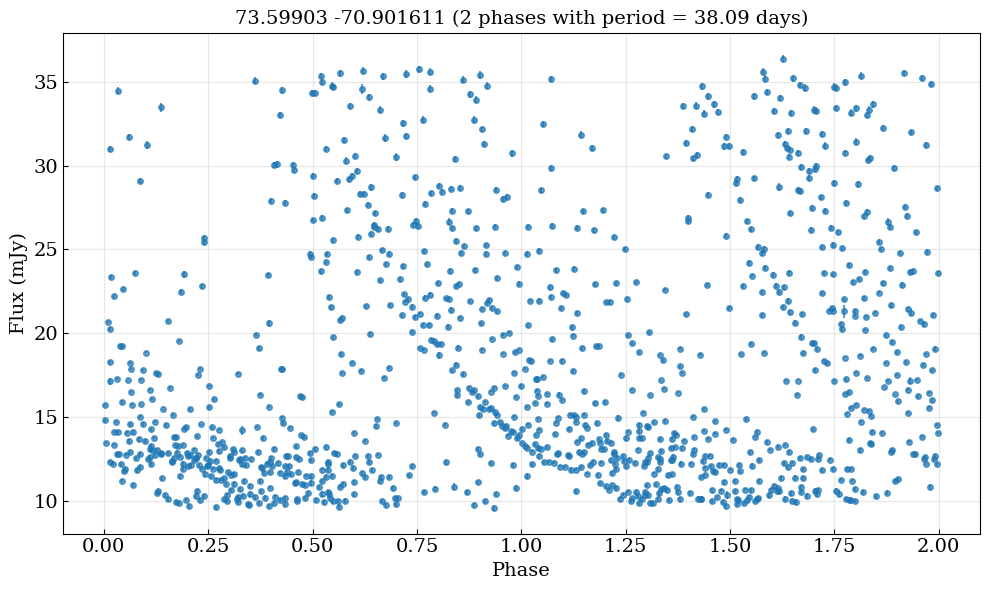

Average scatter (amplitude) per 10 point phase bin: 18.132 mJy
FAL: 0.02534752, Alias FAL: 0.02534752
Alias false alarm probability: 1.183e-252
Best frequency: 0.029014 1/day, Best period: 34.47 days, Max power: 0.664, False alarm probability: 1.183e-252
False alarm level for 1.0%: 2.535e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


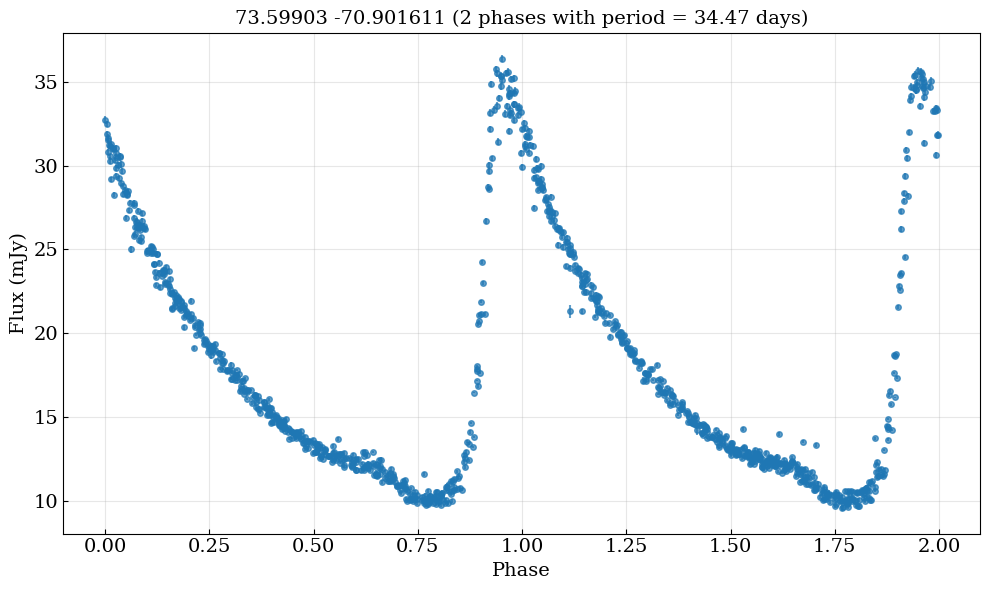

Average scatter (amplitude) per 10 point phase bin: 1.832 mJy
Target 436 
FAL: 0.01483239, Alias FAL: 0.01483239
Alias false alarm probability: 0.000e+00
Best frequency: 0.036307 1/day, Best period: 27.54 days, Max power: 0.140, False alarm probability: 2.293e-59
False alarm level for 1.0%: 1.483e-02


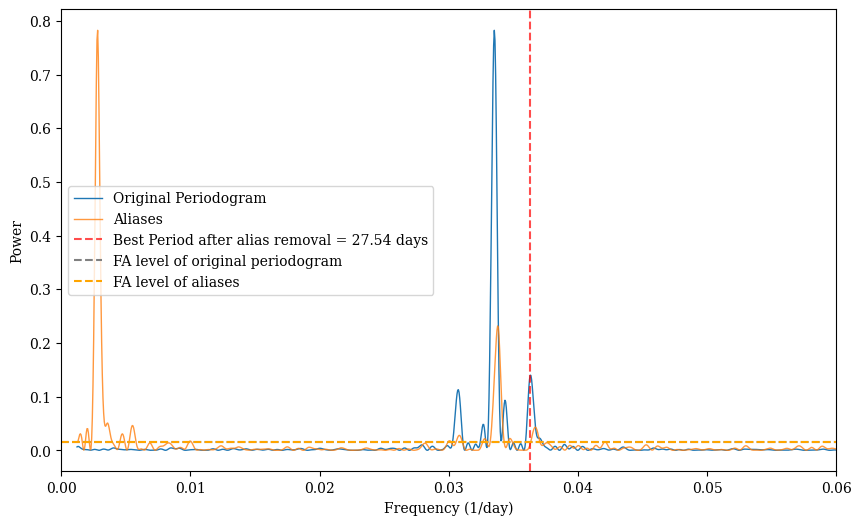

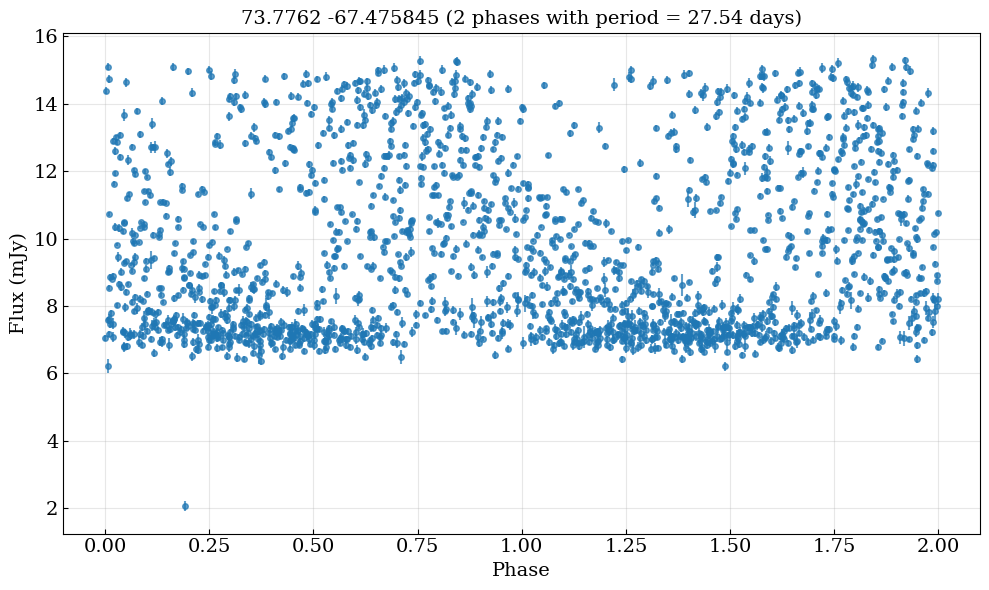

Average scatter (amplitude) per 10 point phase bin: 6.279 mJy
FAL: 0.01483239, Alias FAL: 0.01483239
Alias false alarm probability: 0.000e+00
Best frequency: 0.033525 1/day, Best period: 29.83 days, Max power: 0.782, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.483e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


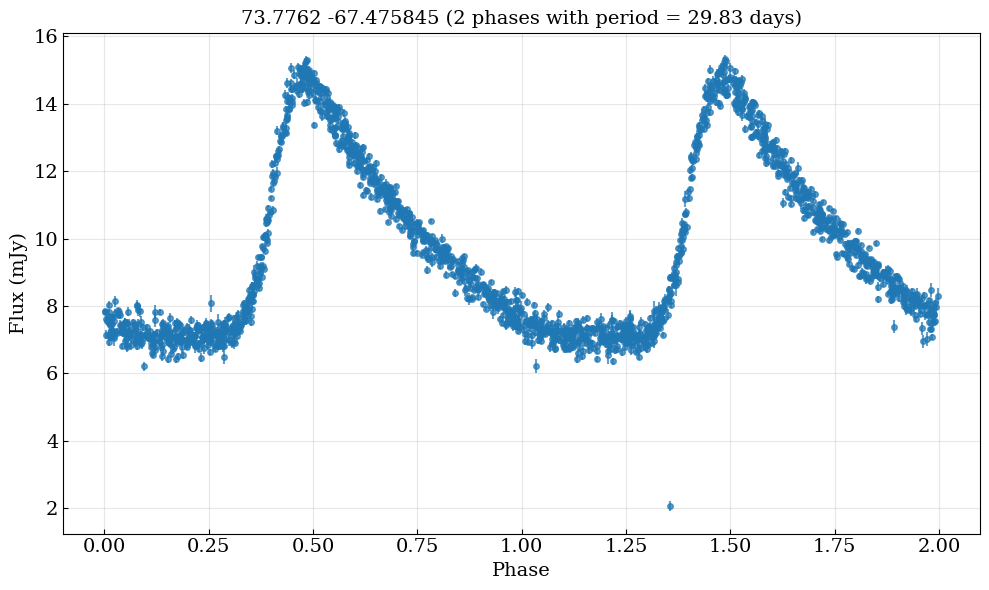

Average scatter (amplitude) per 10 point phase bin: 0.950 mJy
Target 449 
FAL: 0.02539741, Alias FAL: 0.02539741
Alias false alarm probability: 0.000e+00
Best frequency: 0.030118 1/day, Best period: 33.20 days, Max power: 0.127, False alarm probability: 3.069e-28
False alarm level for 1.0%: 2.540e-02


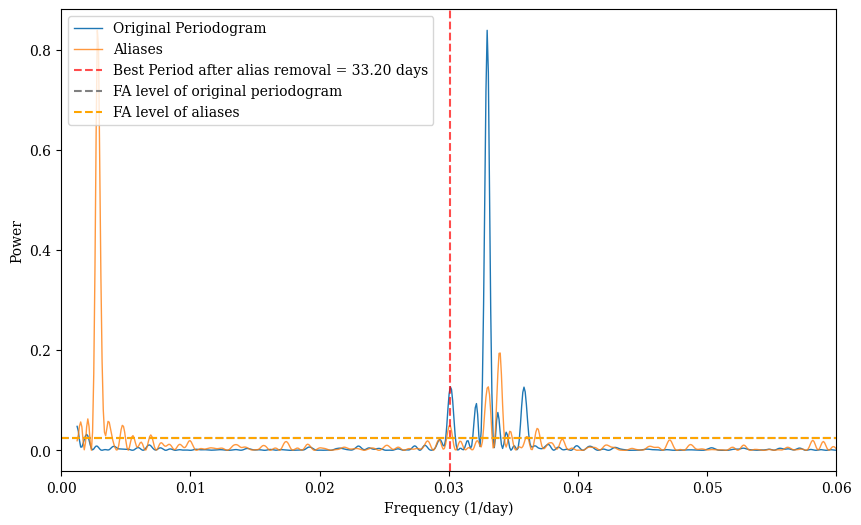

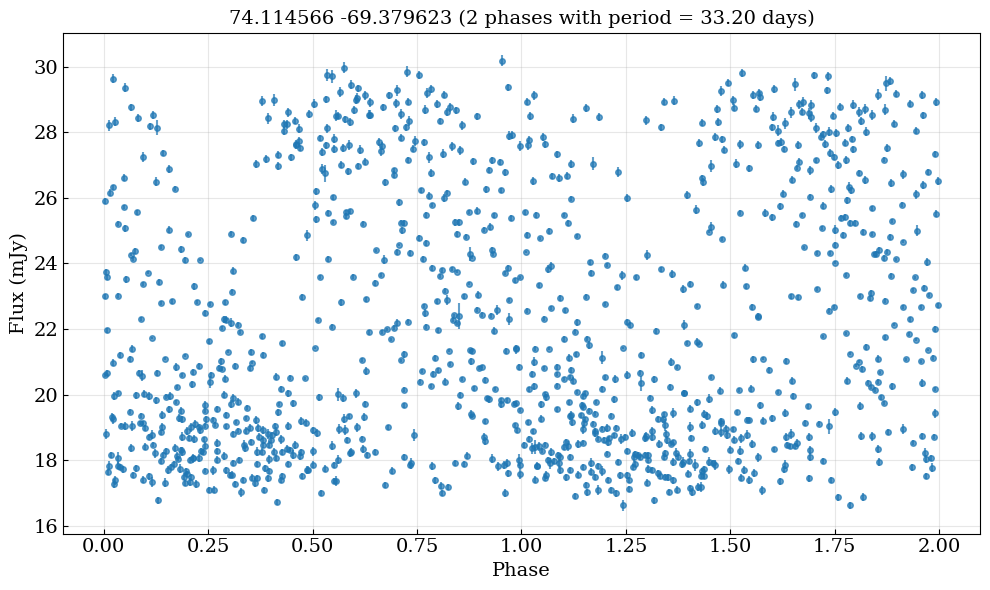

Average scatter (amplitude) per 10 point phase bin: 9.971 mJy
FAL: 0.02539741, Alias FAL: 0.02539741
Alias false alarm probability: 0.000e+00
Best frequency: 0.032971 1/day, Best period: 30.33 days, Max power: 0.840, False alarm probability: 0.000e+00
False alarm level for 1.0%: 2.540e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


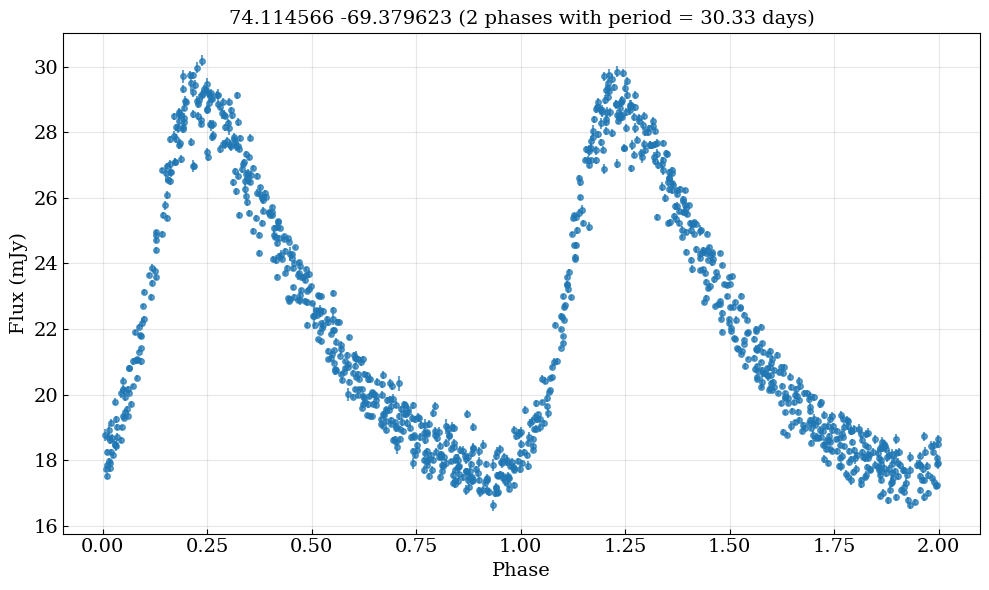

Average scatter (amplitude) per 10 point phase bin: 1.721 mJy
Target 476 
FAL: 0.02535274, Alias FAL: 0.02535274
Alias false alarm probability: 3.248e-274
Best frequency: 0.029934 1/day, Best period: 33.41 days, Max power: 0.108, False alarm probability: 3.202e-23
False alarm level for 1.0%: 2.535e-02


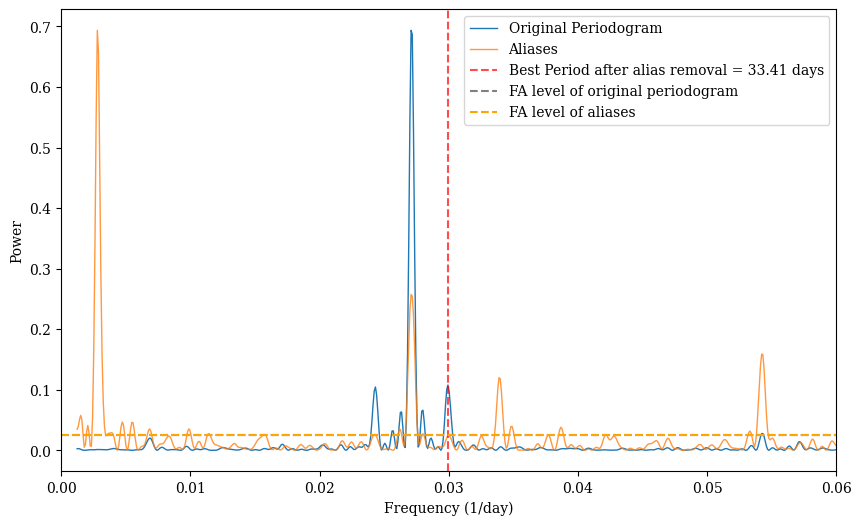

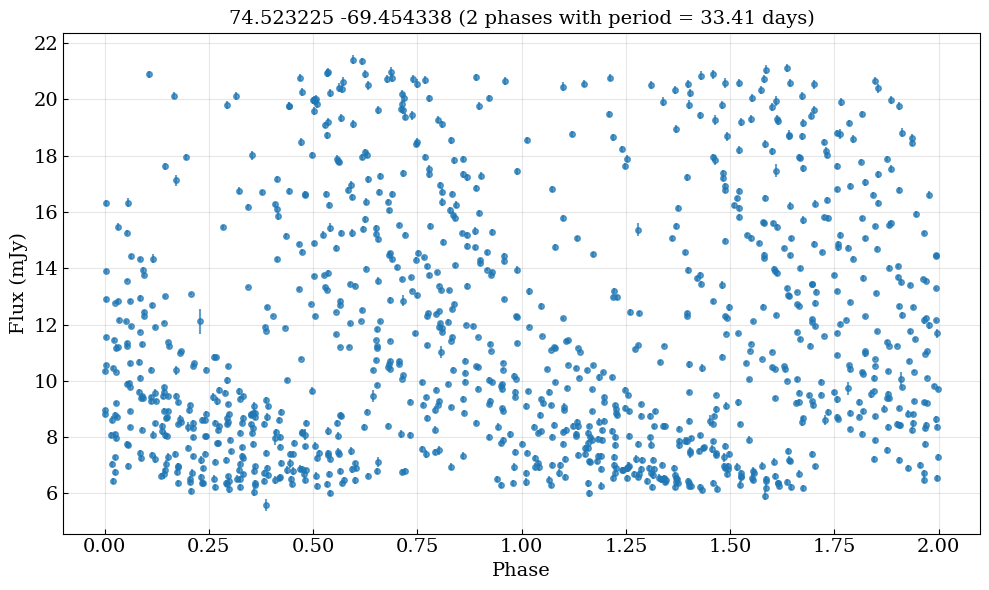

Average scatter (amplitude) per 10 point phase bin: 10.641 mJy
FAL: 0.02535274, Alias FAL: 0.02535274
Alias false alarm probability: 3.248e-274
Best frequency: 0.027082 1/day, Best period: 36.92 days, Max power: 0.694, False alarm probability: 3.248e-274
False alarm level for 1.0%: 2.535e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


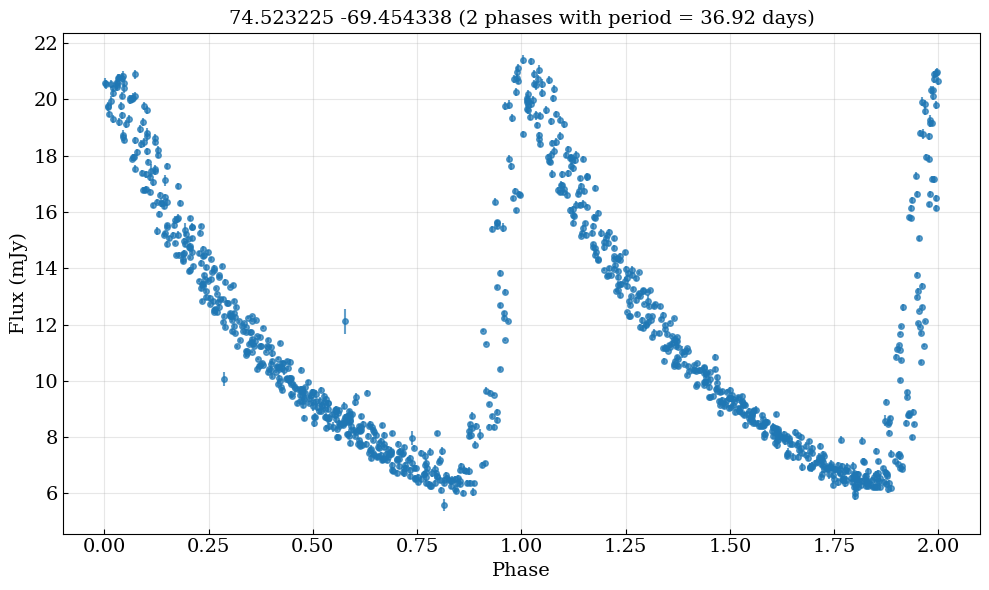

Average scatter (amplitude) per 10 point phase bin: 2.150 mJy
Target 480 
FAL: 0.02537681, Alias FAL: 0.02537681
Alias false alarm probability: 2.810e-257
Best frequency: 0.025150 1/day, Best period: 39.76 days, Max power: 0.101, False alarm probability: 1.566e-21
False alarm level for 1.0%: 2.538e-02


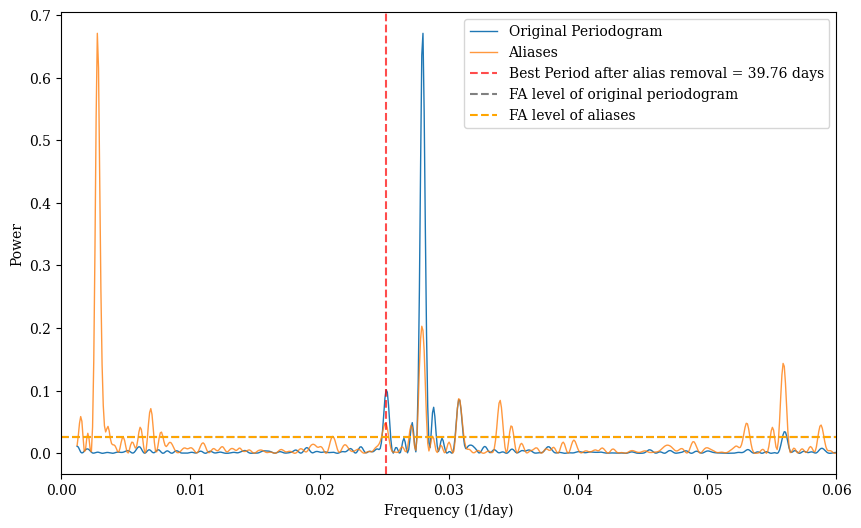

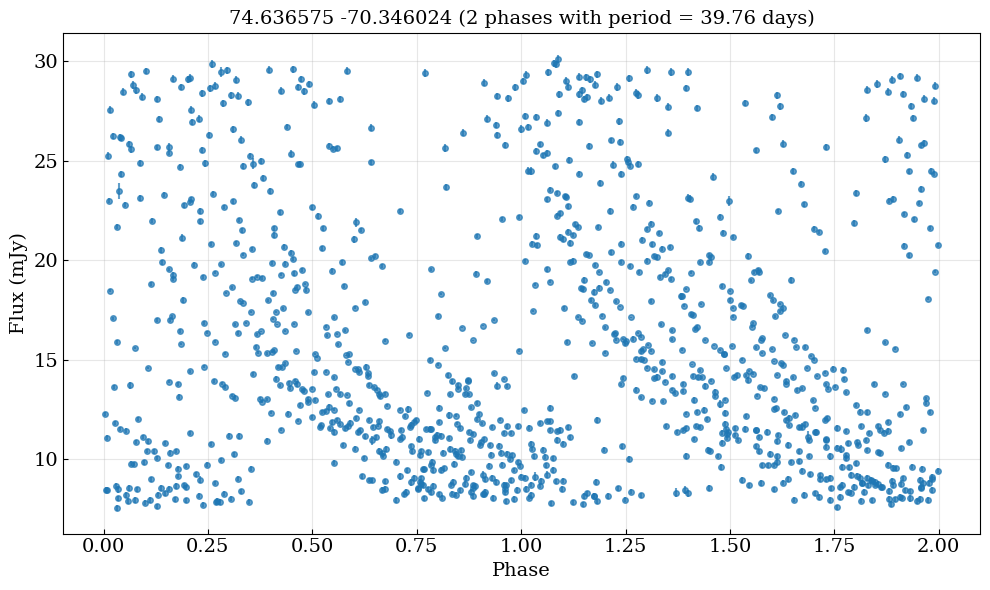

Average scatter (amplitude) per 10 point phase bin: 16.375 mJy
FAL: 0.02537681, Alias FAL: 0.02537681
Alias false alarm probability: 2.810e-257
Best frequency: 0.028002 1/day, Best period: 35.71 days, Max power: 0.671, False alarm probability: 2.810e-257
False alarm level for 1.0%: 2.538e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


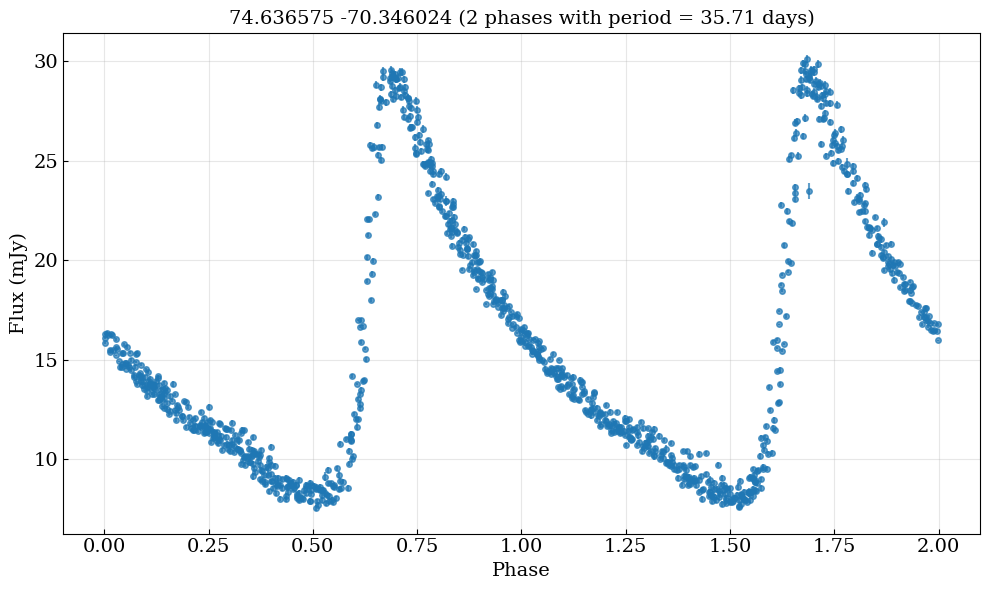

Average scatter (amplitude) per 10 point phase bin: 2.105 mJy
Target 486 
FAL: 0.02536805, Alias FAL: 0.02536805
Alias false alarm probability: 3.657e-260
Best frequency: 0.028646 1/day, Best period: 34.91 days, Max power: 0.124, False alarm probability: 2.029e-27
False alarm level for 1.0%: 2.537e-02


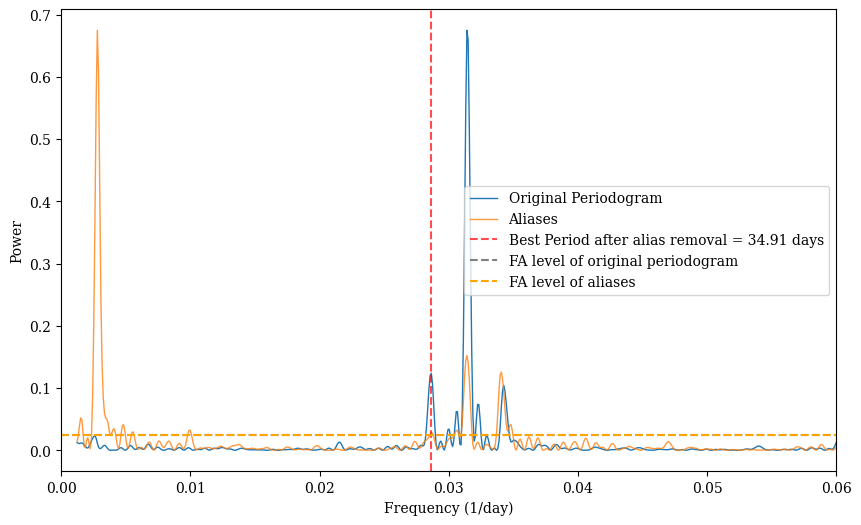

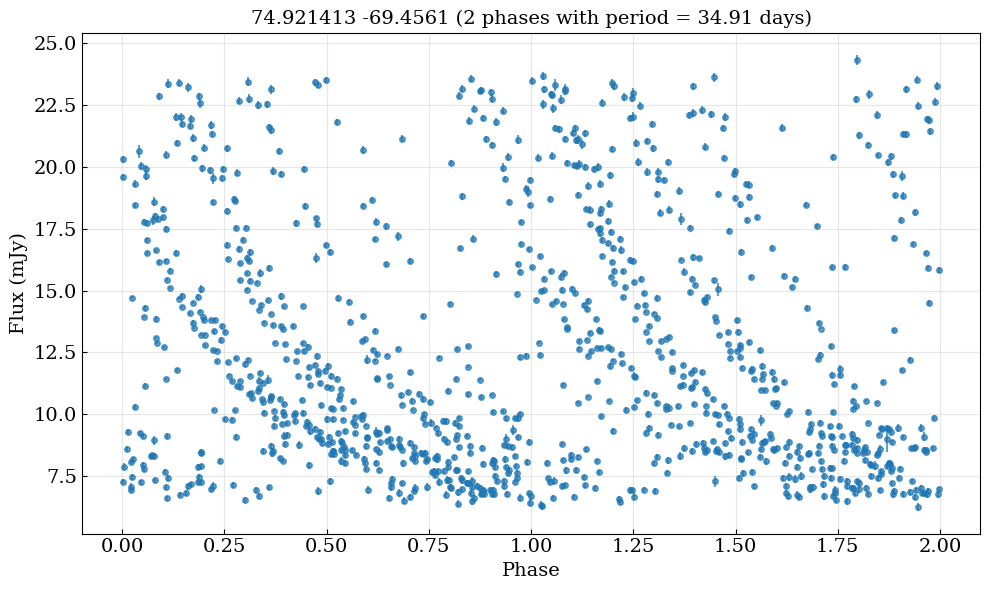

Average scatter (amplitude) per 10 point phase bin: 12.370 mJy
FAL: 0.02536805, Alias FAL: 0.02536805
Alias false alarm probability: 3.657e-260
Best frequency: 0.031407 1/day, Best period: 31.84 days, Max power: 0.675, False alarm probability: 3.657e-260
False alarm level for 1.0%: 2.537e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


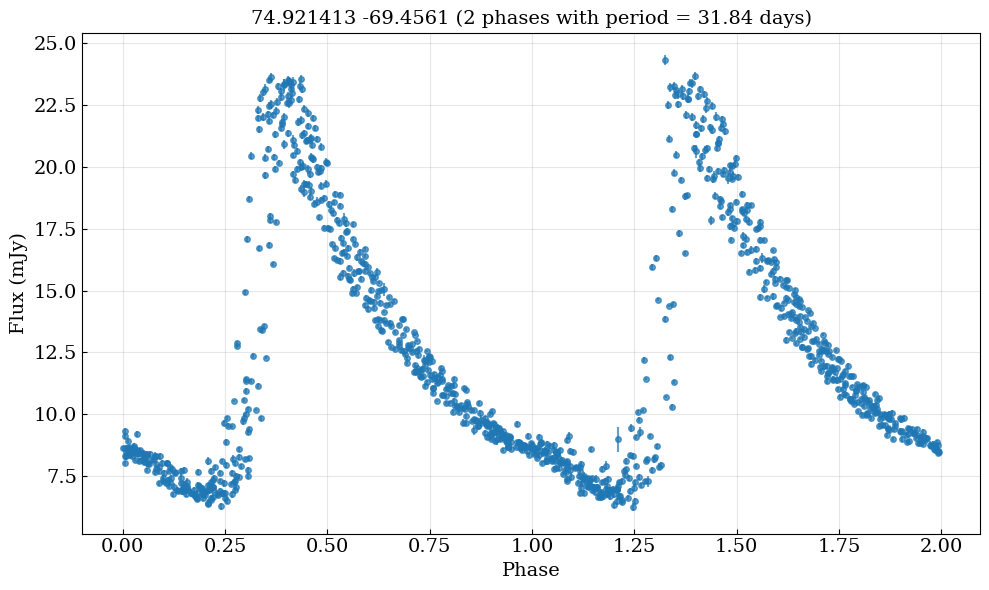

Average scatter (amplitude) per 10 point phase bin: 2.669 mJy
Target 491 
FAL: 0.02533109, Alias FAL: 0.02533109
Alias false alarm probability: 0.000e+00
Best frequency: 0.004631 1/day, Best period: 215.93 days, Max power: 0.110, False alarm probability: 7.460e-24
False alarm level for 1.0%: 2.533e-02


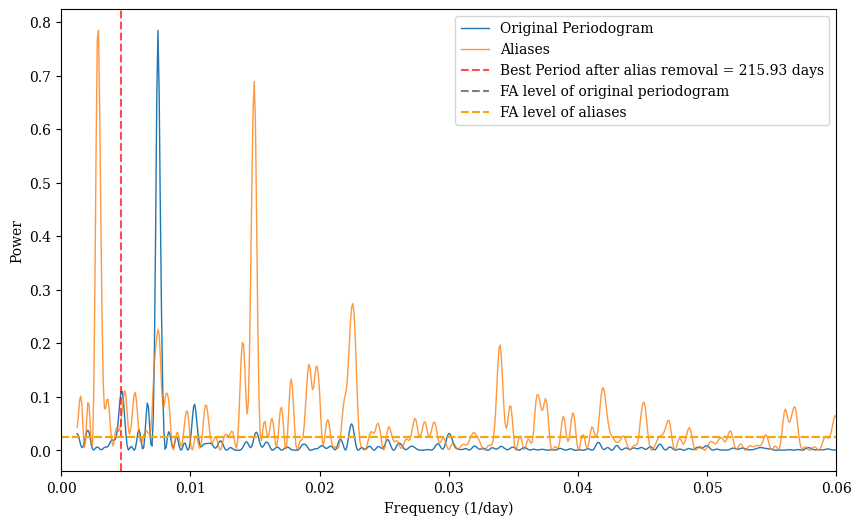

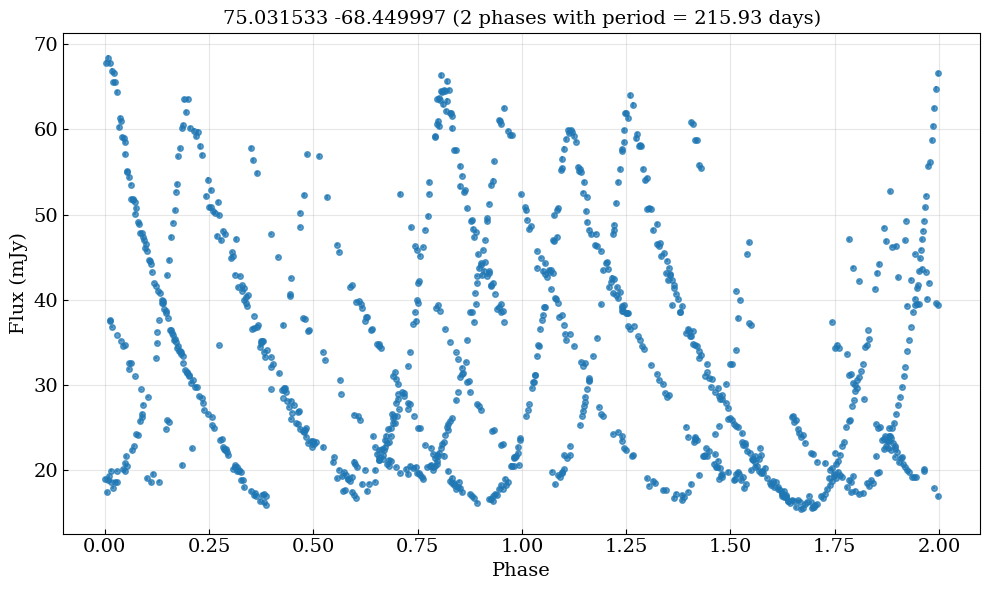

Average scatter (amplitude) per 10 point phase bin: 26.067 mJy
FAL: 0.02533109, Alias FAL: 0.02533109
Alias false alarm probability: 0.000e+00
Best frequency: 0.007483 1/day, Best period: 133.63 days, Max power: 0.784, False alarm probability: 0.000e+00
False alarm level for 1.0%: 2.533e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


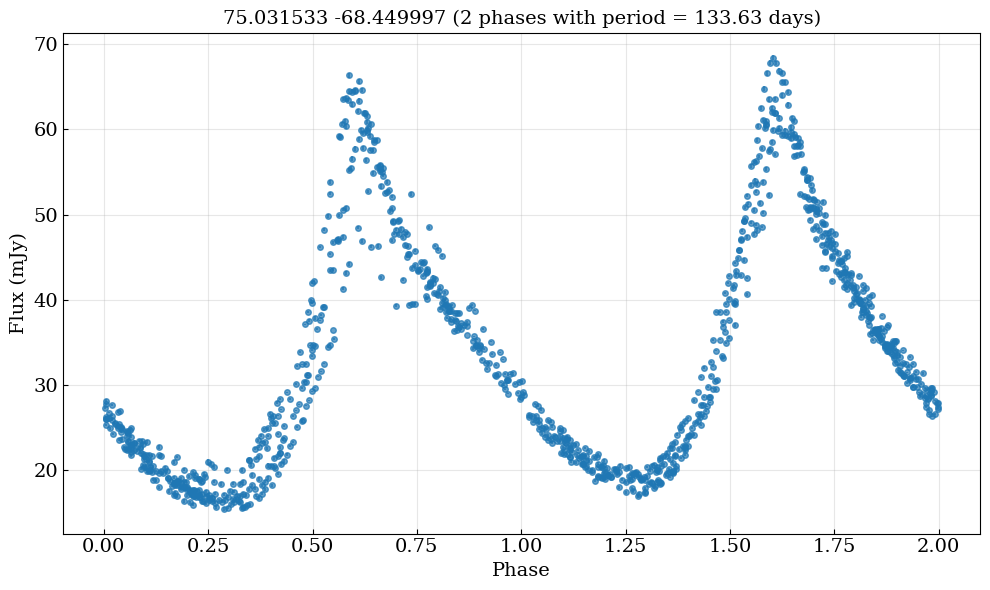

Average scatter (amplitude) per 10 point phase bin: 6.335 mJy
Target 499 
FAL: 0.02474057, Alias FAL: 0.02474057
Alias false alarm probability: 2.131e-283
Best frequency: 0.033067 1/day, Best period: 30.24 days, Max power: 0.122, False alarm probability: 1.063e-27
False alarm level for 1.0%: 2.474e-02


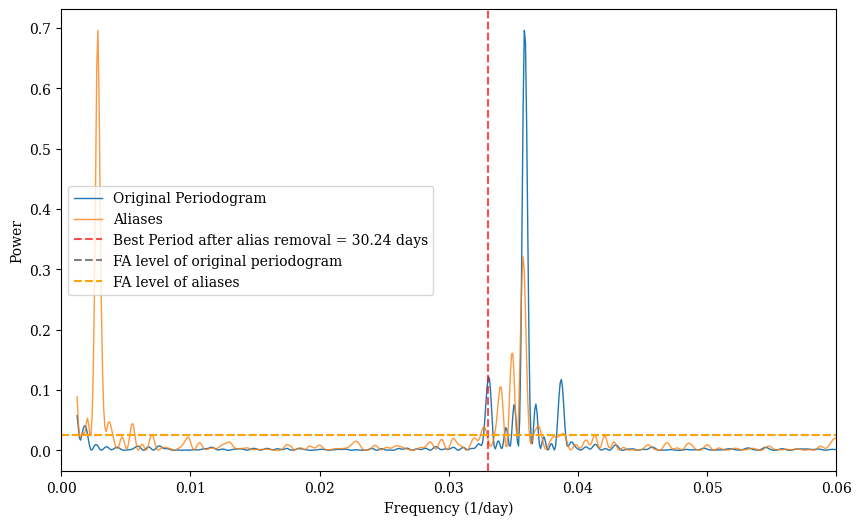

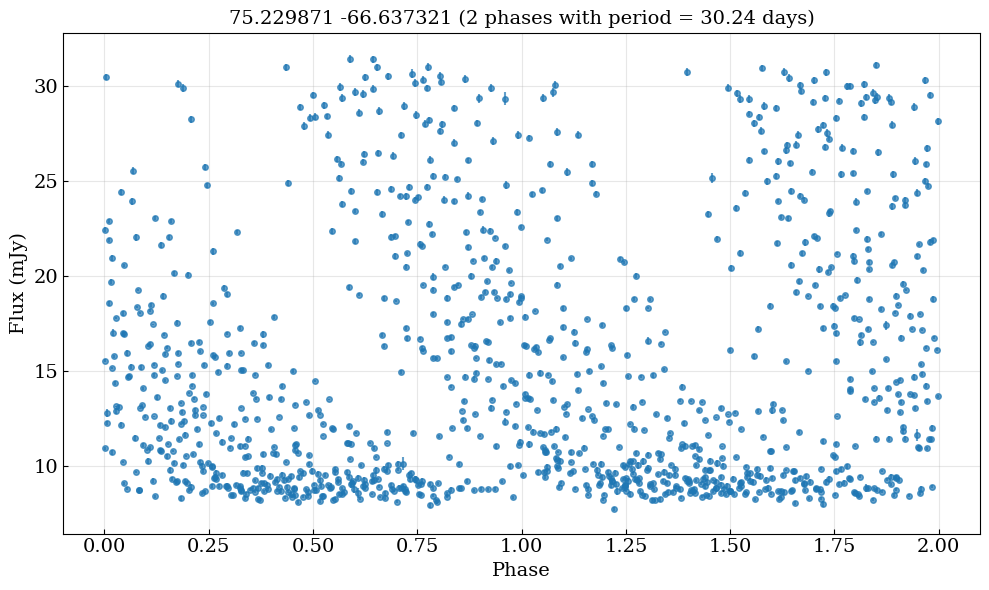

Average scatter (amplitude) per 10 point phase bin: 15.782 mJy
FAL: 0.02474057, Alias FAL: 0.02474057
Alias false alarm probability: 2.131e-283
Best frequency: 0.035848 1/day, Best period: 27.90 days, Max power: 0.696, False alarm probability: 2.131e-283
False alarm level for 1.0%: 2.474e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


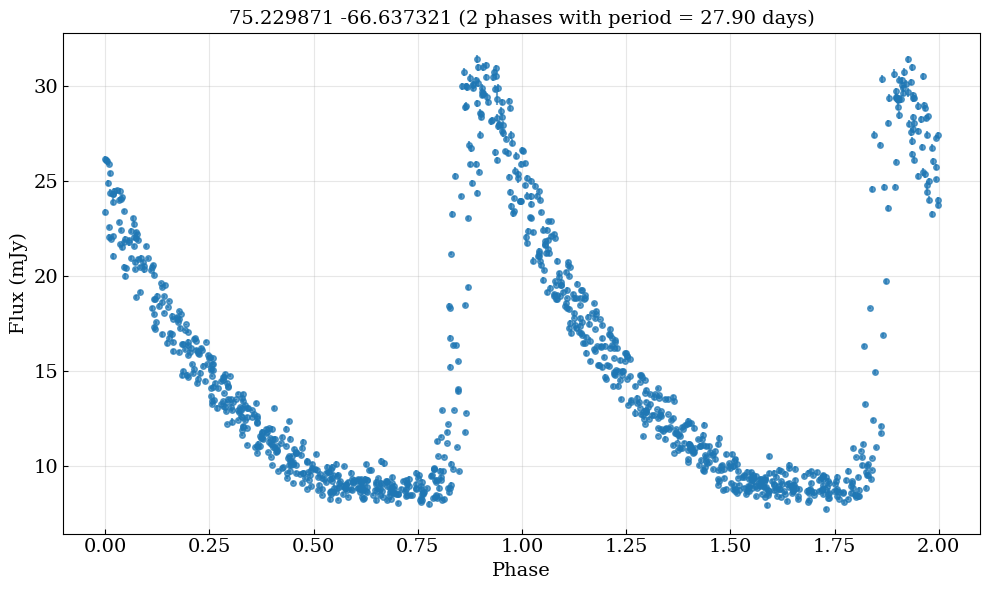

Average scatter (amplitude) per 10 point phase bin: 3.266 mJy
Target 504 
FAL: 0.02534287, Alias FAL: 0.02534287
Alias false alarm probability: 2.022e-06
Best frequency: 0.022389 1/day, Best period: 44.66 days, Max power: 0.029, False alarm probability: 1.194e-03
False alarm level for 1.0%: 2.534e-02


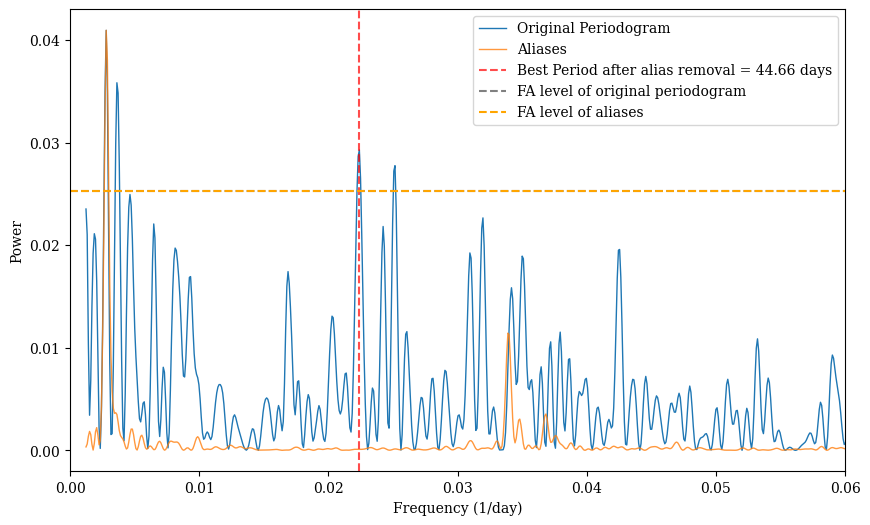

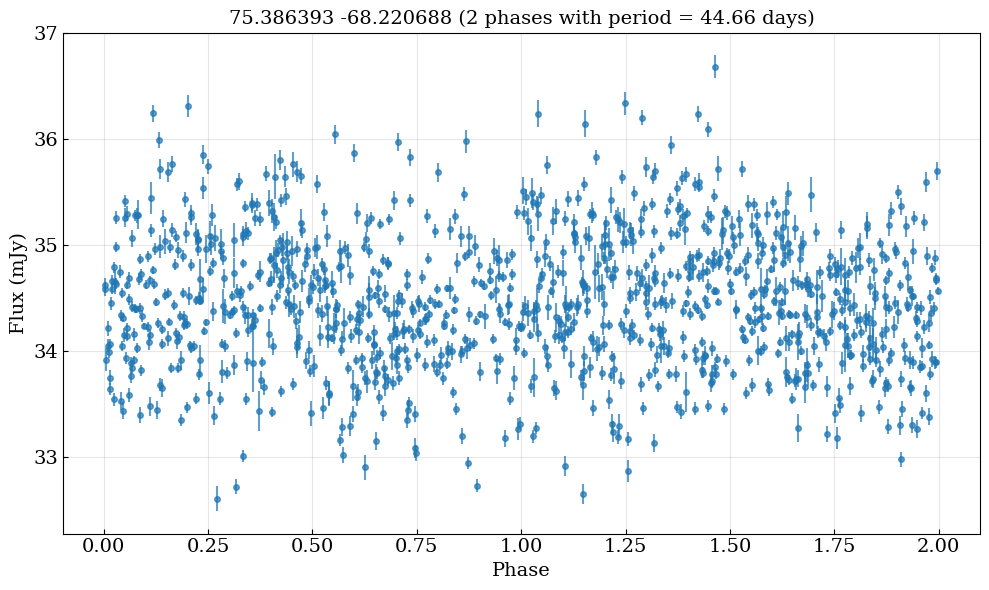

Average scatter (amplitude) per 10 point phase bin: 1.876 mJy
FAL: 0.02534287, Alias FAL: 0.02534287
Alias false alarm probability: 2.022e-06
Best frequency: 0.002791 1/day, Best period: 358.31 days, Max power: 0.041, False alarm probability: 2.022e-06
False alarm level for 1.0%: 2.534e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


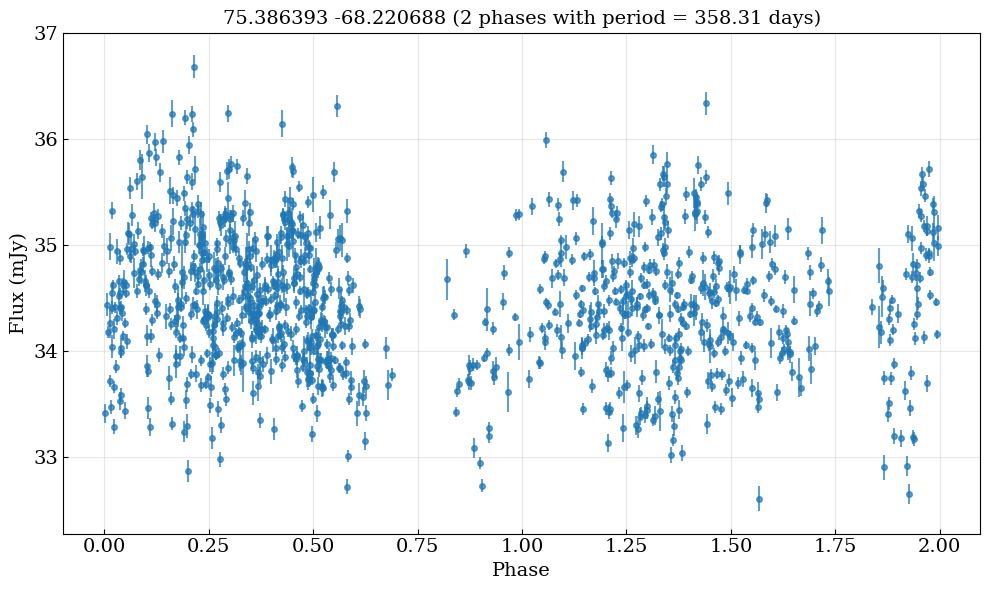

Average scatter (amplitude) per 10 point phase bin: 1.599 mJy
Target 511 
FAL: 0.02479599, Alias FAL: 0.02479599
Alias false alarm probability: 7.344e-272
Best frequency: 0.044459 1/day, Best period: 22.49 days, Max power: 0.092, False alarm probability: 1.362e-19
False alarm level for 1.0%: 2.480e-02


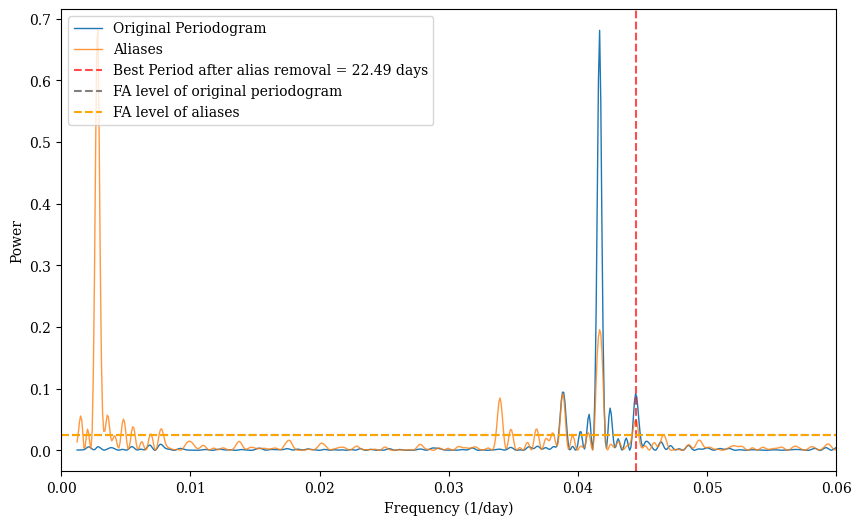

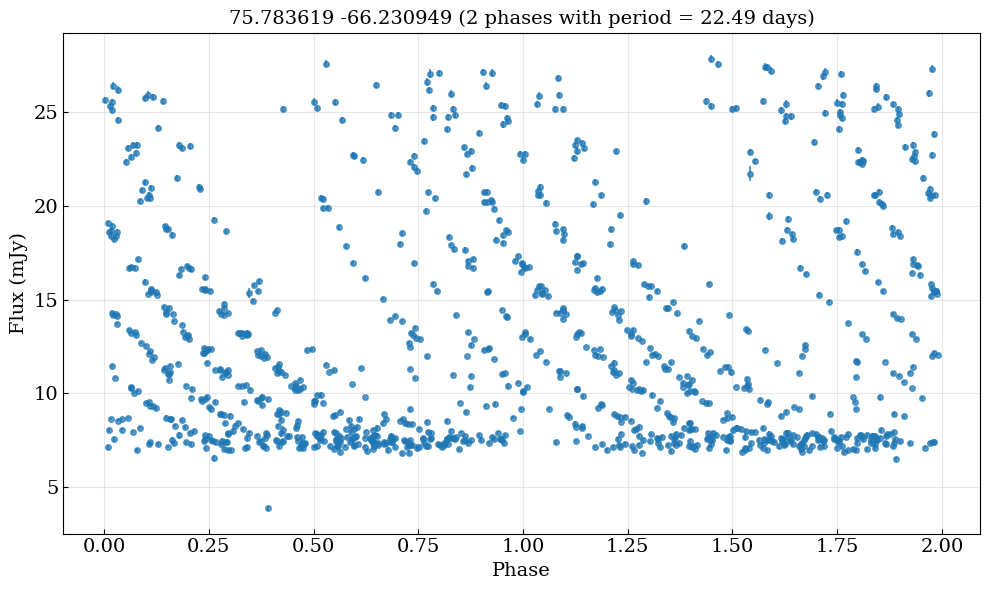

Average scatter (amplitude) per 10 point phase bin: 14.015 mJy
FAL: 0.02479599, Alias FAL: 0.02479599
Alias false alarm probability: 7.344e-272
Best frequency: 0.041678 1/day, Best period: 23.99 days, Max power: 0.681, False alarm probability: 7.344e-272
False alarm level for 1.0%: 2.480e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


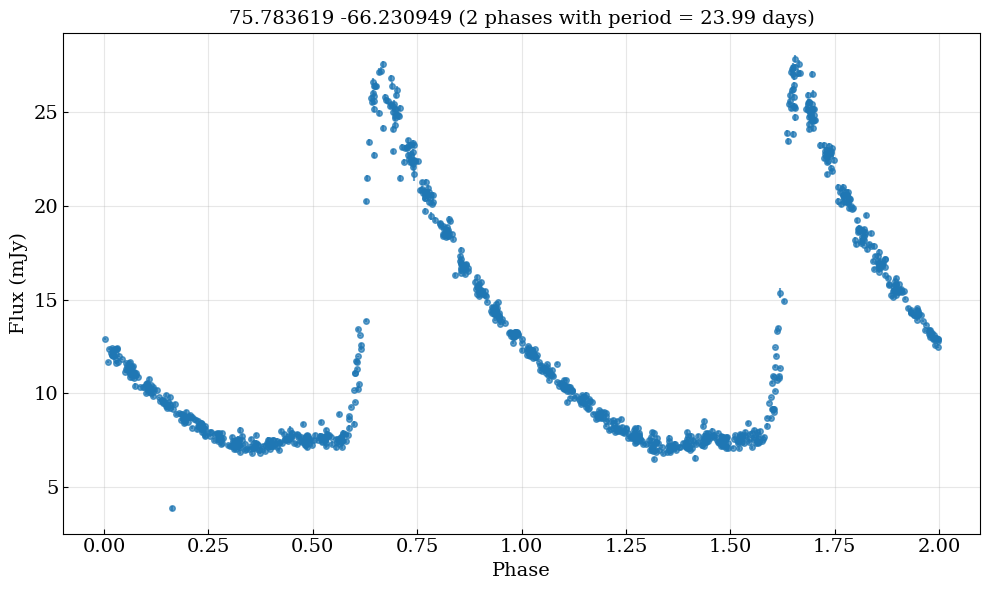

Average scatter (amplitude) per 10 point phase bin: 1.366 mJy
Target 524 
FAL: 0.01342458, Alias FAL: 0.01342458
Alias false alarm probability: 3.223e-27
Best frequency: 0.002652 1/day, Best period: 377.02 days, Max power: 0.022, False alarm probability: 1.681e-06
False alarm level for 1.0%: 1.342e-02


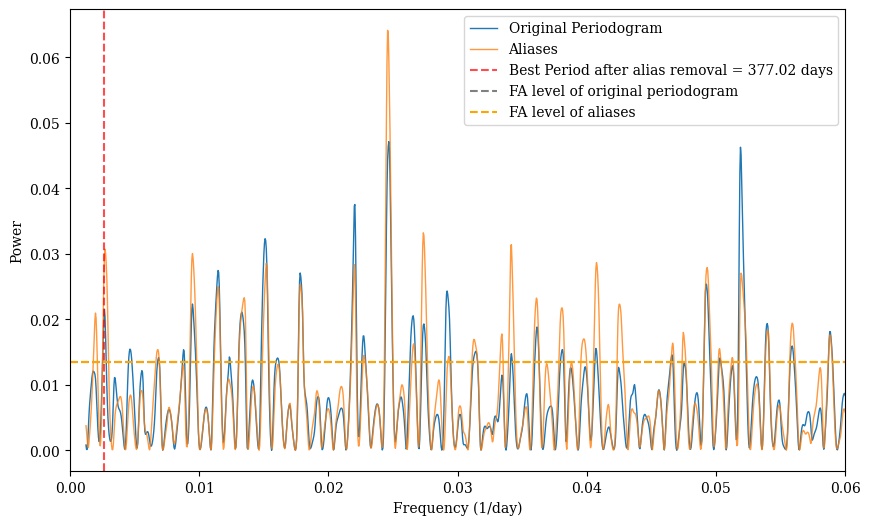

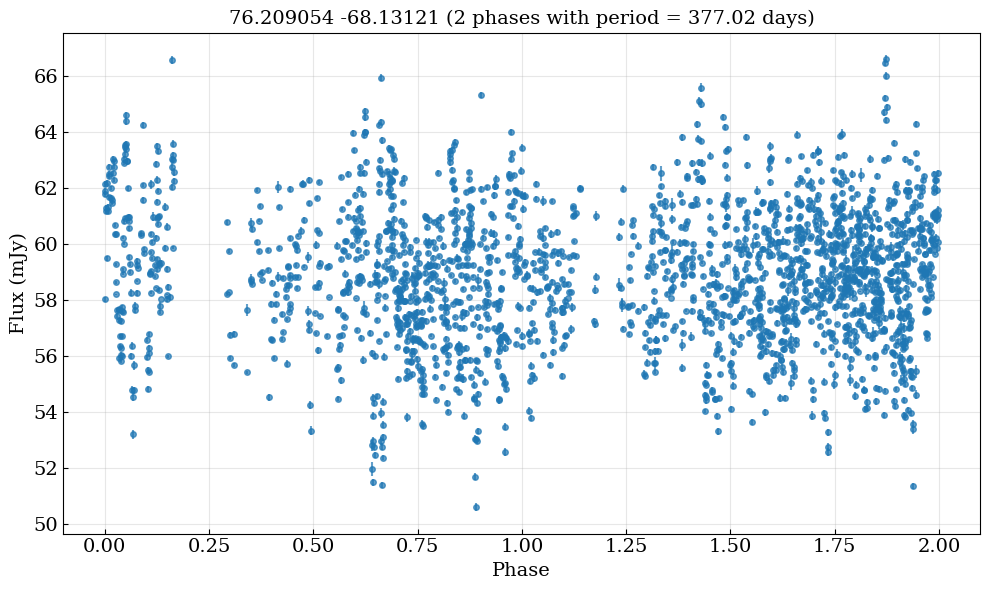

Average scatter (amplitude) per 10 point phase bin: 5.263 mJy
FAL: 0.01342458, Alias FAL: 0.01342458
Alias false alarm probability: 3.223e-27
Best frequency: 0.126153 1/day, Best period: 7.93 days, Max power: 0.064, False alarm probability: 3.223e-27
False alarm level for 1.0%: 1.342e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


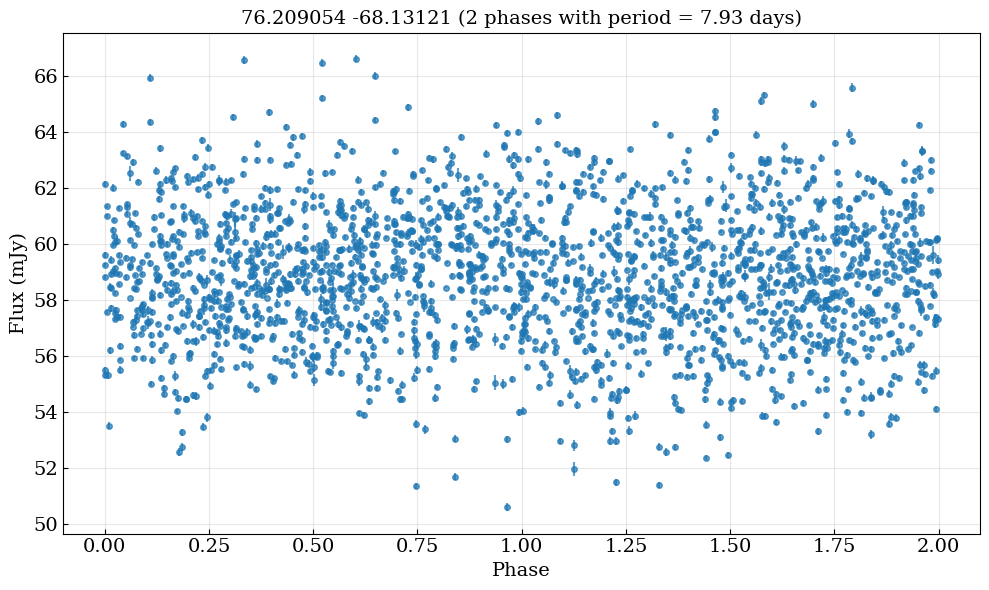

Average scatter (amplitude) per 10 point phase bin: 6.420 mJy
Target 533 
FAL: 0.01017720, Alias FAL: 0.01017720
Alias false alarm probability: 7.176e-21
Best frequency: 0.002778 1/day, Best period: 360.00 days, Max power: 0.011, False alarm probability: 1.666e-03
False alarm level for 1.0%: 1.018e-02


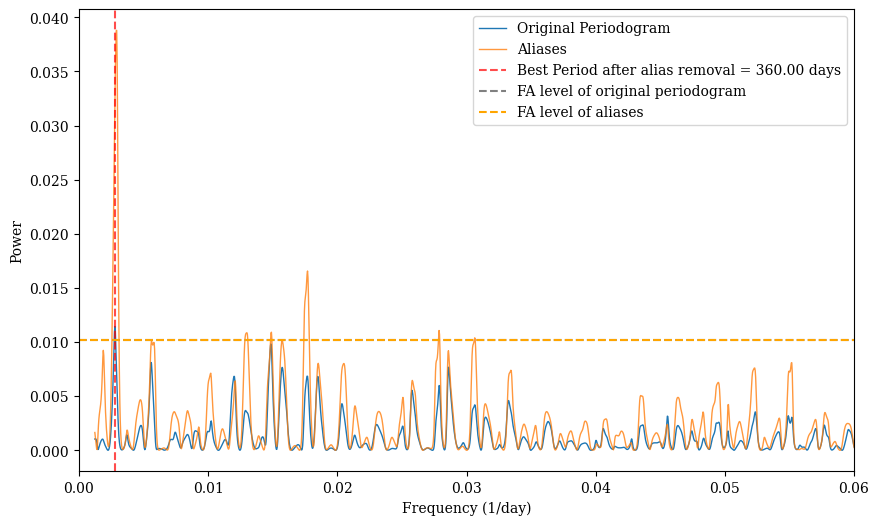

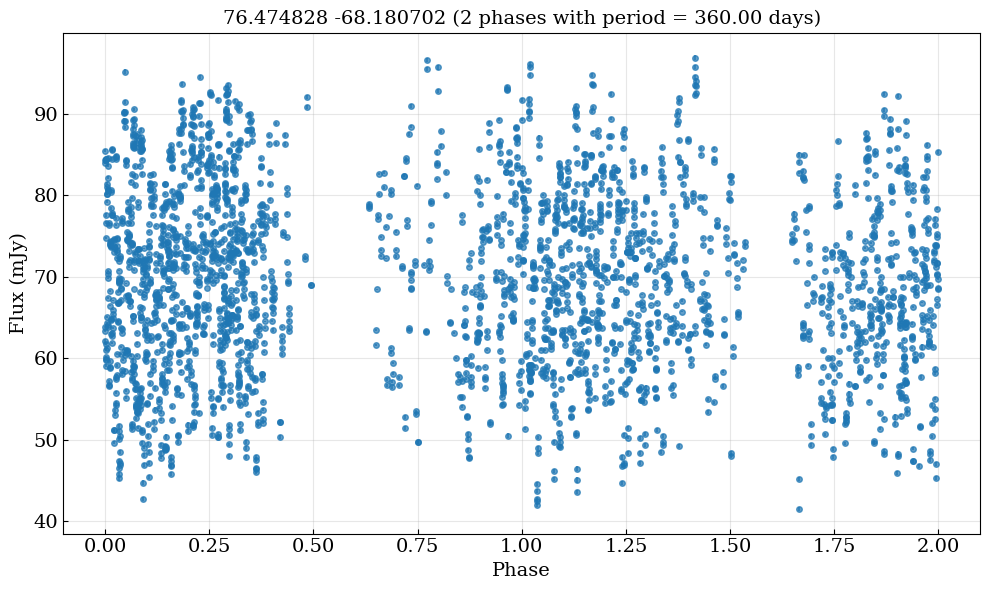

Average scatter (amplitude) per 10 point phase bin: 20.983 mJy
FAL: 0.01017720, Alias FAL: 0.01017720
Alias false alarm probability: 7.176e-21
Best frequency: 0.135233 1/day, Best period: 7.39 days, Max power: 0.039, False alarm probability: 7.176e-21
False alarm level for 1.0%: 1.018e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


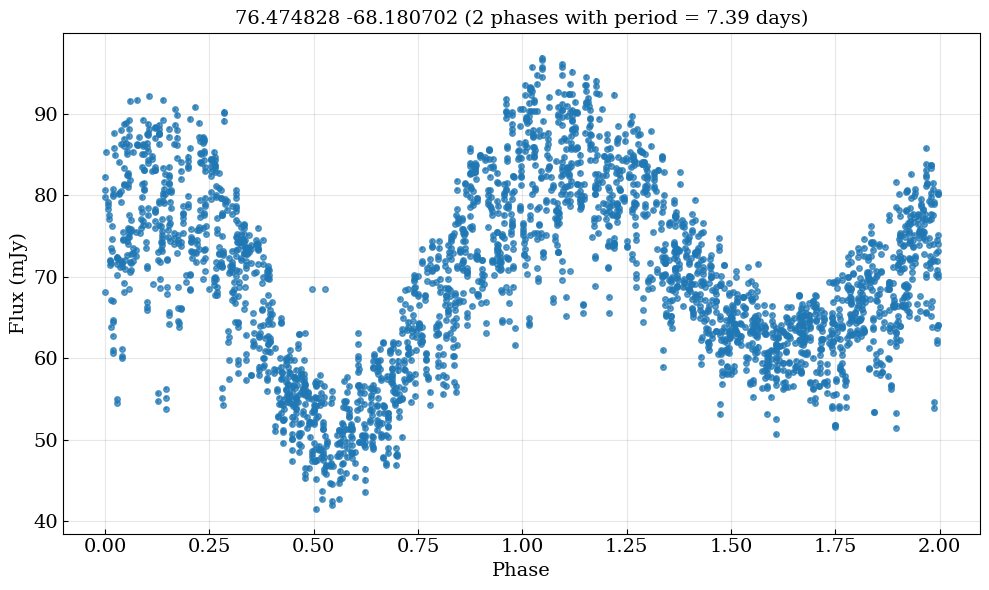

Average scatter (amplitude) per 10 point phase bin: 12.294 mJy
Target 535 
FAL: 0.01307559, Alias FAL: 0.01307559
Alias false alarm probability: 0.000e+00
Best frequency: 0.026495 1/day, Best period: 37.74 days, Max power: 0.092, False alarm probability: 9.285e-43
False alarm level for 1.0%: 1.308e-02


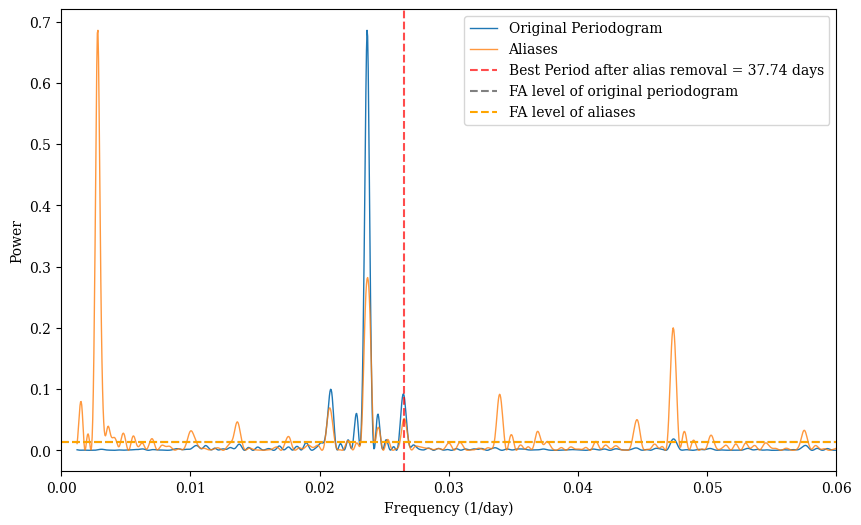

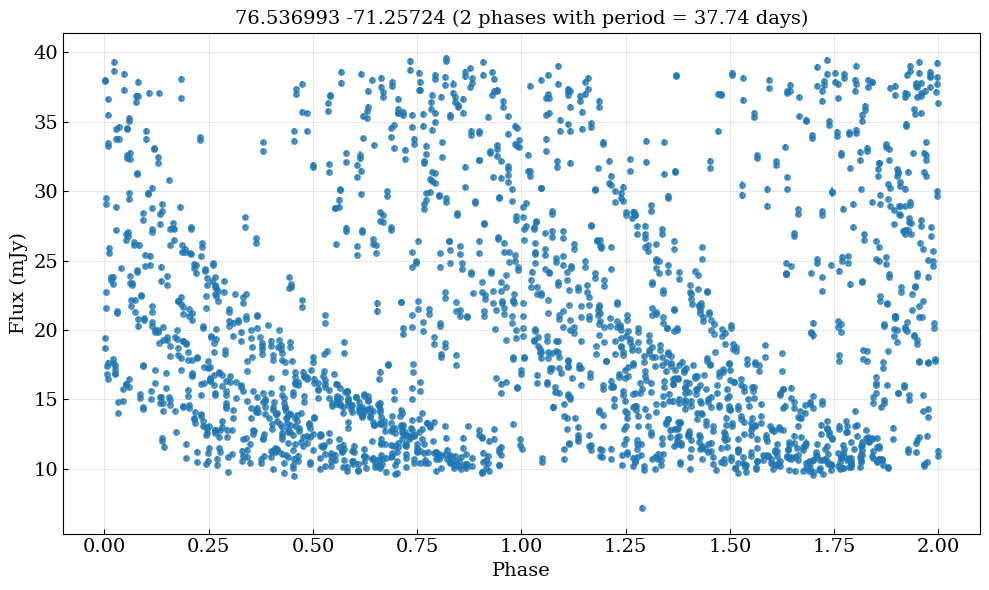

Average scatter (amplitude) per 10 point phase bin: 18.151 mJy
FAL: 0.01307559, Alias FAL: 0.01307559
Alias false alarm probability: 0.000e+00
Best frequency: 0.023672 1/day, Best period: 42.24 days, Max power: 0.686, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.308e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


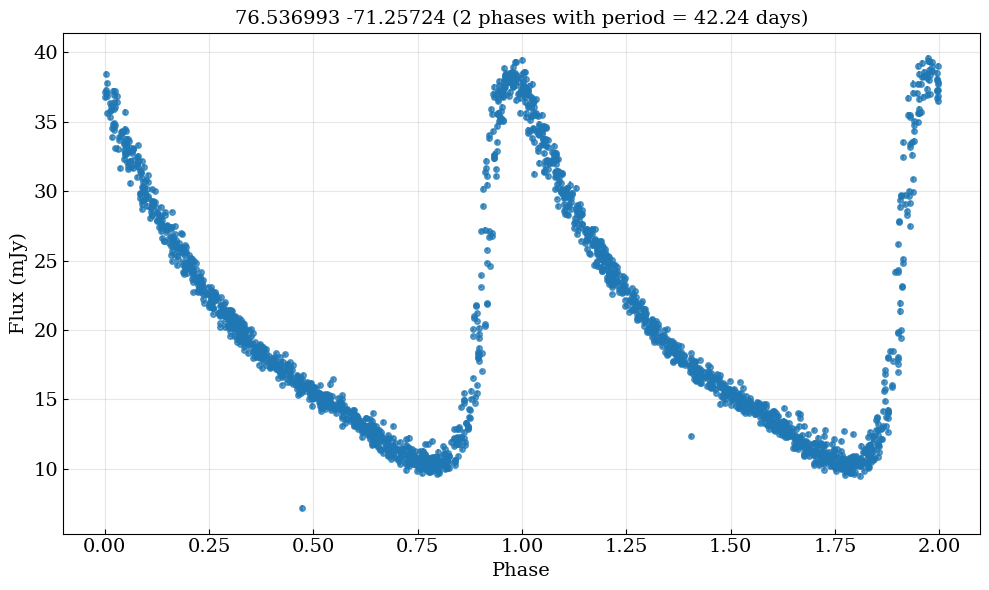

Average scatter (amplitude) per 10 point phase bin: 2.425 mJy
Target 545 
FAL: 0.01306914, Alias FAL: 0.01306914
Alias false alarm probability: 0.000e+00
Best frequency: 0.018296 1/day, Best period: 54.66 days, Max power: 0.107, False alarm probability: 8.205e-51
False alarm level for 1.0%: 1.307e-02


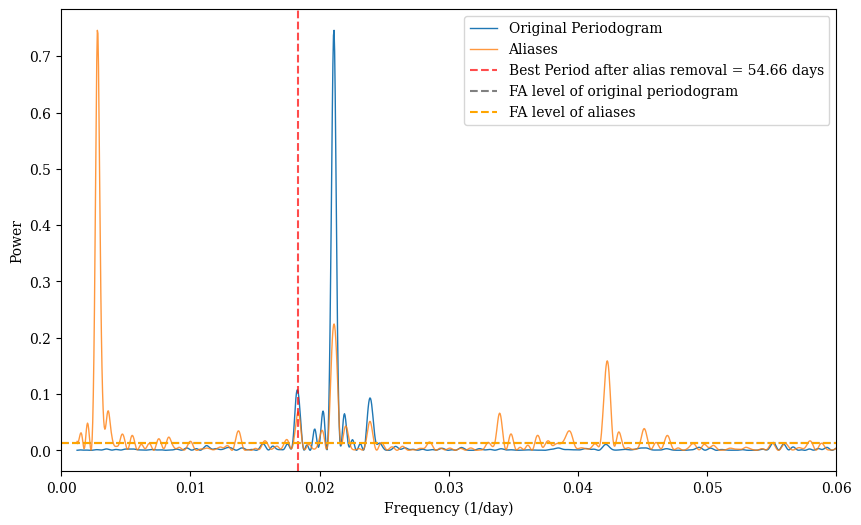

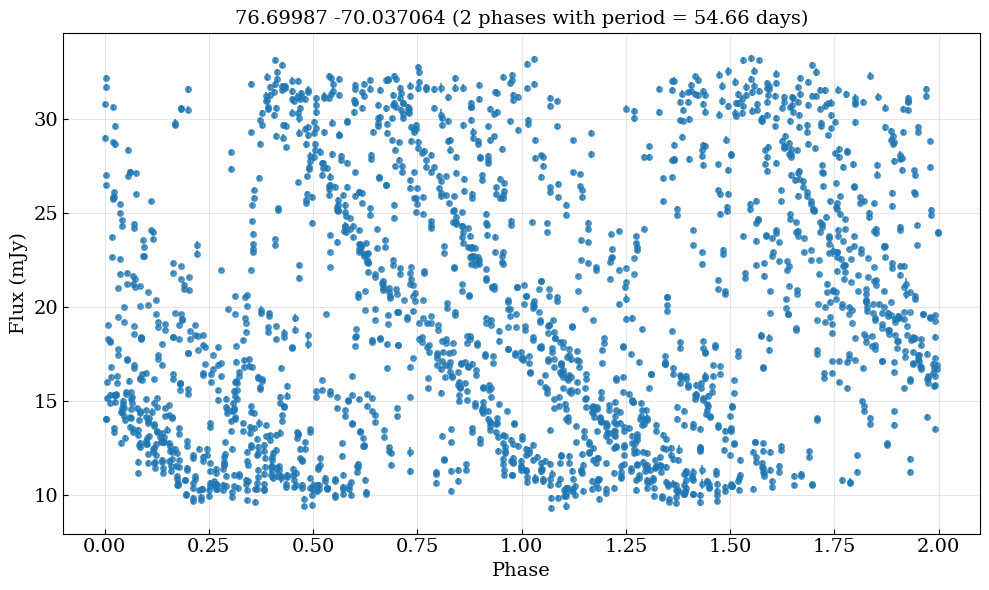

Average scatter (amplitude) per 10 point phase bin: 13.559 mJy
FAL: 0.01306914, Alias FAL: 0.01306914
Alias false alarm probability: 0.000e+00
Best frequency: 0.021118 1/day, Best period: 47.35 days, Max power: 0.746, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.307e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


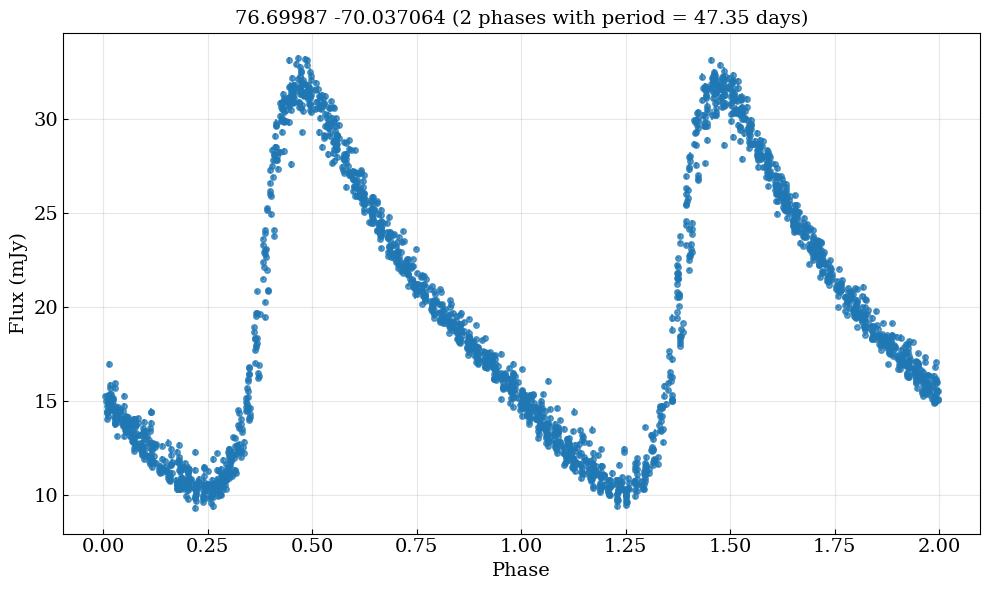

Average scatter (amplitude) per 10 point phase bin: 1.853 mJy
Target 546 
FAL: 0.01308502, Alias FAL: 0.01308502
Alias false alarm probability: 0.000e+00
Best frequency: 0.029408 1/day, Best period: 34.00 days, Max power: 0.134, False alarm probability: 1.219e-65
False alarm level for 1.0%: 1.309e-02


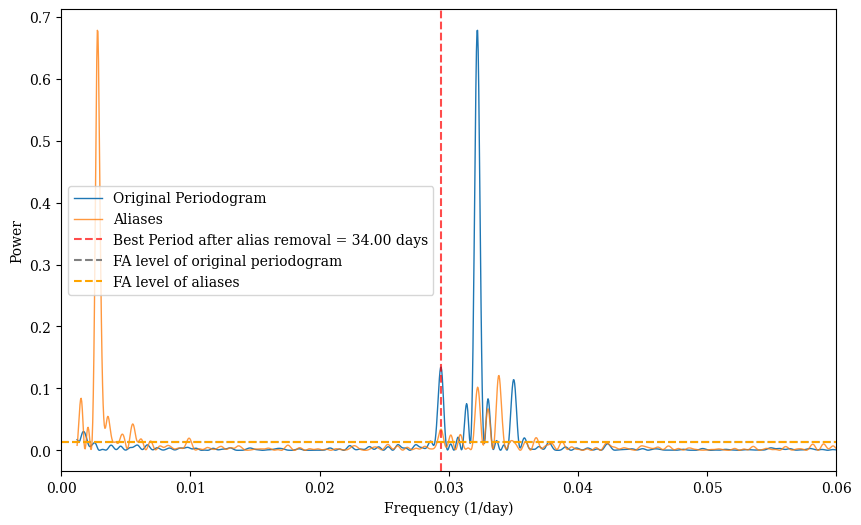

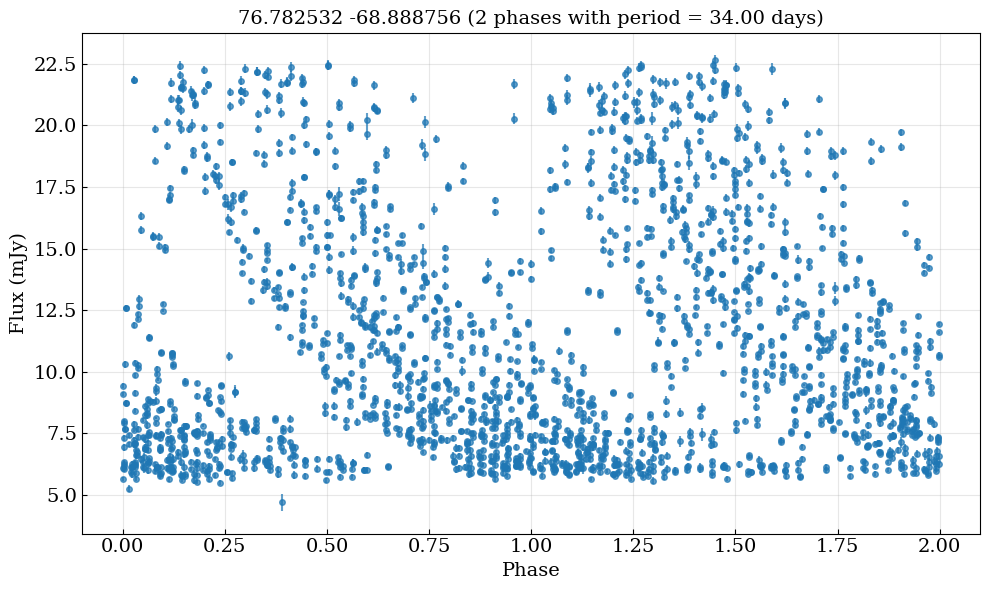

Average scatter (amplitude) per 10 point phase bin: 8.453 mJy
FAL: 0.01308502, Alias FAL: 0.01308502
Alias false alarm probability: 0.000e+00
Best frequency: 0.032231 1/day, Best period: 31.03 days, Max power: 0.678, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.309e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


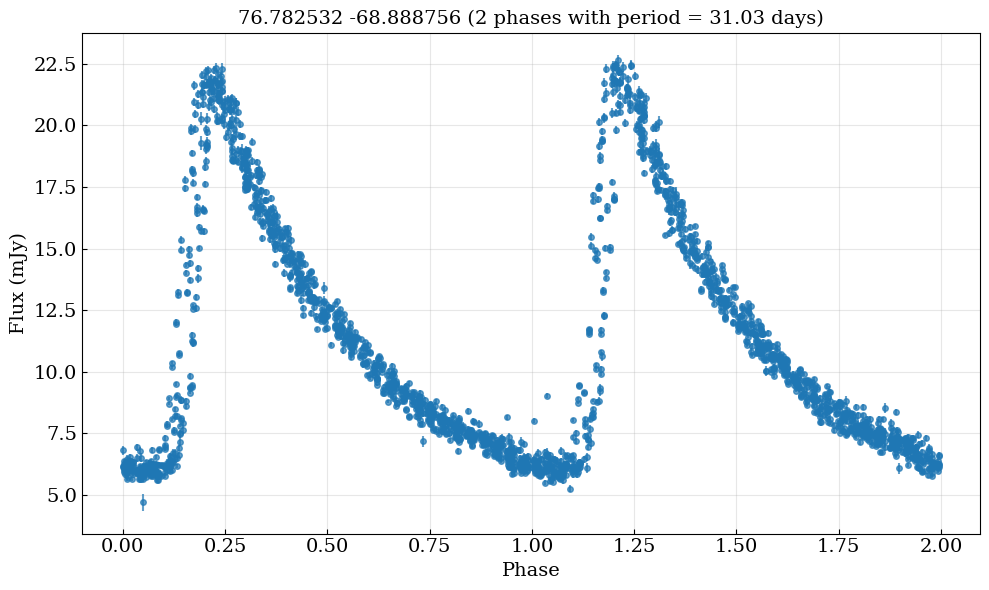

Average scatter (amplitude) per 10 point phase bin: 1.770 mJy
Target 550 
FAL: 0.01307227, Alias FAL: 0.01307227
Alias false alarm probability: 0.000e+00
Best frequency: 0.040824 1/day, Best period: 24.50 days, Max power: 0.120, False alarm probability: 1.186e-57
False alarm level for 1.0%: 1.307e-02


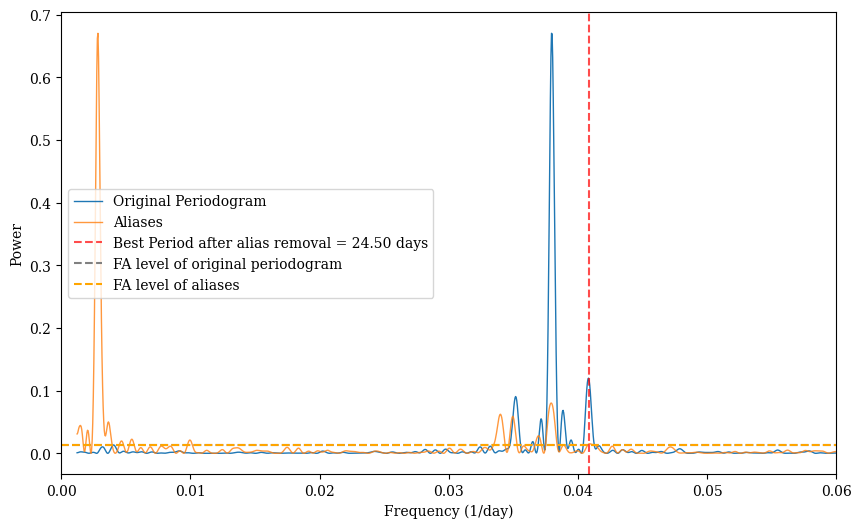

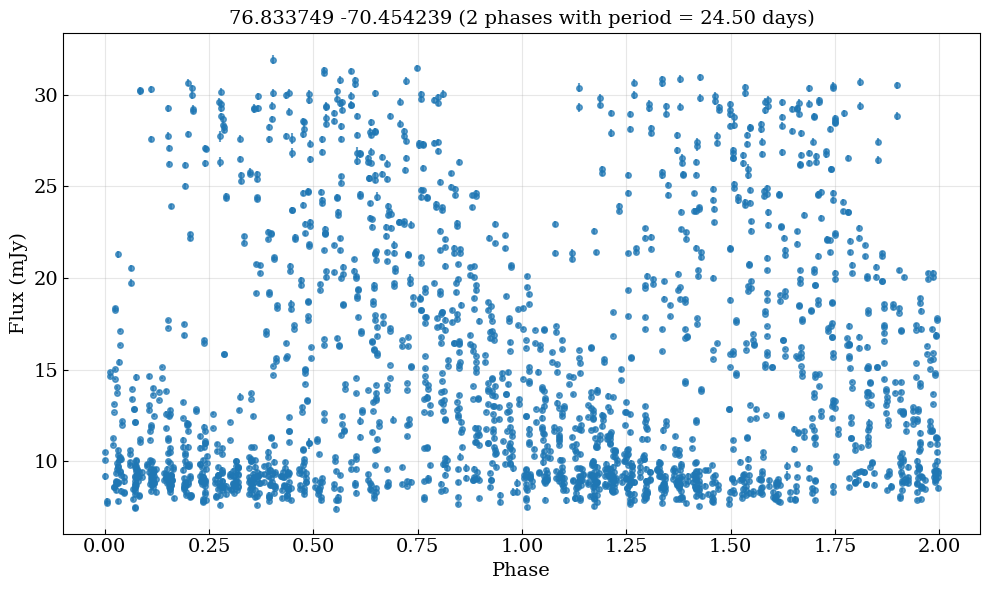

Average scatter (amplitude) per 10 point phase bin: 11.399 mJy
FAL: 0.01307227, Alias FAL: 0.01307227
Alias false alarm probability: 0.000e+00
Best frequency: 0.037954 1/day, Best period: 26.35 days, Max power: 0.670, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.307e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


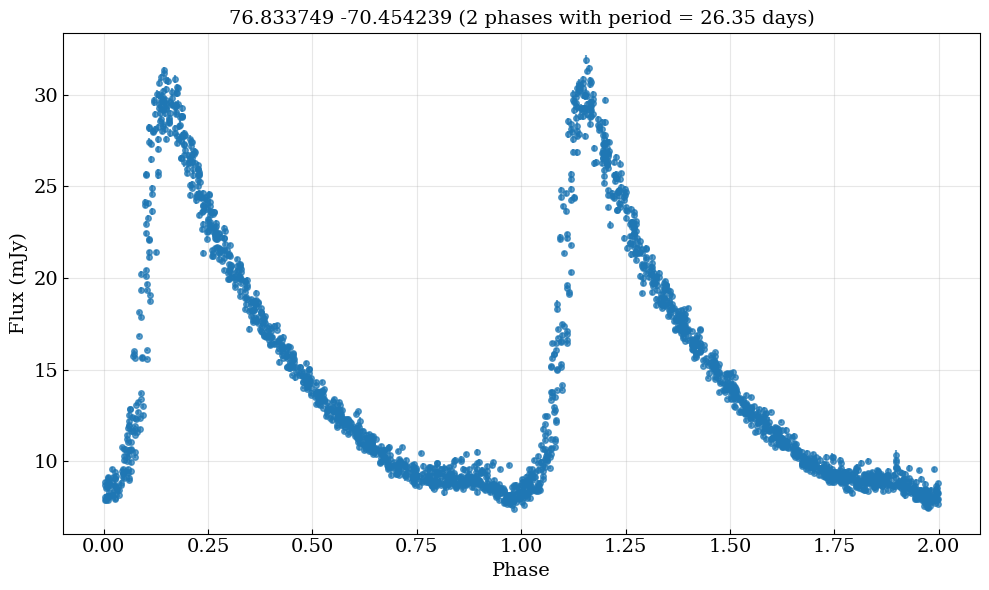

Average scatter (amplitude) per 10 point phase bin: 1.884 mJy
Target 559 
FAL: 0.01307038, Alias FAL: 0.01307038
Alias false alarm probability: 0.000e+00
Best frequency: 0.035681 1/day, Best period: 28.03 days, Max power: 0.127, False alarm probability: 1.172e-61
False alarm level for 1.0%: 1.307e-02


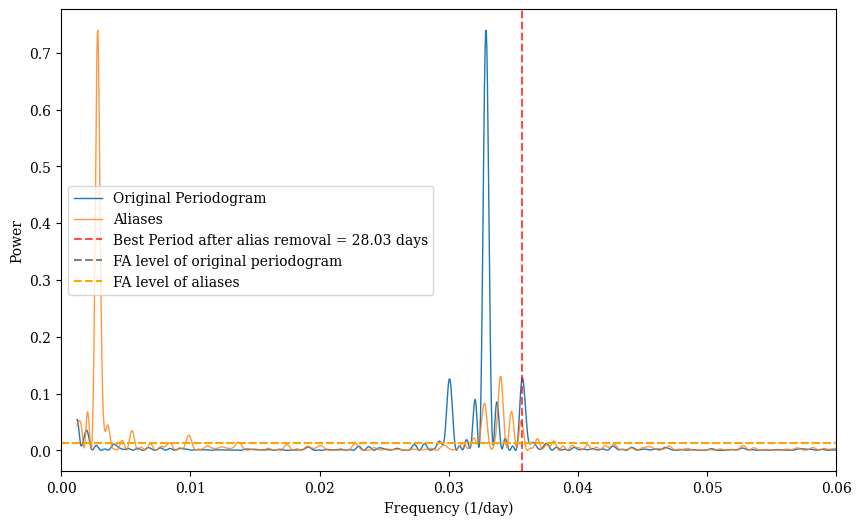

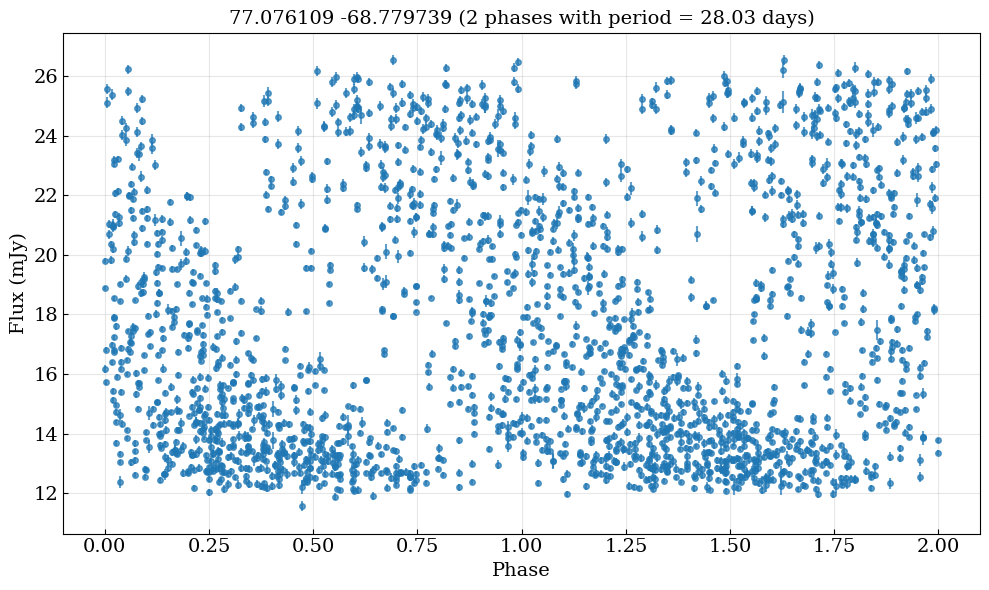

Average scatter (amplitude) per 10 point phase bin: 9.204 mJy
FAL: 0.01307038, Alias FAL: 0.01307038
Alias false alarm probability: 0.000e+00
Best frequency: 0.032858 1/day, Best period: 30.43 days, Max power: 0.740, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.307e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


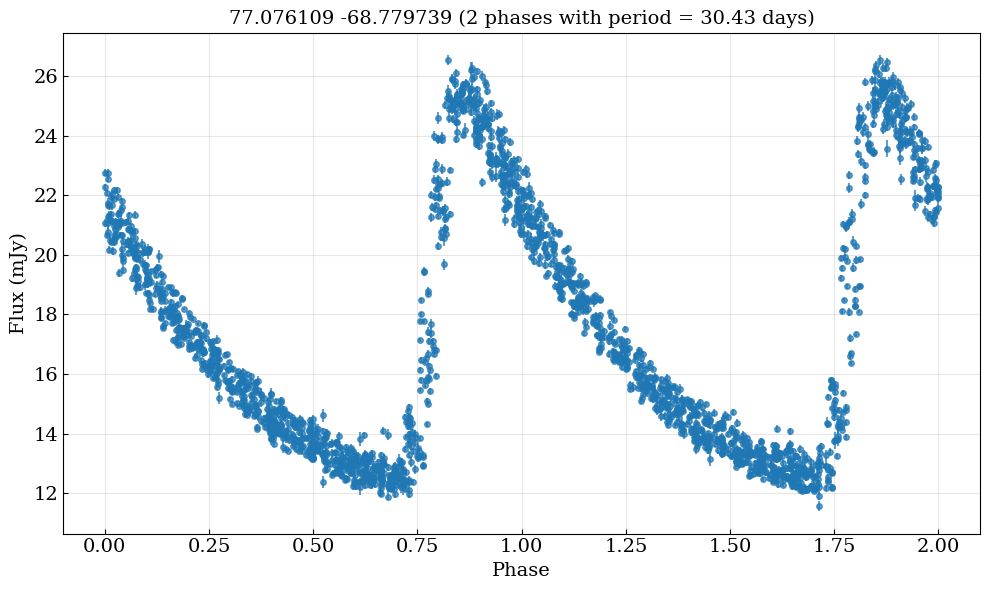

Average scatter (amplitude) per 10 point phase bin: 1.745 mJy
Target 560 
FAL: 0.01202175, Alias FAL: 0.01202175
Alias false alarm probability: 2.246e-09
Best frequency: 0.001348 1/day, Best period: 741.94 days, Max power: 0.019, False alarm probability: 1.326e-06
False alarm level for 1.0%: 1.202e-02


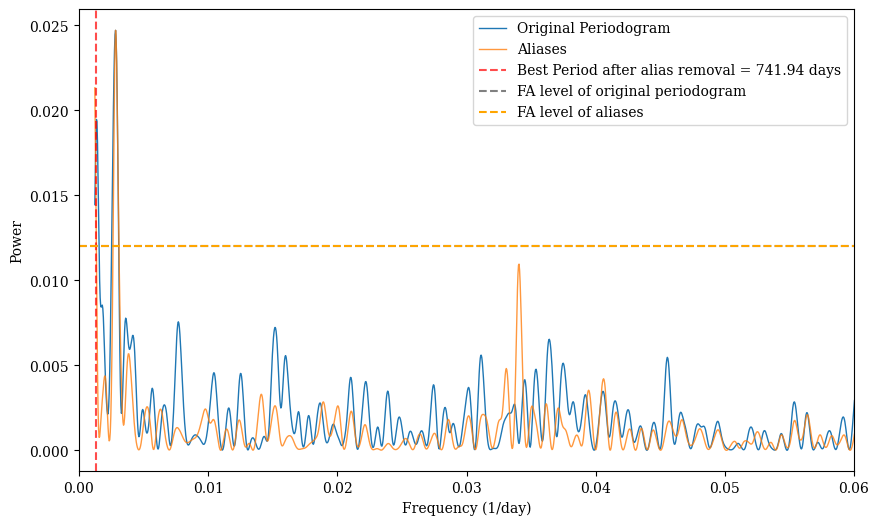

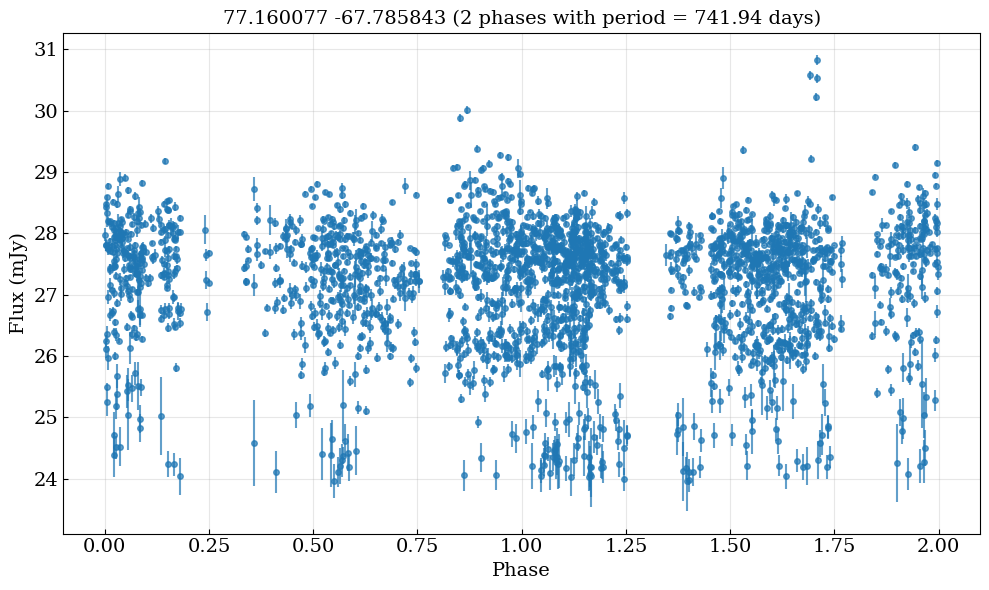

Average scatter (amplitude) per 10 point phase bin: 2.925 mJy
FAL: 0.01202175, Alias FAL: 0.01202175
Alias false alarm probability: 2.246e-09
Best frequency: 0.002829 1/day, Best period: 353.43 days, Max power: 0.025, False alarm probability: 2.246e-09
False alarm level for 1.0%: 1.202e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


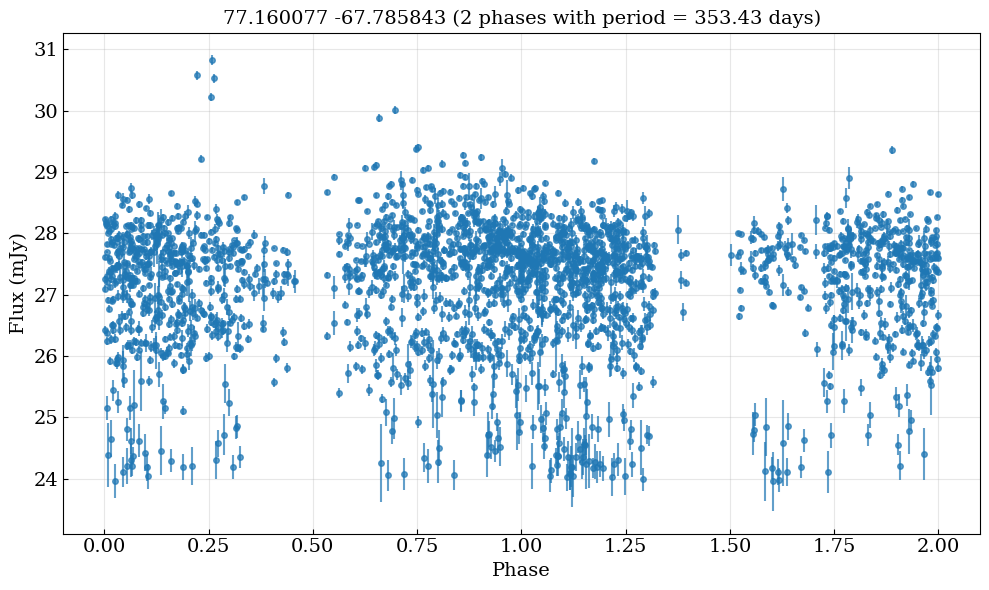

Average scatter (amplitude) per 10 point phase bin: 3.076 mJy
Target 563 
FAL: 0.01880830, Alias FAL: 0.01880830
Alias false alarm probability: 0.000e+00
Best frequency: 0.023803 1/day, Best period: 42.01 days, Max power: 0.123, False alarm probability: 6.878e-39
False alarm level for 1.0%: 1.881e-02


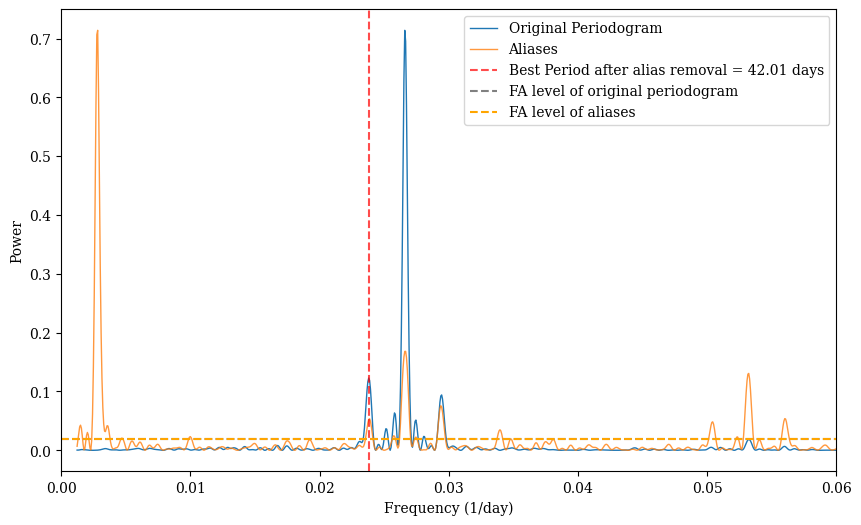

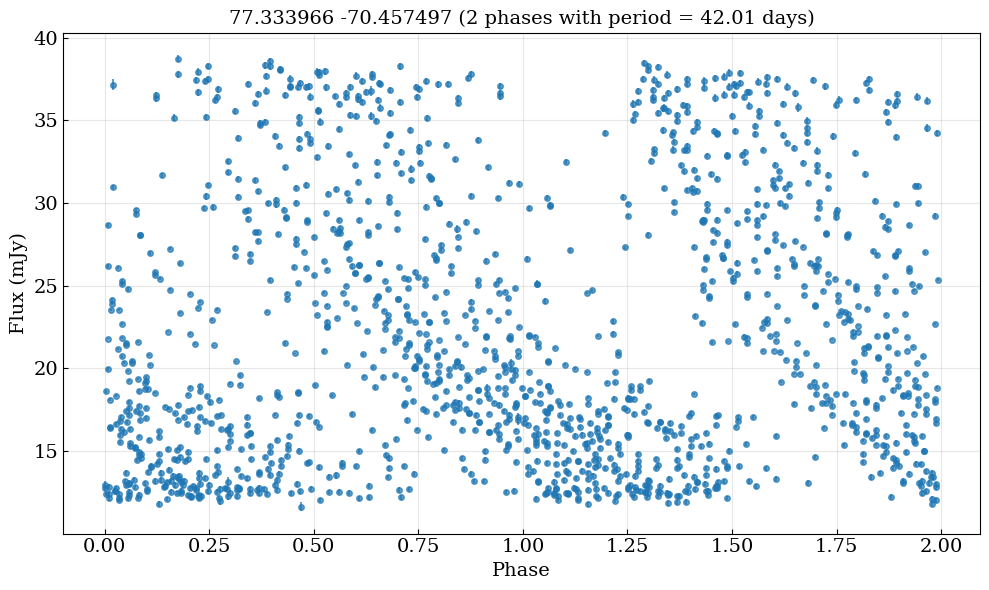

Average scatter (amplitude) per 10 point phase bin: 18.347 mJy
FAL: 0.01880830, Alias FAL: 0.01880830
Alias false alarm probability: 0.000e+00
Best frequency: 0.026592 1/day, Best period: 37.60 days, Max power: 0.714, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.881e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


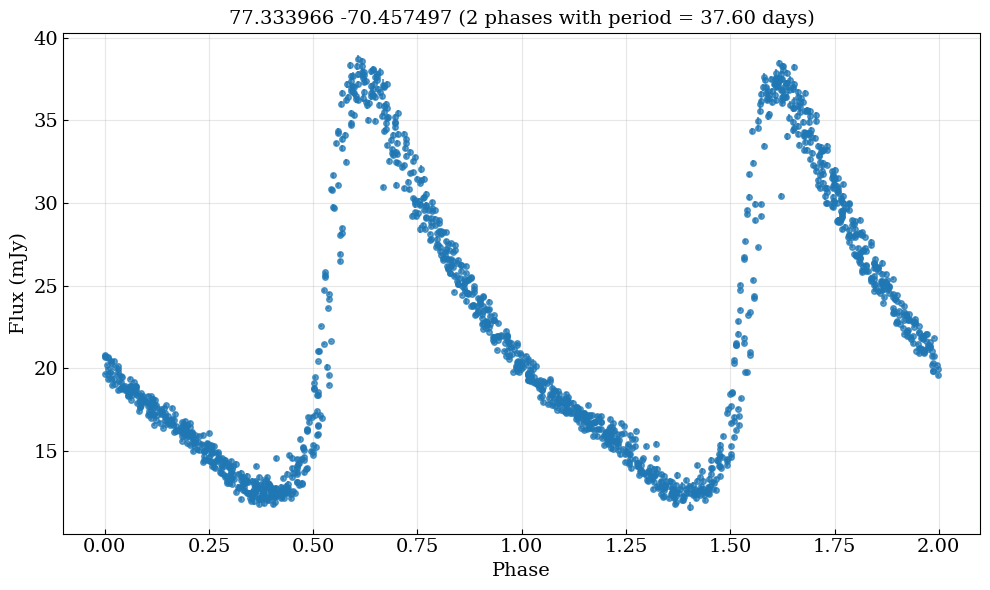

Average scatter (amplitude) per 10 point phase bin: 2.525 mJy
Target 591 
FAL: 0.02481295, Alias FAL: 0.02481295
Alias false alarm probability: 1.465e-271
Best frequency: 0.017908 1/day, Best period: 55.84 days, Max power: 0.099, False alarm probability: 1.593e-21
False alarm level for 1.0%: 2.481e-02


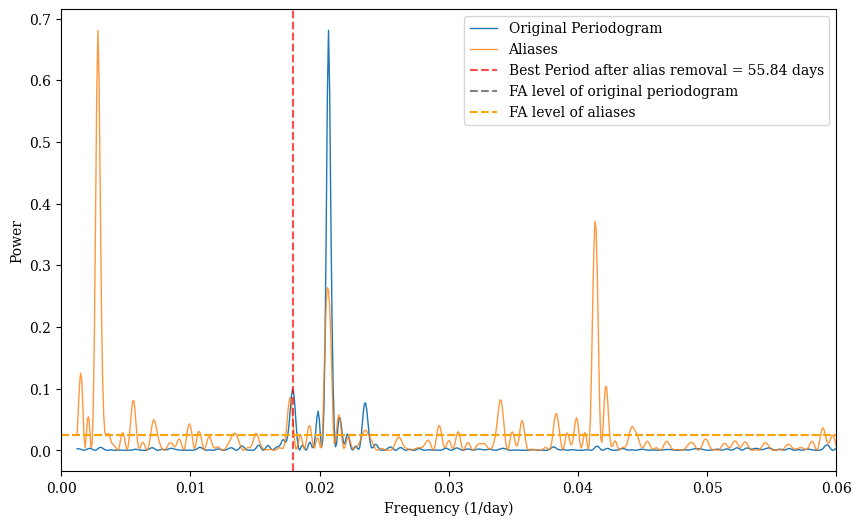

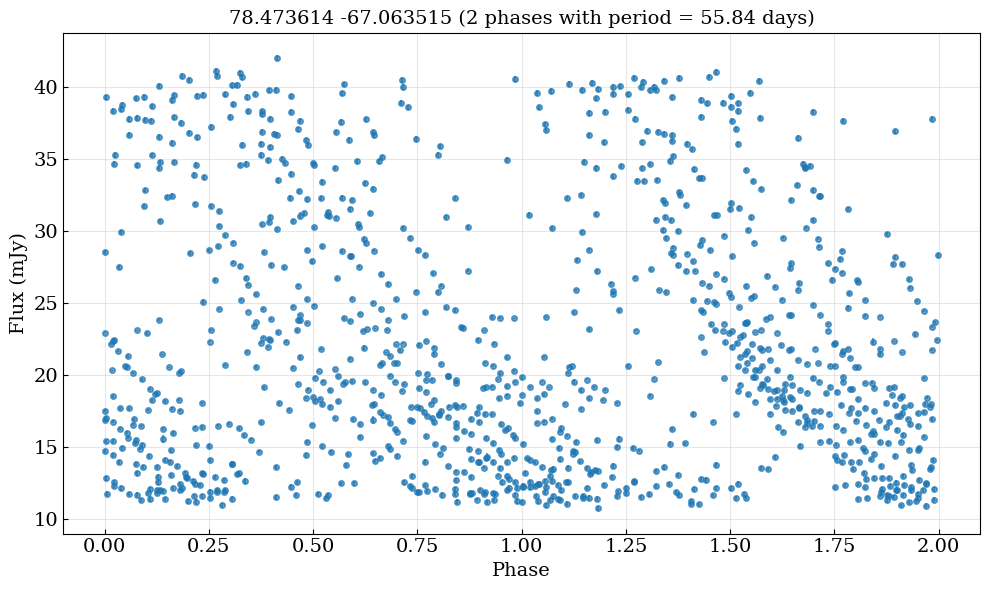

Average scatter (amplitude) per 10 point phase bin: 22.208 mJy
FAL: 0.02481295, Alias FAL: 0.02481295
Alias false alarm probability: 1.465e-271
Best frequency: 0.020689 1/day, Best period: 48.34 days, Max power: 0.681, False alarm probability: 1.465e-271
False alarm level for 1.0%: 2.481e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


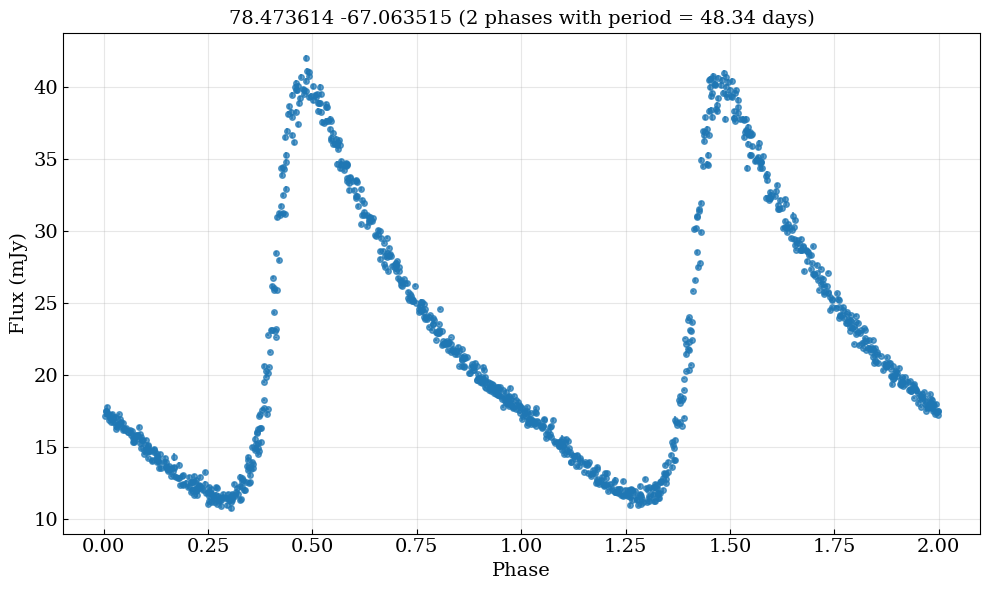

Average scatter (amplitude) per 10 point phase bin: 2.043 mJy
Target 652 
FAL: 0.01934627, Alias FAL: 0.01934627
Alias false alarm probability: 3.791e-05
Best frequency: 0.001361 1/day, Best period: 734.57 days, Max power: 0.026, False alarm probability: 1.022e-04
False alarm level for 1.0%: 1.935e-02


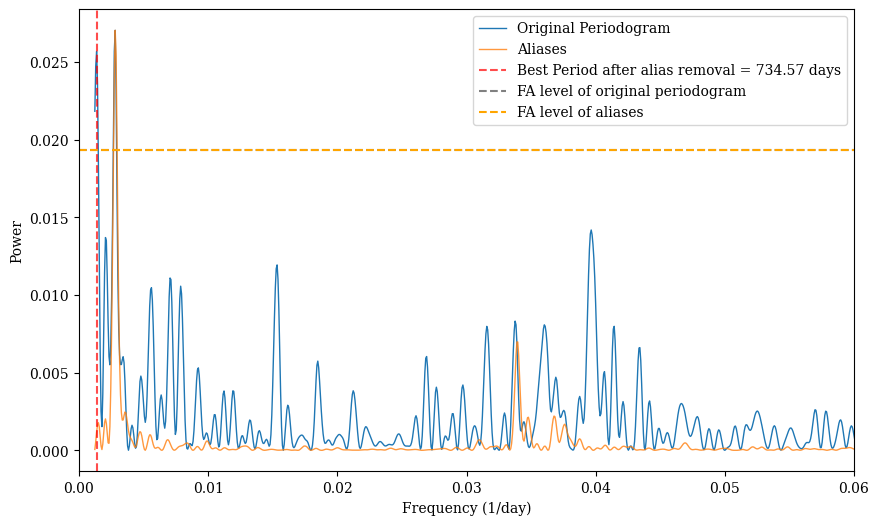

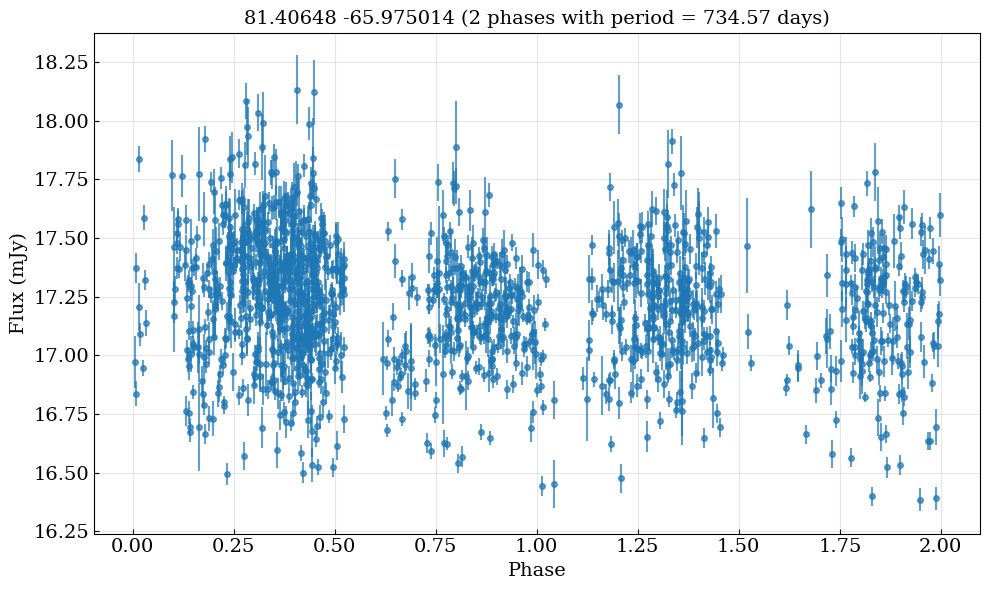

Average scatter (amplitude) per 10 point phase bin: 0.760 mJy
FAL: 0.01934627, Alias FAL: 0.01934627
Alias false alarm probability: 3.791e-05
Best frequency: 0.002800 1/day, Best period: 357.16 days, Max power: 0.027, False alarm probability: 3.791e-05
False alarm level for 1.0%: 1.935e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


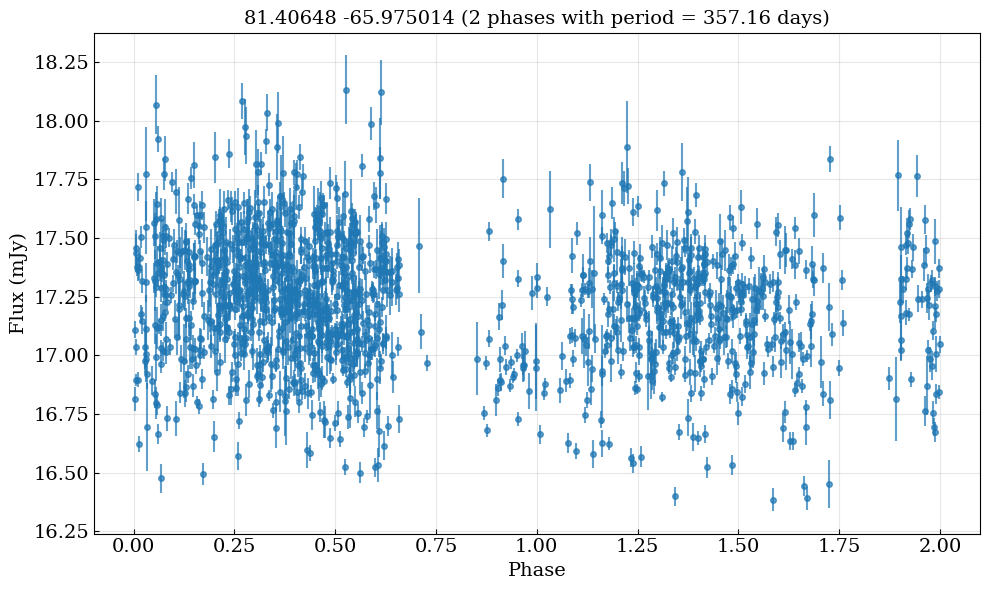

Average scatter (amplitude) per 10 point phase bin: 0.781 mJy
Target 687 
FAL: 0.01535488, Alias FAL: 0.01535488
Alias false alarm probability: 0.000e+00
Best frequency: 0.039114 1/day, Best period: 25.57 days, Max power: 0.112, False alarm probability: 2.522e-44
False alarm level for 1.0%: 1.535e-02


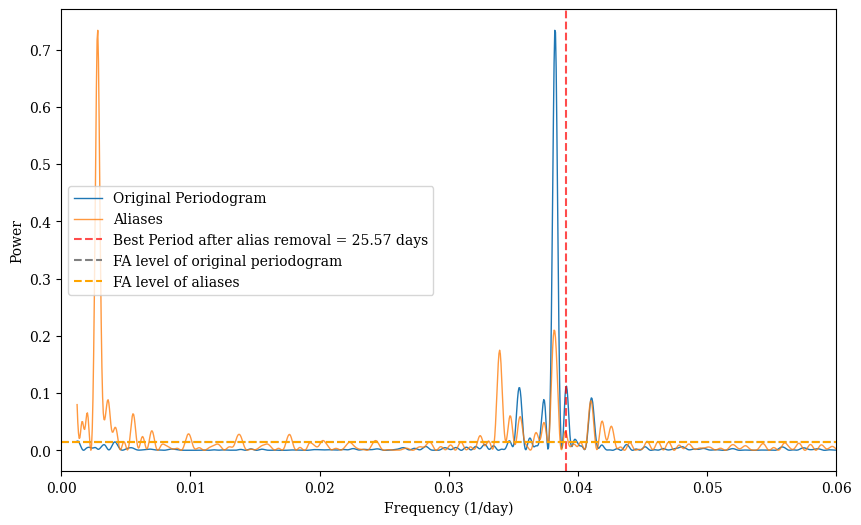

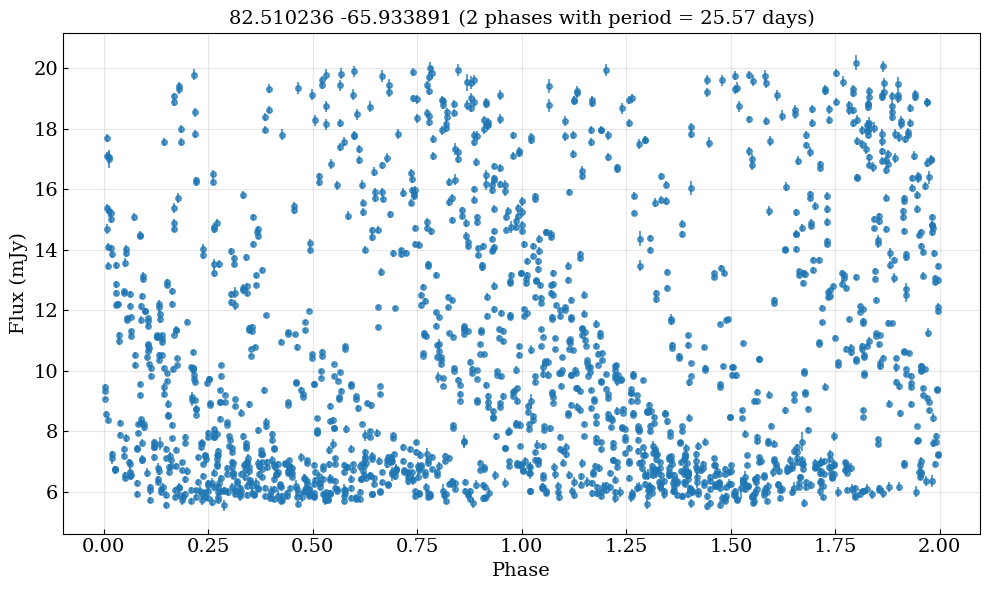

Average scatter (amplitude) per 10 point phase bin: 9.472 mJy
FAL: 0.01535488, Alias FAL: 0.01535488
Alias false alarm probability: 0.000e+00
Best frequency: 0.038206 1/day, Best period: 26.17 days, Max power: 0.734, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.535e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


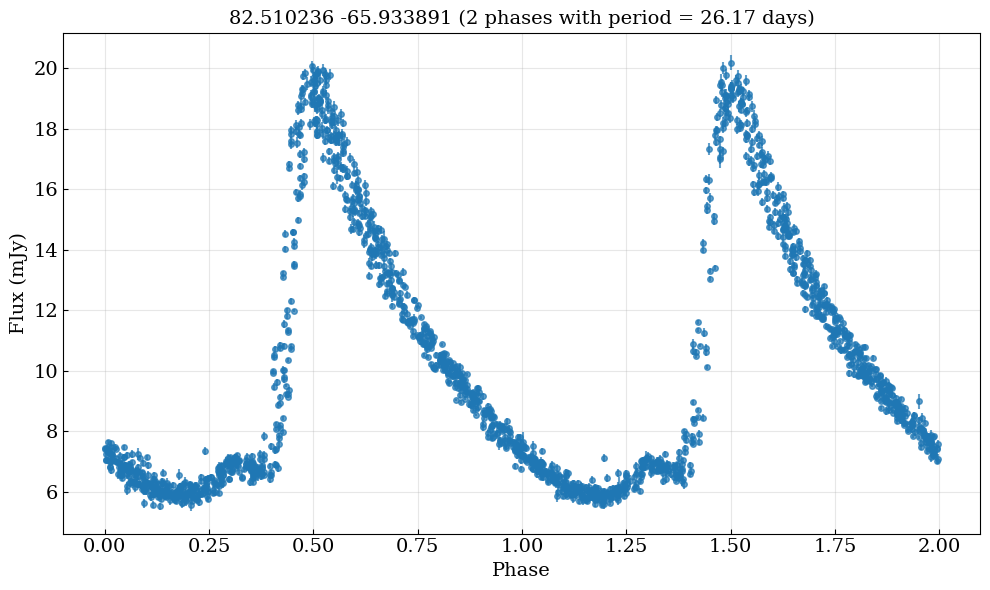

Average scatter (amplitude) per 10 point phase bin: 1.353 mJy
Target 702 
FAL: 0.01423053, Alias FAL: 0.01423053
Alias false alarm probability: 0.000e+00
Best frequency: 0.021845 1/day, Best period: 45.78 days, Max power: 0.121, False alarm probability: 6.333e-53
False alarm level for 1.0%: 1.423e-02


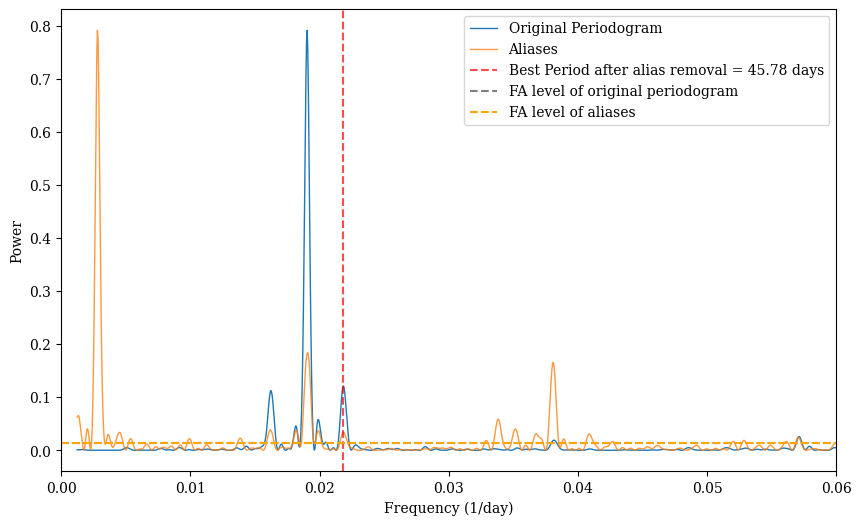

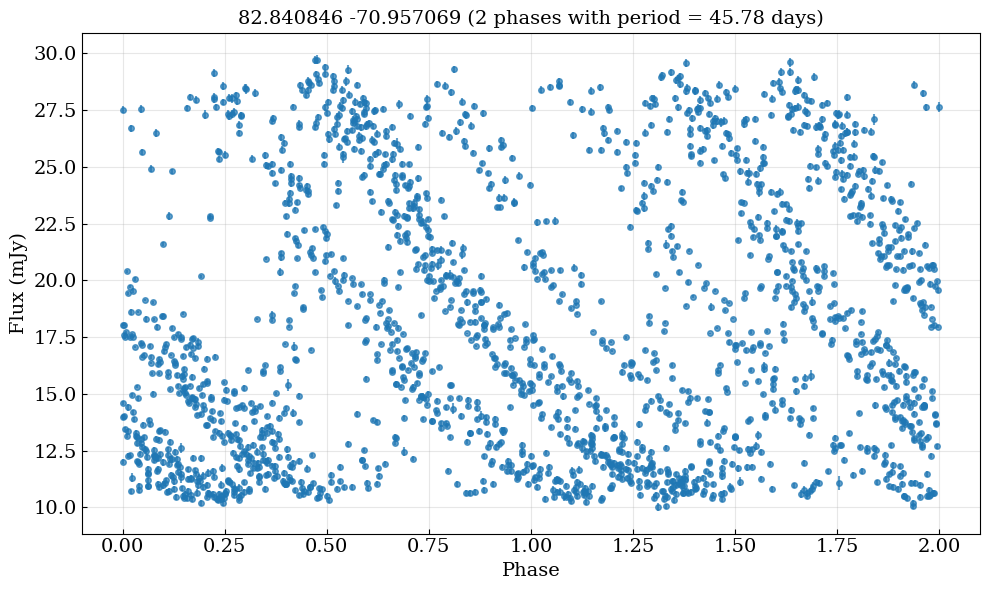

Average scatter (amplitude) per 10 point phase bin: 13.754 mJy
FAL: 0.01423053, Alias FAL: 0.01423053
Alias false alarm probability: 0.000e+00
Best frequency: 0.019040 1/day, Best period: 52.52 days, Max power: 0.791, False alarm probability: 0.000e+00
False alarm level for 1.0%: 1.423e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


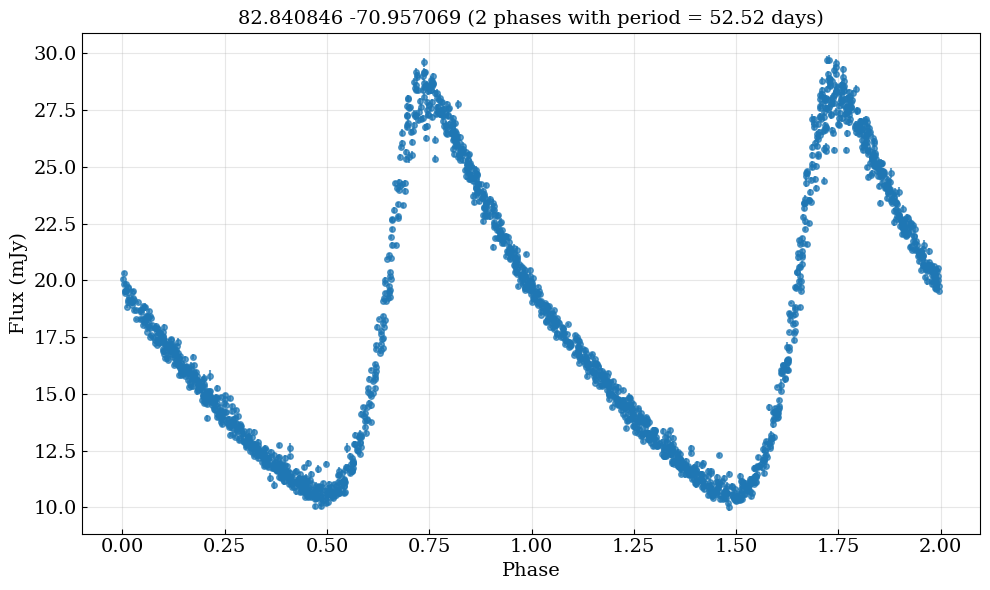

Average scatter (amplitude) per 10 point phase bin: 1.333 mJy
Target 706 
FAL: 0.01599985, Alias FAL: 0.01599985
Alias false alarm probability: 6.630e-08
Best frequency: 0.004754 1/day, Best period: 210.36 days, Max power: 0.017, False alarm probability: 4.664e-03
False alarm level for 1.0%: 1.600e-02


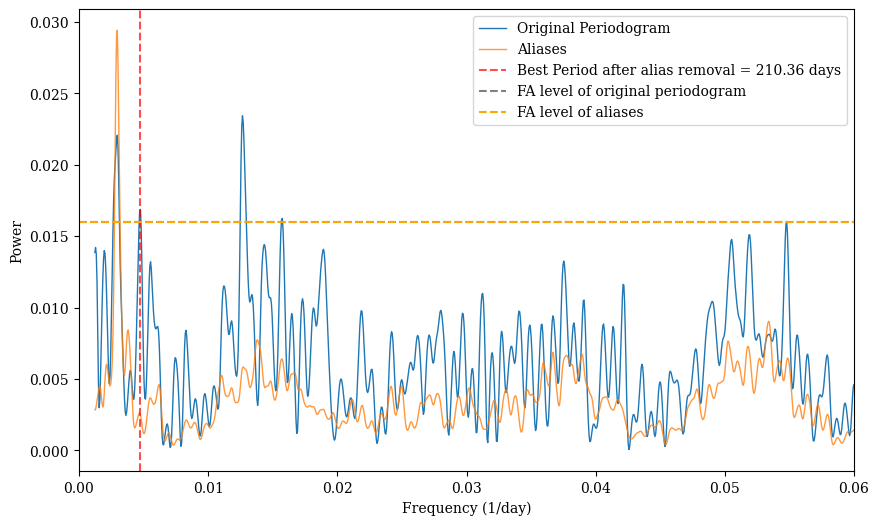

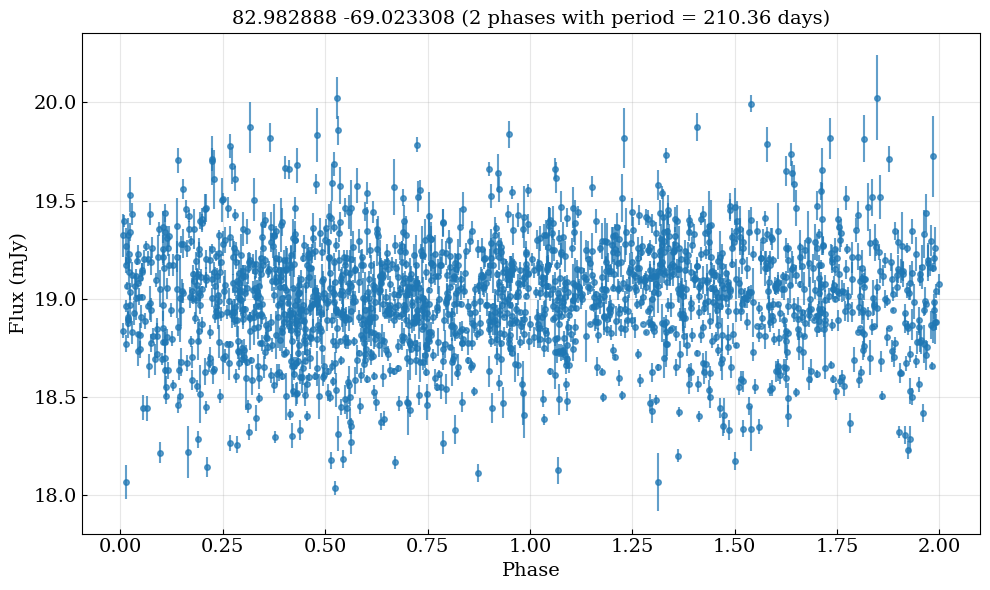

Average scatter (amplitude) per 10 point phase bin: 0.852 mJy
FAL: 0.01599985, Alias FAL: 0.01599985
Alias false alarm probability: 6.630e-08
Best frequency: 0.170872 1/day, Best period: 5.85 days, Max power: 0.029, False alarm probability: 6.630e-08
False alarm level for 1.0%: 1.600e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


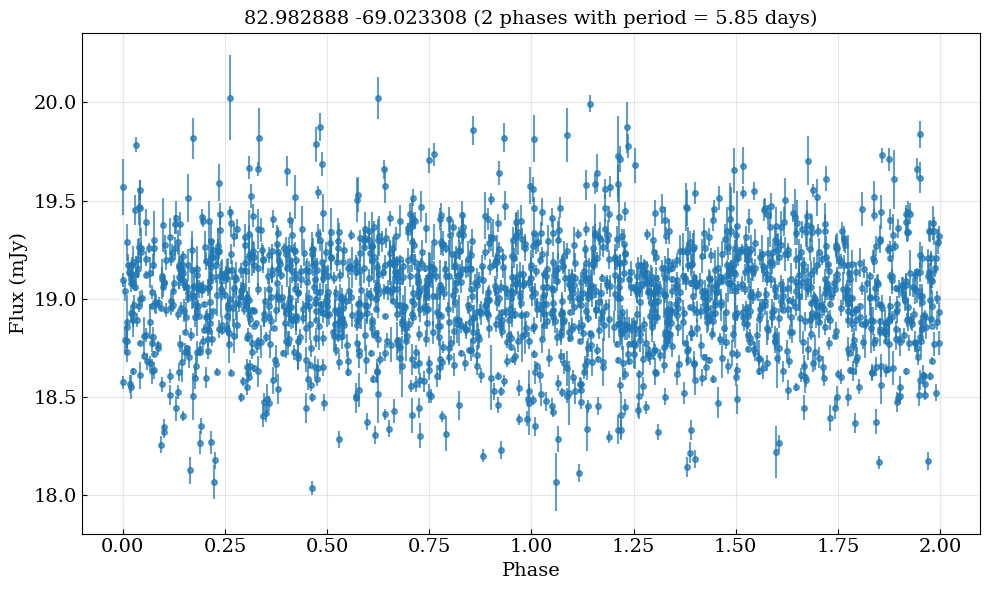

Average scatter (amplitude) per 10 point phase bin: 0.842 mJy
Target 736 
FAL: 0.02450805, Alias FAL: 0.02450805
Alias false alarm probability: 3.479e-270
Best frequency: 0.030014 1/day, Best period: 33.32 days, Max power: 0.103, False alarm probability: 7.068e-23
False alarm level for 1.0%: 2.451e-02


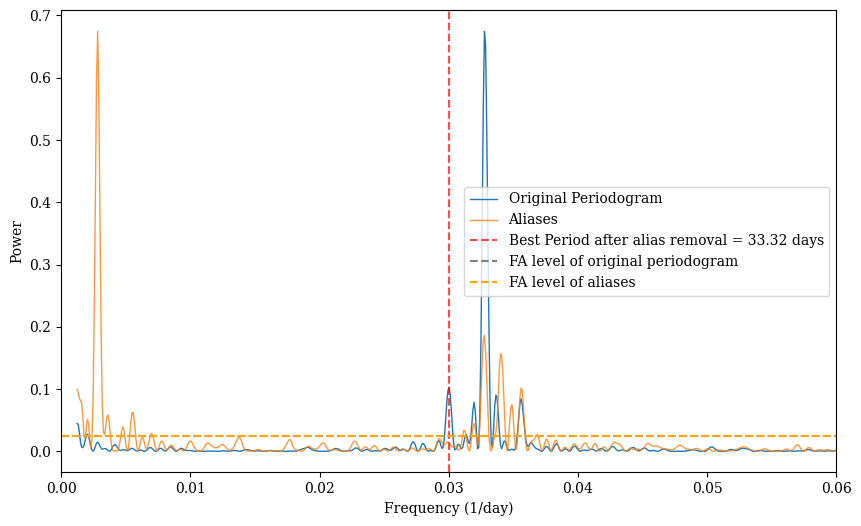

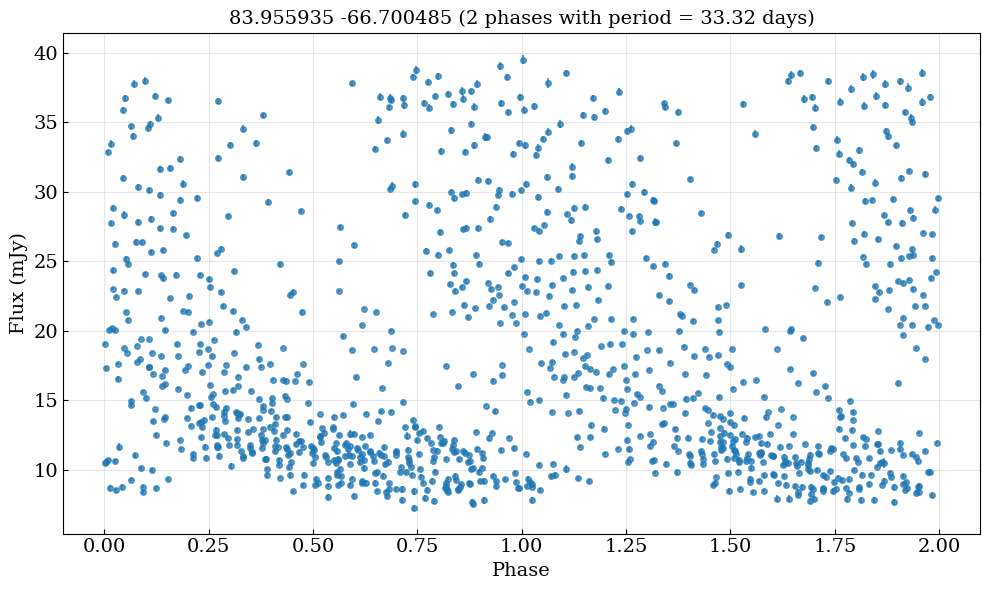

Average scatter (amplitude) per 10 point phase bin: 21.379 mJy
FAL: 0.02450805, Alias FAL: 0.02450805
Alias false alarm probability: 3.479e-270
Best frequency: 0.032760 1/day, Best period: 30.52 days, Max power: 0.675, False alarm probability: 3.479e-270
False alarm level for 1.0%: 2.451e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


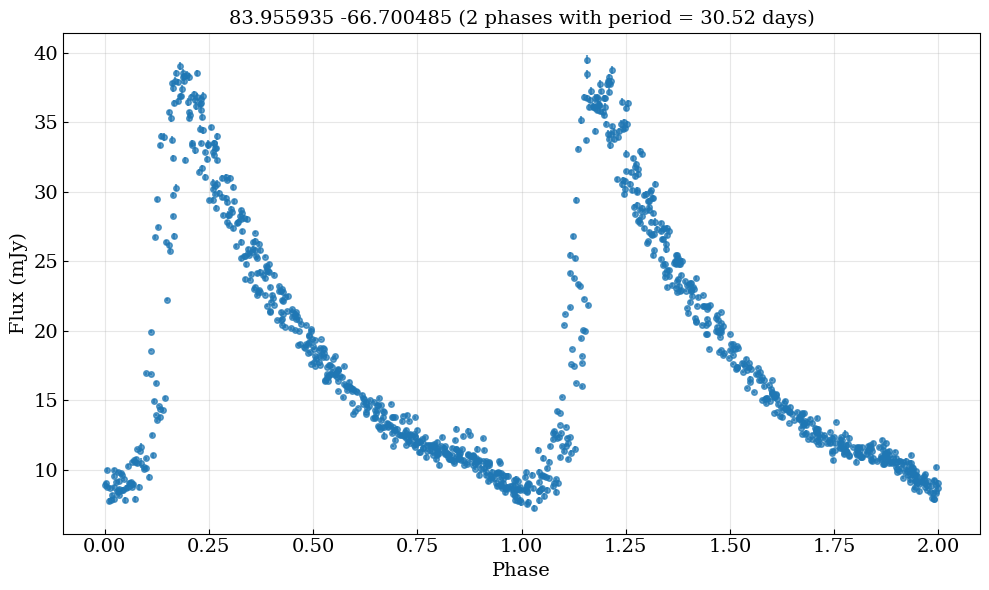

Average scatter (amplitude) per 10 point phase bin: 3.672 mJy
Target 774 
FAL: 0.01954123, Alias FAL: 0.01954123
Alias false alarm probability: 2.872e-59
Best frequency: 0.005268 1/day, Best period: 189.83 days, Max power: 0.133, False alarm probability: 4.340e-39
False alarm level for 1.0%: 1.954e-02


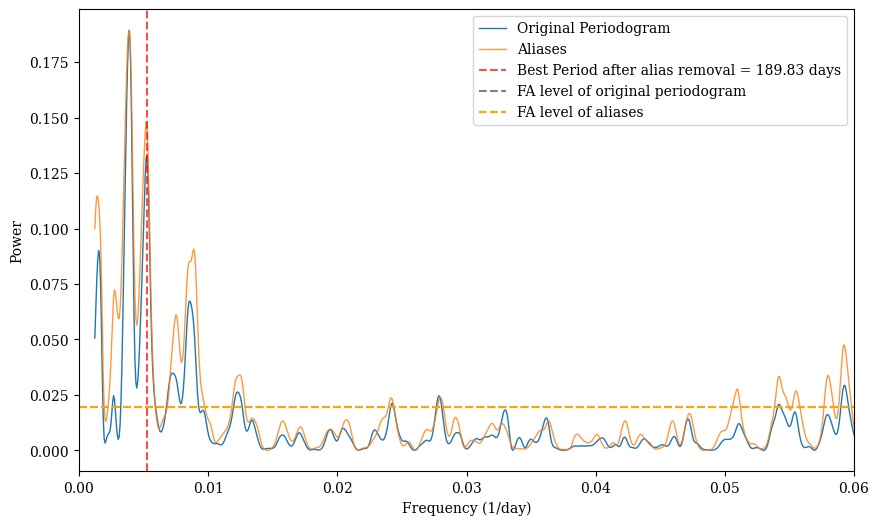

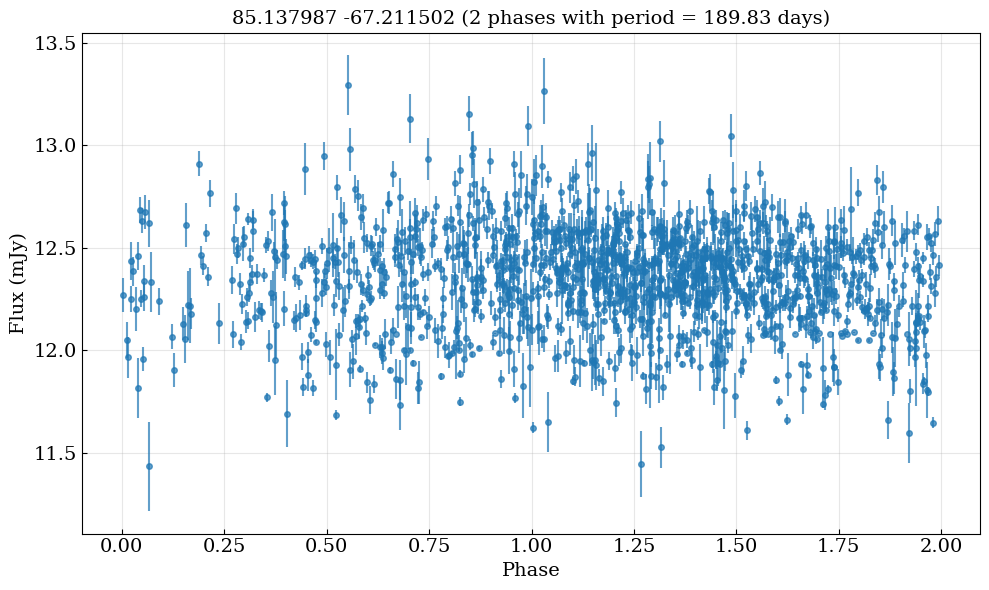

Average scatter (amplitude) per 10 point phase bin: 0.723 mJy
FAL: 0.01954123, Alias FAL: 0.01954123
Alias false alarm probability: 2.872e-59
Best frequency: 0.003896 1/day, Best period: 256.67 days, Max power: 0.189, False alarm probability: 2.872e-59
False alarm level for 1.0%: 1.954e-02


/opt/anaconda3/envs/ysg/lib/python3.13/site-packages/astropy/timeseries/periodograms/lombscargle/implementations/fast_impl.py:134: RuntimeWarning: invalid value encountered in divide
  power /= YY


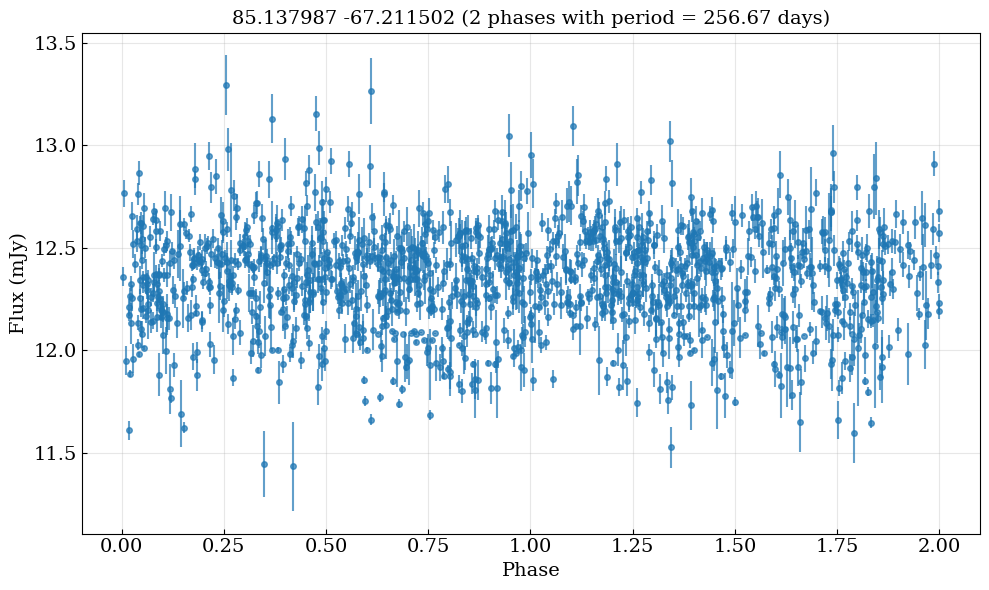

Average scatter (amplitude) per 10 point phase bin: 0.730 mJy


In [16]:
for i in periodchange:
    print(f"Target {i} ")
    # Alias removed
    lombs = compute_lomb_scargle(i, auto=False, median=True, show = True, samples_per_peak=10)
    # plot_periodogram(i, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], show_best=True)
    plot_phase_fold(i, lombs['best_period'], phase_bins=2)
    # No alias removed
    lombs = compute_lomb_scargle(i, auto=False, median=False, samples_per_peak=10)
    # plot_periodogram(i, lombs['frequency'], lombs['power'], lombs['best_frequency'], lombs['false_alarm_level'], show_best=True)
    plot_phase_fold(i, lombs['best_period'], phase_bins=2)

     

In [ ]:
def plot_phase_fold_test(target, phase_bins=2):
    """
    Phase fold time series data using a given period.
    
    Parameters:
    -----------
    time : array-like
        Time values
    period : float
        Period to fold by
    values : array-like or None
        Data values to fold
    errors : array-like or None
        Uncertainties in data values
    phase_bins : float
        Number of phase cycles to show (e.g., 2 shows 0-2 phases)
        
    Returns:
    --------
    dict : Dictionary containing phased data
    """
    df, telescopes = df_extract(target, g=True)
    coords = pd.read_csv('merged_smc_lmc_coords.csv', comment='#',  sep="\\s+", names=['RA', 'DEC'])
    RA = coords['RA'].iloc[target]
    dec = coords['DEC'].iloc[target]
    print(f"Target {target} - RA: {RA}, DEC: {dec}")
    lombs = compute_lomb_scargle(target)
    time = np.array(df['HJD'])  # Time in HJD
    flux = np.array(df['flux_(mJy)'])  # Flux in mJy
    mags = np.array(df['mag'])  # Magnitudes
    errors = np.array(df['flux_err'])  # Flux uncertainties in mJy
    period = lombs['best_period']  # Best period from Lomb-Scargle analysis
    # period = 30.89
    if period > (time.max() - time.min()):
        return None
    # Calculate phase

    phased_time = (time / period) % phase_bins
    
    result = {'phased_time': phased_time}
    
    if flux is not None:
        result['values'] = flux
    if errors is not None:
        result['errors'] = errors

    plt.figure(figsize=(10, 6))
    # Plot by telescope color
    # telescopes_unique = df['telescope'].unique()
    # cmap = plt.get_cmap('tab10')
    colors = ['g', 'b', 'r', 'c', 'm', 'y', 'k']
    # color_map = {tel: cmap(i % 10) for i, tel in enumerate(telescopes_unique)}
    for j, tel in enumerate(telescopes):
        tel_mask = df['telescope'] == tel
        plt.errorbar(phased_time[tel_mask], flux[tel_mask], yerr=errors[tel_mask], fmt='o',
                     alpha=0.7, markersize=4, label=str(tel), color=colors[j % len(colors)])
    plt.legend(title='Telescope')
    plt.xlabel('Phase', fontsize=14)
    plt.ylabel('Flux (mJy)', fontsize=14)
    plt.tick_params(axis='both', which='major', direction ='in', labelsize=14)
    plt.grid(True, alpha=0.3)
    plt.title(f'{RA} {dec} (2 phases with period = {period:.2f} days)', fontsize=14)
    plt.tight_layout()
    # plt.savefig(f'lc_plots/{RA}{dec}_phaseg.png', dpi=300, bbox_inches='tight')
    plt.show()

    # bin and find amplitude of narrow bin
    # Bin the phased data
    num_bins = int(np.ceil(len(phased_time) / 10))  # e.g., ~10 points per bin
    bins = np.linspace(0, phase_bins, num_bins + 1)
    bin_indices = np.digitize(phased_time, bins) - 1

    amplitudes = []
    for i in range(num_bins):
        bin_flux = flux[bin_indices == i]
        if len(bin_flux) > 1:
            amplitude = np.max(bin_flux) - np.min(bin_flux)
            amplitudes.append(amplitude)
    average_amplitude = np.mean(amplitudes)
    print(f"Average scatter (amplitude) per 10 point phase bin: {average_amplitude:.3f} mJy")
    return average_amplitude

# plot_phase_fold_test(284, phase_bins=2)
# plot_phase_fold_test(65, phase_bins=2)

# Trying out removing telescope E through different methods:

In [ ]:
# single_tel_df = data[data['telescope'] == 'E']

# mask17 = (single_tel_df['flux_(mJy)'] > 17) & (single_tel_df['flux_(mJy)'] < 18)
# print(single_tel_df['flux_(mJy)'][mask17])

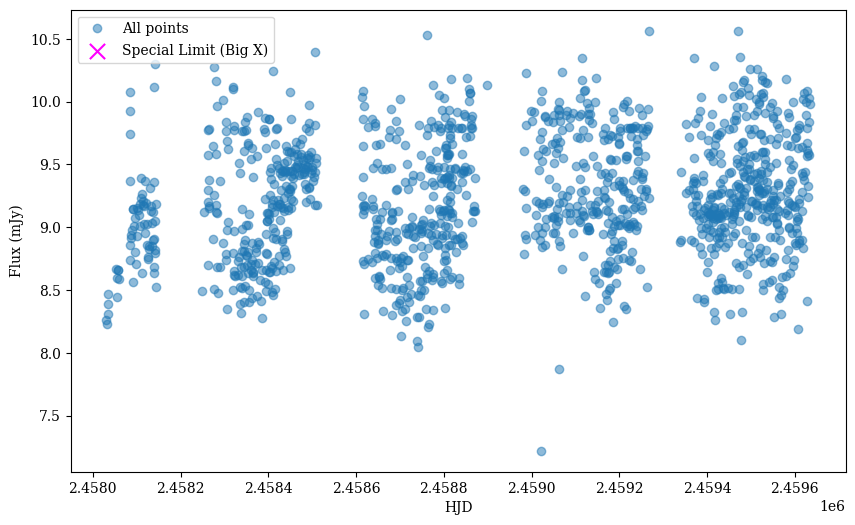

In [ ]:
# Assuming df is your DataFrame
data, telescopes = df_extract(target, g=True)

mask = (data['telescope'] == 'E') & (data['Limit'] < 19.0)
indices = data.index[mask]
for idx in indices:
    print(f"Line {idx}: {data.loc[idx]}")

# Plot big X's for specific Limit values
special_limits = [18.539, 18.373, 18.270]
special_mask = (data['telescope'] == 'E') & (data['Limit'].isin(special_limits))

plt.figure(figsize=(10, 6))
plt.plot(data['HJD'], data['flux_(mJy)'], 'o', alpha=0.5, label='All points')
plt.scatter(data['HJD'][special_mask], data['flux_(mJy)'][special_mask],
            marker='x', s=120, color='magenta', label='Special Limit (Big X)')
plt.xlabel('HJD')
plt.ylabel('Flux (mJy)')
plt.legend()
plt.show()

In [ ]:
def plot_phase_fold_test2(target, phase_bins=2):
    """
    Points with |counts| < 3*count_err are flagged in a different color.
    """
    df, telescopes = df_extract(target, g=True)
    coords = pd.read_csv('merged_smc_lmc_coords.csv', comment='#',  sep="\\s+", names=['RA', 'DEC'])
    RA = coords['RA'].iloc[target]
    dec = coords['DEC'].iloc[target]
    print(f"Target {target} - RA: {RA}, DEC: {dec}")
    lombs = compute_lomb_scargle(target, samples_per_peak=10)  # freq_range=(0.0, 0.05),
    time = np.array(df['HJD'])  # Time in HJD
    flux = np.array(df['flux_(mJy)'])  # Flux in mJy
    mags = np.array(df['mag'])  # Magnitudes
    errors = np.array(df['flux_err'])  # Flux uncertainties in mJy
    period = lombs['best_period']  # Best period from Lomb-Scargle analysis
    # period = 30.89
    if period > (time.max() - time.min()):
        return None
    # Calculate phase

    phased_time = (time / period) % phase_bins
    
    result = {'phased_time': phased_time}
    
    if flux is not None:
        result['values'] = flux
    if errors is not None:
        result['errors'] = errors
    # Assume counts and count_err columns exist in df
    if 'counts' in df.columns and 'count_err' in df.columns:
        counts = np.array(df['counts'])
        count_err = np.array(df['count_err'])
        flag_mask = np.abs(counts) < 3 * count_err
    else:
        # If not present, flag nothing
        flag_mask = np.zeros_like(flux, dtype=bool)
    plt.figure(figsize=(10, 6))
    # Plot flagged points
    plt.errorbar(phased_time[flag_mask], flux[flag_mask], yerr=errors[flag_mask], fmt='o',
                 alpha=0.7, markersize=4, label='Flagged: |counts| < 3*count_err', color='red')
    # Plot normal points
    plt.errorbar(phased_time[~flag_mask], flux[~flag_mask], yerr=errors[~flag_mask], fmt='o',
                 alpha=0.7, markersize=4, label='Normal', color='blue')
        
        # Plot big X's for specific Limit values
        # Ensure special_mask is the same length and index as the current df
        # If 'Limit' and 'telescope' columns exist in df, create mask for this df
    # if 'Limit' in df.columns and 'telescope' in df.columns:
    #     special_limits = [18.539, 18.373, 18.270]
    #     special_mask = (df['telescope'] == 'E') & (df['Limit'].isin(special_limits))
    #     plt.errorbar(phased_time[special_mask], flux[special_mask], yerr=errors[special_mask], fmt='x',
    #                     markersize=10, label='Special Limit (Big X)', color='magenta', alpha=0.7)


    plt.legend(title='Flag')
    plt.xlabel('Phase', fontsize=14)
    plt.ylabel('Flux (mJy)', fontsize=14)
    plt.tick_params(axis='both', which='major', direction ='in', labelsize=14)
    plt.grid(True, alpha=0.3)
    plt.title(f'{RA} {dec} (2 phases with period = {period:.2f} days)', fontsize=14)
    plt.tight_layout()
    plt.show()

    # bin and find amplitude of narrow bin
    # Bin the phased data
    num_bins = int(np.ceil(len(phased_time) / 10))  # e.g., ~10 points per bin
    bins = np.linspace(0, phase_bins, num_bins + 1)
    bin_indices = np.digitize(phased_time, bins) - 1

    amplitudes = []
    for i in range(num_bins):
        bin_flux = flux[bin_indices == i]
        if len(bin_flux) > 1:
            amplitude = np.max(bin_flux) - np.min(bin_flux)
            amplitudes.append(amplitude)
    average_amplitude = np.mean(amplitudes)
    print(f"Average scatter (amplitude) per 10 point phase bin: {average_amplitude:.3f} mJy")
    return average_amplitude

# plot_phase_fold_test2(284, phase_bins=2)

In [ ]:
def plot_phase_fold_test3(target, phase_bins=2):
    """
    Points with Limit > 18.25 are flagged in a different color.
    """
    df, telescopes = df_extract(target, g=True)
    coords = pd.read_csv('merged_smc_lmc_coords.csv', comment='#',  sep="\\s+", names=['RA', 'DEC'])
    RA = coords['RA'].iloc[target]
    dec = coords['DEC'].iloc[target]
    print(f"Target {target} - RA: {RA}, DEC: {dec}")
    lombs = compute_lomb_scargle(target, samples_per_peak=10)  # freq_range=(0.0, 0.05),
    time = np.array(df['HJD'])  # Time in HJD
    flux = np.array(df['flux_(mJy)'])  # Flux in mJy
    mags = np.array(df['mag'])  # Magnitudes
    errors = np.array(df['flux_err'])  # Flux uncertainties in mJy
    period = lombs['best_period']  # Best period from Lomb-Scargle analysis
    # period = 30.89
    if period > (time.max() - time.min()):
        return None
    # Calculate phase

    phased_time = (time / period) % phase_bins
    
    result = {'phased_time': phased_time}
    
    if flux is not None:
        result['values'] = flux
    if errors is not None:
        result['errors'] = errors
    
    limits = np.array(df['Limit'])
    flag_mask = limits >19.0 
    flag_mask = limits > 18.25

    plt.figure(figsize=(10, 6))
    # Plot normal points
    plt.errorbar(phased_time[~flag_mask], flux[~flag_mask], yerr=errors[~flag_mask], fmt='o',
                 alpha=0.7, markersize=4, label='Normal', color='blue')

    plt.errorbar(phased_time[flag_mask], flux[flag_mask], yerr=errors[flag_mask], fmt='o',
                 alpha=0.7, markersize=4, label='Flagged: Limit > 18.25', color='red')

                
    
    # if 'Limit' in df.columns and 'telescope' in df.columns:
    #     special_limits = [18.539, 18.373, 18.270]
    #     special_mask = (df['telescope'] == 'E') & (df['Limit'].isin(special_limits))
    #     plt.errorbar(phased_time[special_mask], flux[special_mask], yerr=errors[special_mask], fmt='x',
    #                     markersize=10, label='Special Limit (Big X)', color='magenta', alpha=0.7)
    

    plt.legend(title='Flag')
    plt.xlabel('Phase', fontsize=14)
    plt.ylabel('Flux (mJy)', fontsize=14)
    plt.tick_params(axis='both', which='major', direction ='in', labelsize=14)
    plt.grid(True, alpha=0.3)
    plt.title(f'{RA} {dec} (2 phases with period = {period:.2f} days)', fontsize=14)
    plt.tight_layout()
    plt.show()

    # bin and find amplitude of narrow bin
    # Bin the phased data
    num_bins = int(np.ceil(len(phased_time) / 10))  # e.g., ~10 points per bin
    bins = np.linspace(0, phase_bins, num_bins + 1)
    bin_indices = np.digitize(phased_time, bins) - 1

    amplitudes = []
    for i in range(num_bins):
        bin_flux = flux[bin_indices == i]
        if len(bin_flux) > 1:
            amplitude = np.max(bin_flux) - np.min(bin_flux)
            amplitudes.append(amplitude)
    average_amplitude = np.mean(amplitudes)
    print(f"Average scatter (amplitude) per 10 point phase bin: {average_amplitude:.3f} mJy")
    return average_amplitude

# plot_phase_fold_test3(284, phase_bins=2)
# plot_phase_fold_test(65, phase_bins=2)

In [ ]:
def ls_exclude_teleE(index, auto=False, samples_per_peak=10, report = True, subtract_median=True):
    df, telescopes = df_extract(index, g=True)
    # Exclude data from telescope 'E'
    df_noE = df[df['telescope'] != 'E']
    time = np.array(df_noE['HJD'])  # Time in HJD
    values = np.array(df_noE['flux_(mJy)'])  # Flux in mJy
    errors = np.array(df_noE['flux_err'])  # Flux uncertainties in mJy
    if subtract_median:
        values -= np.median(values)

    # time = time * u.day
    # values = values * u.milliJansky
    # errors = errors * u.milliJansky
    
    # Create Lomb-Scargle object
    ls = LombScargle(time, values, dy=errors)
    peaks = []
    peak_powers = []
    min_freq = 2.0 / (time.max() - time.min())  # Minimum frequency based on time range
    max_freq = 0.9
    # Calculate periodogram
    if auto is not True:
        # frequency = np.linspace(freq_range[0], freq_range[1], 
                            #   int((freq_range[1] - freq_range[0]) * len(time) * samples_per_peak)) 
        frequency = np.linspace(min_freq, max_freq, 
                              int((max_freq - min_freq) * len(time) * samples_per_peak))
        power = ls.power(frequency)
    else:
        frequency, power = ls.autopower()#(samples_per_peak=samples_per_peak)
    # Find best period
    best_freq = frequency[np.argmax(power)] 
    best_period = 1.0 / best_freq
    max_power = np.max(power)
    # Calculate false alarm probability for the highest peak
    alarm = ls.false_alarm_probability(max_power)
    probabilities = 0.01
    alarm_level = ls.false_alarm_level(probabilities)

    if best_period > (time.max() - time.min()):
        print(f"Warning: Best period {best_period:.2f} days exceeds the time range of the data ({time.max() - time.min():.2f} days).")
    for i in range(len(power) - 1):
        if power[i] > alarm_level and power[i] > power[i-1] and power[i] > power[i+1]:
            if power[i] == max_power:  
                continue # Skip the maximum power peak
            peaks.append(frequency[i])
            peak_powers.append(power[i])

    if report:
        print(f"Best frequency: {best_freq:.6f} 1/day, Best period: {best_period:.2f} days, Max power: {max_power:.3f}, False alarm probability: {alarm:.3e}")
        # print(f"False alarm levels: {', '.join([f'{p*100:.1f}%: {level:.3e}' for p, level in zip(probabilities, alarm_level)])}")
        print(f"False alarm level for {probabilities*100:.1f}%: {alarm_level:.3e}")
    alarm_level_flag = 0
    if max_power < alarm_level:
        alarm_level_flag = 1
    return

# print('Excluding Telescope E:')
# ls_exclude_teleE(284, auto=False, samples_per_peak=5, report=True, subtract_median=True)
# print('\nIncluding Telescope E:')
# compute_lomb_scargle(284, auto=False, samples_per_peak=5, report=True, subtract_median=True)

In [ ]:
compute_lomb_scargle(target)
aliasing(target)[2]

FAL: 0.02102761, Alias FAL: 0.02102761


ValueError: zero-size array to reduction operation maximum which has no identity

# Amplitude per period

In [ ]:
def amplitude_per_period(target, report=True, g=True):
    df, telescopes = df_extract(target, g=g)
    lombs = compute_lomb_scargle(target, samples_per_peak=5, report = False)  # freq_range=(0.0, 0.05),
    period = lombs['best_period']
    if period > (df['HJD'].max() - df['HJD'].min()):
        return None
    print(f"Best period found: {period:.2f} days")
    
    # Get time and flux data
    time = np.array(df['HJD'])
    flux = np.array(df['flux_(mJy)'])
    
    # Create period bins (each data point gets assigned to a period number)
    period_bins = np.floor(time / period).astype(int)
    
    # Get unique period bins
    unique_periods = np.unique(period_bins)
    
    # Initialize lists to store results
    amplitudes, period_numbers, bin_centers, bin_counts = [], [], [], []
    if report:
        print(f"Found {len(unique_periods)} period bins with period = {period:.2f} days")
    
    # Calculate amplitude for each period bin
    for period_num in unique_periods:
        # Get data points in this period bin
        mask = period_bins == period_num
        bin_flux = flux[mask]
        bin_time = time[mask]
        
        # # Skip bins with too few data points
        # # here is a threshold of 0.5 times the average number of points per period
        if len(bin_flux) < 0.66*(len(df) / len(unique_periods)):
            if report:
                print(f"Skipping period {period_num} with {len(bin_flux)} points (too few data points)")
            continue
            

        for i in range(1, len(bin_time)):
            if bin_time[i] - bin_time[i-1] > 0.33 * period:
                if report:
                    print(f"Skipping period {period_num} with {len(bin_flux)} points (gap in time > 0.33 * period)")
                continue
        # Calculate amplitude (max - min) for this bin
        amplitude = np.max(bin_flux) - np.min(bin_flux)
        
        # Store results
        amplitudes.append(amplitude)
        period_numbers.append(period_num)
        bin_centers.append(np.mean(bin_time))  # Center time of the bin
        bin_counts.append(len(bin_flux))  # Number of data points in bin
        if report:
            print(f"Period {period_num}: {len(bin_flux)} points, amplitude = {amplitude:.3f} mJy")
    
    # Convert to numpy arrays for easier handling
    amplitudes = np.array(amplitudes)
    avg_amplitude = np.mean(amplitudes)
    std_amplitude = np.std(amplitudes)
    print(f"Average amplitude across all periods: {avg_amplitude:.3f} mJy")
    print(f"Standard deviation of amplitudes: {std_amplitude:.3f} mJy")

    if avg_amplitude < 5* std_amplitude:
        print(f"Warning: average amplitude ({avg_amplitude:.3f} mJy) is less than 5 sigma ({std_amplitude:.3f} mJy). This indicates significant variability in the amplitudes across periods.")
    else:
        print(f"Average amplitude ({avg_amplitude:.3f} mJy) is greater than 5 sigma ({std_amplitude:.3f} mJy). This indicates consistent variability across periods.")
    period_numbers = np.array(period_numbers)
    bin_centers = np.array(bin_centers)
    bin_counts = np.array(bin_counts)
    
    # Return the results as a dictionary
    return {
        'amplitudes': amplitudes,
        'period_numbers': period_numbers,
        'bin_centers': bin_centers,
        'bin_counts': bin_counts,
        'period': period,
        'mean_amplitude': np.mean(amplitudes),
        'std_amplitude': np.std(amplitudes)
    }

In [ ]:
def amplitude_per_period_plot(target, result):
    df, telescopes = df_extract(target, g=True)
    # days_since_start = df['HJD'] - df['HJD'].min()
    plt.figure(figsize=(20, 6))
    plt.xlabel('Time (HJD)', fontdict={'fontsize': 18})
    plt.ylabel('Flux (mJy)', fontdict={'fontsize': 18})
    plt.plot(df['HJD'], df['flux_(mJy)'], '-')
    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)
    # ticks going inward
    plt.tick_params(axis='both', which='major', labelsize=18, direction='in')

    bin_centers = result['bin_centers']
    amplitudes = result['amplitudes']
    fig = plt.figure(figsize=(12, 6))
    gs = gridspec.GridSpec(1, 2, width_ratios=[4, 1], wspace=0.05)

    # Amplitude vs. Time plot
    ax0 = plt.subplot(gs[0])
    ax0.plot(bin_centers, amplitudes, 'o', markersize=6)
    ax0.set_xlabel('Time (HJD)', fontdict={'fontsize': 14})
    ax0.set_ylabel('Amplitude (mJy)', fontdict={'fontsize': 14})
    ax0.grid(True, alpha=0.3)
    # ax0.set_ylim(4.2, 8.2) 
    ax0.tick_params(axis='both', which='major', labelsize=14, direction='in')

    # Histogram, sharing y-axis with amplitude plot
    ax1 = plt.subplot(gs[1], sharey=ax0)
    ax1.hist(amplitudes, bins=5, orientation='horizontal', alpha=0.7, edgecolor='black')
    ax1.set_xlabel('Number of Periods', fontdict={'fontsize': 14})
    ax1.grid(True, alpha=0.3)
    plt.setp(ax1.get_yticklabels(), visible=False)
    plt.show()

In [ ]:
# Test the amplitude_per_period function
result = amplitude_per_period(target, report = False)
# print(result['amplitudes'])
### should i include numpy percentiile in this?

FAL: 0.02102761, Alias FAL: 0.02102761
Best period found: 340.79 days
Average amplitude across all periods: 2.483 mJy
Standard deviation of amplitudes: 0.362 mJy
Average amplitude (2.483 mJy) is greater than 5 sigma (0.362 mJy). This indicates consistent variability across periods.


In [ ]:
# std dev of amplitudes of regular variability 0.415 mJy
# std dev of amplitudes of irregular variability 1.167 mJy

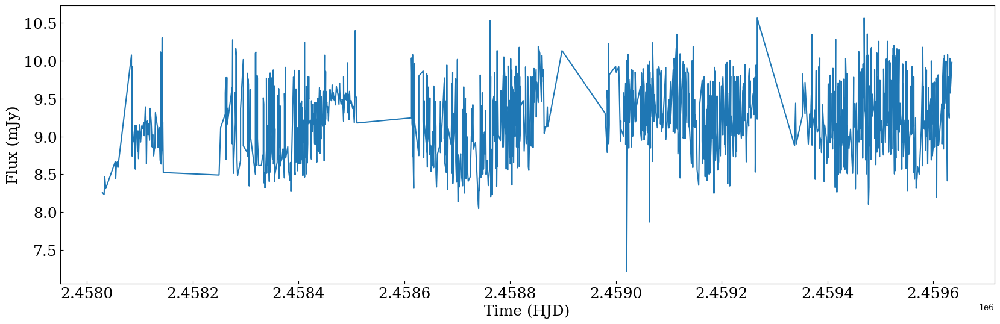

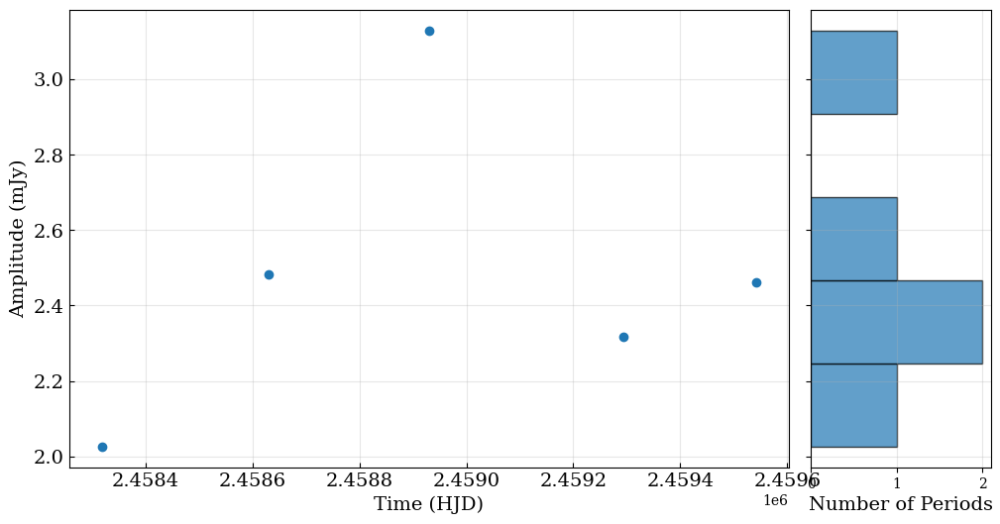

In [ ]:
amplitude_per_period_plot(target, result)

FAL: 0.02102761, Alias FAL: 0.02102761
Best frequency: 0.002934 1/day, Best period: 340.79 days, Max power: 0.014, False alarm probability: 4.952e-01
False alarm level for 1.0%: 2.103e-02


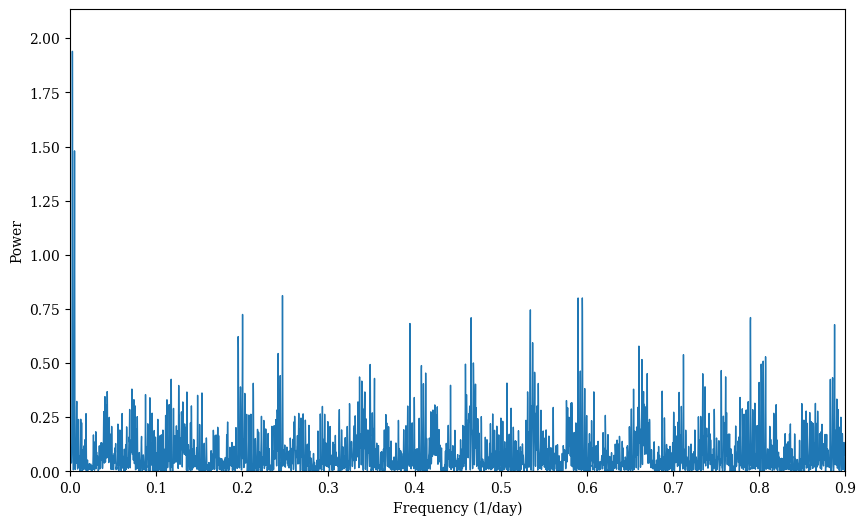

(array([   9,   25,   42,   55,   72,  112,  255,  272,  288,  306,  353,
         385,  419,  442,  459,  474,  499,  562,  579,  595,  612,  655,
         714,  724,  741,  756,  774,  796,  813,  834,  844,  858,  875,
         909,  956,  971,  989, 1108, 1183, 1246, 1263, 1280, 1296, 1313,
        1327, 1344, 1359, 1377, 1439, 1457, 1471, 1518, 1535, 1548, 1565,
        1581, 1598, 1690, 1721, 1738, 1754, 1771, 1798, 1884, 1900, 1917,
        1941, 1958, 2028, 2088, 2105, 2148, 2169, 2181, 2198, 2221, 2261,
        2278, 2294, 2380, 2401, 2475, 2532, 2545, 2562, 2579, 2595, 2632,
        2649, 2664, 2681, 2720, 2736, 2750, 2769, 2852, 2869, 2962, 2972,
        2982, 3005, 3015, 3025, 3042, 3058, 3075, 3102, 3171, 3188, 3219,
        3250, 3264, 3296, 3327, 3344, 3440, 3452, 3473, 3490, 3505, 3523,
        3533, 3553, 3646, 3746, 3765, 3786, 3817, 3834, 3851, 3866, 3884,
        3899, 3936, 3953, 4040, 4222, 4237, 4253, 4277, 4294, 4317, 4329,
        4343, 4357, 4374, 4470, 4487, 

In [ ]:
compute_lomb_scargle(target)
aliasing(target)[2]

# Comparing nearby targets lightcurves

In [ ]:
# Read the CSV file with light curve data
csv_file = '661446200650-light-curves.csv'
data = pd.read_csv(csv_file, comment='#')

Loaded 1248 points from sub2/J12.419711-73.236916_g.dat


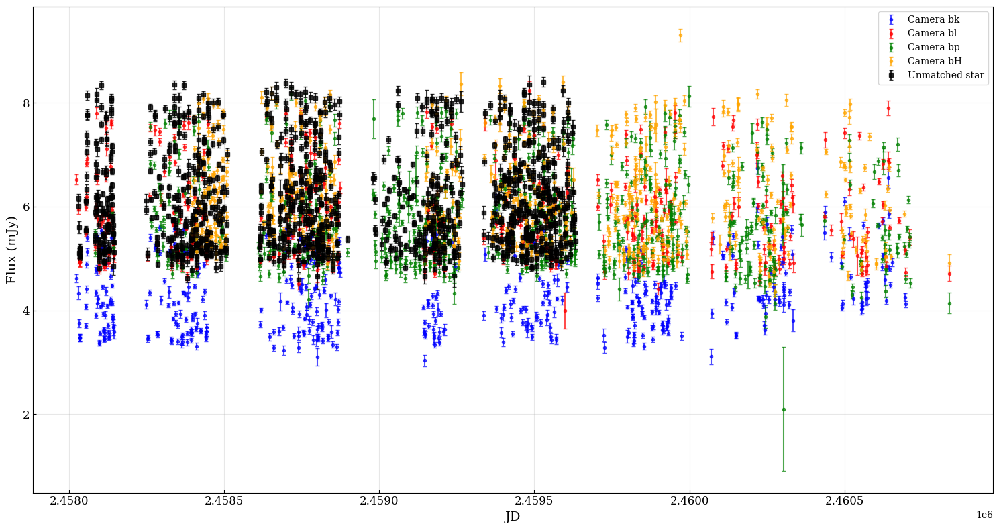

In [ ]:
# Filter for g-band data only
g_data = data[data['Filter'] == 'g'].copy()

# Read additional data from sub2 directory
sub2_file = 'sub2/J12.419711-73.236916_g.dat'
try:
    # Read the sub2 data, skipping header lines and handling the format
    sub2_data = pd.read_csv(sub2_file, comment='#', sep=r'\s+', skiprows=6, 
                           names=['JD', 'HJD', 'UT_date', 'IMAGE', 'FWHM', 'Diff', 'Limit', 
                                  'mag', 'mag_err', 'counts', 'count_err', 'flux_mJy', 'flux_err'])
    print(f"Loaded {len(sub2_data)} points from {sub2_file}")
    sub2_available = True
except Exception as e:
    print(f"Could not load {sub2_file}: {e}")
    sub2_available = False

# Plot the flux time series (g-band only, color coded by camera)
plt.figure(figsize=(15, 8))

# Color map for different cameras
cameras = g_data['Camera'].unique()
colors = ['blue', 'red', 'green', 'orange', 'purple', 'brown']
camera_colors = {cam: colors[i % len(colors)] for i, cam in enumerate(cameras)}

# Plot each camera separately
for camera in cameras:
    camera_data = g_data[g_data['Camera'] == camera]
    plt.errorbar(camera_data['JD'], camera_data['Flux'], yerr=camera_data['Flux Error'], 
                 fmt='o', alpha=0.7, markersize=3, capsize=2, 
                 color=camera_colors[camera], label=f'Camera {camera}')

# Plot sub2 data if available

plt.errorbar(sub2_data['JD'], sub2_data['flux_mJy'], yerr=sub2_data['flux_err'], 
                fmt='s', alpha=0.8, markersize=4, capsize=2, 
                color='black', label='Unmatched star')

plt.xlabel('JD', fontsize=14)
plt.ylabel('Flux (mJy)', fontsize=14)
plt.legend()
plt.grid(True, alpha=0.3)
plt.tick_params(axis='both', which='major', labelsize=12, direction='in')
plt.tight_layout()
plt.show()

(0.0, 2.0)

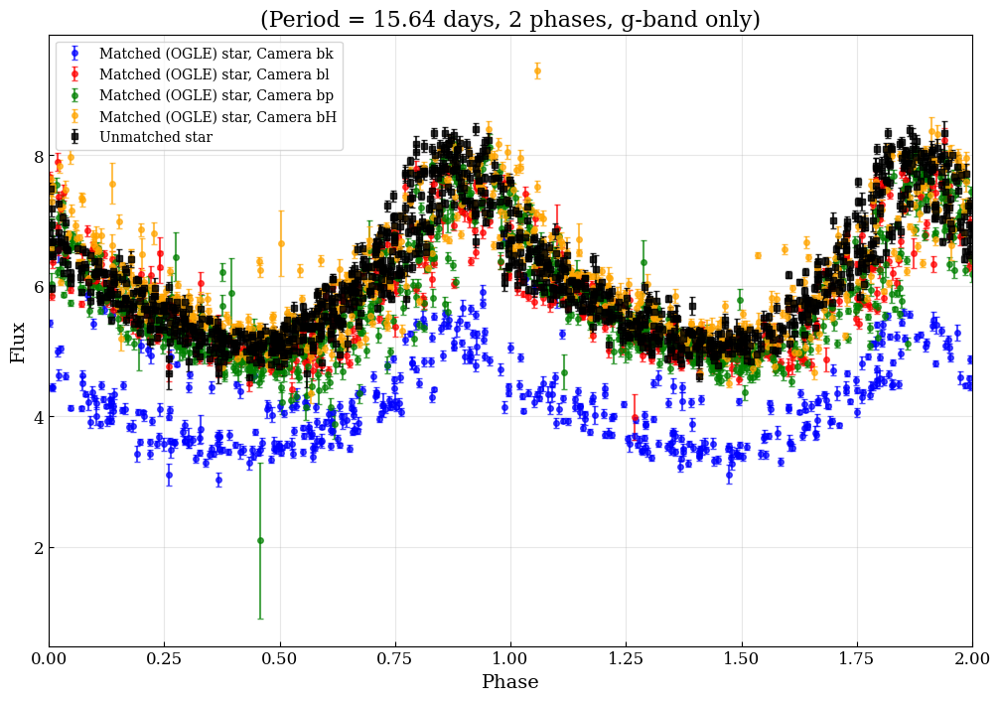

In [ ]:
# Phase fold the g-band data with a period of 15.64 days
period = 15.64  # days
phase_bins = 2  # Show 2 complete phase cycles

# Use g-band data only
time = g_data['JD'].values
flux = g_data['Flux'].values
flux_err = g_data['Flux Error'].values
cameras_phased = g_data['Camera'].values

# Phase fold the time data
phased_time = (time / period) % phase_bins

# Phase fold sub2 data if available
if sub2_available:
    sub2_time = sub2_data['HJD'].values
    sub2_flux = sub2_data['flux_mJy'].values
    sub2_flux_err = sub2_data['flux_err'].values
    sub2_phased_time = (sub2_time / period) % phase_bins

# Create the phase-folded plot
plt.figure(figsize=(12, 8))

# Plot the phase-folded data with error bars, color coded by camera
for camera in cameras:
    camera_mask = cameras_phased == camera
    if np.any(camera_mask):
        plt.errorbar(phased_time[camera_mask], flux[camera_mask], yerr=flux_err[camera_mask], 
                     fmt='o', alpha=0.7, markersize=4, capsize=2, 
                     color=camera_colors[camera], label=f'Matched (OGLE) star, Camera {camera}')

# Plot sub2 data if available
if sub2_available:
    plt.errorbar(sub2_phased_time, sub2_flux, yerr=sub2_flux_err, 
                 fmt='s', alpha=0.8, markersize=5, capsize=2, 
                 color='black', label='Unmatched star')

plt.xlabel('Phase', fontsize=14)
plt.ylabel('Flux', fontsize=14)
plt.title(f'(Period = {period} days, 2 phases, g-band only)', fontsize=16)
plt.legend()
plt.grid(True, alpha=0.3)
plt.tick_params(axis='both', which='major', labelsize=12, direction='in')

# Set x-axis to show 2 complete phases (0 to 2)
plt.xlim(0, 2)
